### Reverse Correlation Audio

In [44]:
import re, sys
import nilearn
from nilearn import plotting, input_data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
from pieman_utils import *
import seaborn as sns
from nilearn.image import new_img_like
from scipy.io.wavfile import write
import IPython

from IPython.display import Audio
from scipy.io import wavfile

from scipy.stats import zscore
import warnings
warnings.filterwarnings("ignore")

### load audio and text

In [46]:
pie_text = pd.read_csv('../data_pieman/pieman_align.csv',
                       header = None, 
                       names  = ['text', 'emb_dict', 'onset_time', 'offset_time'],
                       encoding = "utf-8")

tr_shift = 3
tr = 1.5

pie_text['tr'] = divmod(pie_text['onset_time'].values, tr)[0] + tr_shift
#pie_text
print(pie_text.head())


sound_file = '../data_pieman/pieman.wav'
samplerate, sounddata = wavfile.read(sound_file)
#print(data.shape[0]/samplerate)
print(samplerate)

#Audio(sound_file,)

          text emb_dict  onset_time  offset_time    tr
0            I        i   15.089999    15.169999  13.0
1        began    began   15.170000    15.510000  13.0
2           my       my   15.509999    15.699999  13.0
3  illustrious    <unk>   15.710000    16.310000  13.0
4       career   career   16.330000    16.940000  13.0
8000


### load fMRI data

In [47]:
fmri_data = np.load('../data_pieman/fmri_data_pieman.npy')
print(fmri_data.shape)

data = fmri_data.copy()
data = np.swapaxes(data, 0,1)
data = np.swapaxes(data, 1,2)
print(data.shape)

shen_pauli_aan_file       = '../data_pieman/allcombined.nii'
shen_pauli_aan_masker = nilearn.input_data.NiftiLabelsMasker(labels_img=shen_pauli_aan_file);
sample_file = '../data_pieman/func.nii'
shen_pauli_aan_masker.fit_transform(sample_file);

(68, 300, 293)
(300, 293, 68)


### Focus on [REGION] : Where are peaks and troughs?

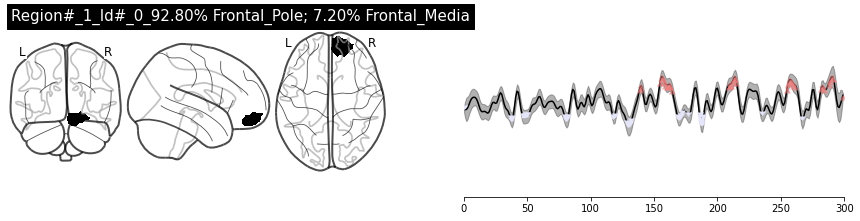


Text corresponding to peaks: And - that’s - how - the - first - line - got - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - Yes - Angela - I - am - Pie - Man - and - tell - me - all - about - it

Text corresponding to troughs: wouldn’t - that - be - a - betrayal - of - its - mission - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - 

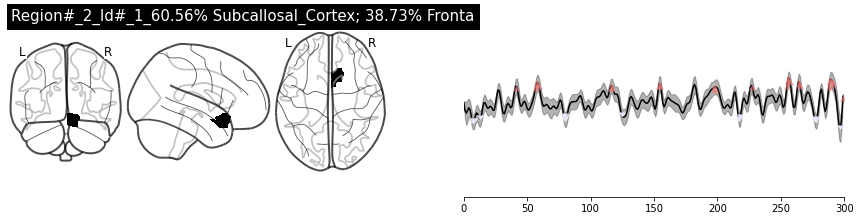


Text corresponding to peaks: and - he - says - So - I - give - him - a - moment - him - a - catchphrase - in - Latin - So - I - was - from - behind - the - late - night - library - drop - box - Angela - from - my - Brit - are - you - Pie - Man - And - And - wasn’t - I - really - Pie - Man - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - that - guy’s - a - dick - Write - it - up - So - I’m - banging - not - an - animal - People - started - dressing - like - him - and - quoting - him - in - class - Man - As - far - as - I - knew - I - had - never - seen - the - guy


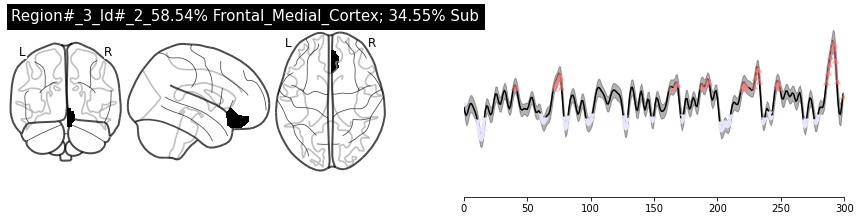


Text corresponding to peaks: and - looks - at - me - and - he - says - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - and - all - the - other - Fordham - Sheila - was - well - bred - Sheila - had - school - beer - at - barbecues - rule - That’s - right - boo - that - rule - in - public - was - in - poor - taste - I - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - Or - I - had - been - flirting - with - her - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Te

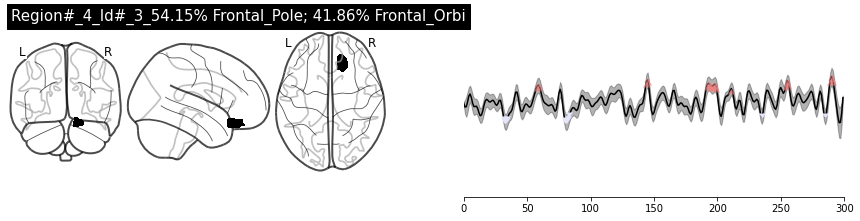


Text corresponding to peaks: give - him - a - moment - It - says - Dear - Jim - good - story - Nice - poor - taste - I - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - flowing - behind - him - And - we - were - wondering - are - you - Pie - Man - about - it

Text corresponding to troughs: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - such - nuance - that


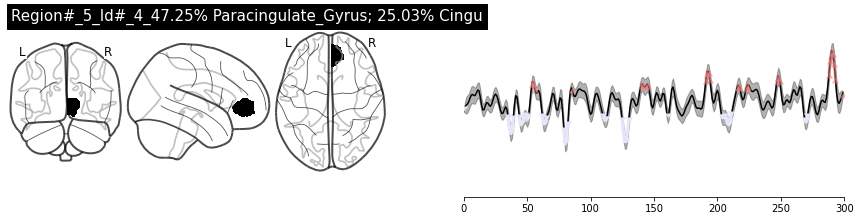


Text corresponding to peaks: And - the - Dean - is - covered - with - cream - the - first - line - got - crossed - It - says - Dear - Jim - good - story - Nice - in - public - was - in - poor - taste - I - think - you - know - what - happened - on - campus - People - started - dressing - like - him - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - And - she - said - Jim - we - were - just - talking - about - and - tell - me - all - about - it

Text corresponding to troughs: substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - the - Dean - says - Yes - I - would - care - to - comment - that - guy’s - a - dick - Write - it - up 

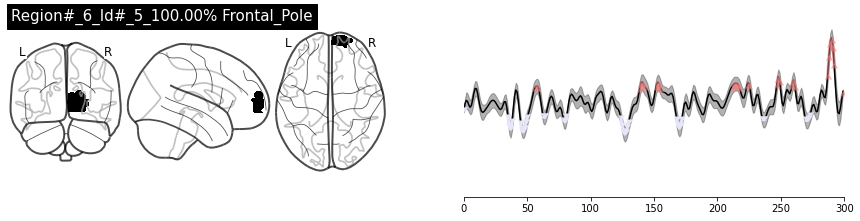


Text corresponding to peaks: So - I - give - him - a - moment - And - that’s - how - the - first - line - got - crossed - A - few - days - later - signed - Pie - Man - So - I - was - doing - this - And - that’s - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - one - night - and - I - saw - I - came - and - I - saw - in - the - And - she - said - Jim - we - were - just - talking - about - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - the - Dean - says - Yes - that - guy’s - a - dick - Write - it - up - So

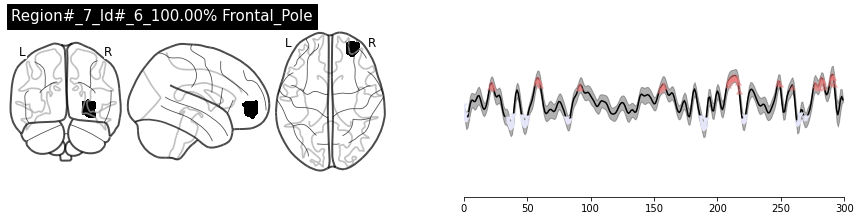


Text corresponding to peaks: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - So - I - give - him - a - moment - and - then - I - say - Dean - McGowan - would - you - care - up - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - she - said - Jim - we - were - just - talking - about - knew - by - the - way - she - said - it - I - Man - As - far - as - I - knew - I - had - never - seen - the - guy - So - I - looked - at - her - and - I - said - Yes - Angela - I - am - Pie - Man - about - it

Text corresponding to troughs: substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stop

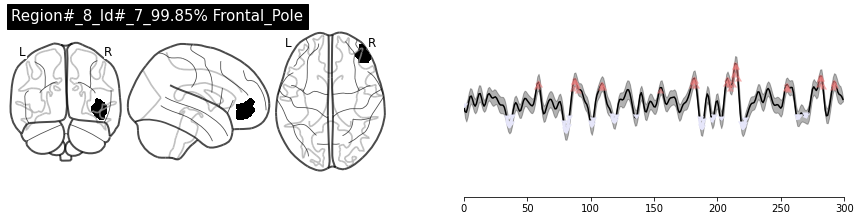


Text corresponding to peaks: give - him - a - moment - by - adding - an - element - of - embellishment - Reporters - call - this - making - shit - avenger - Though - in - fact - he’d - been - capeless - So - I - was - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - we - were - wondering - are - you - Pie - Man - So - I - looked - at - her - and - I - said - Yes - Angela

Text corresponding to troughs: University - plans - to - raise - tuition - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - that - guy’s - a - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - and - I - kind - of 

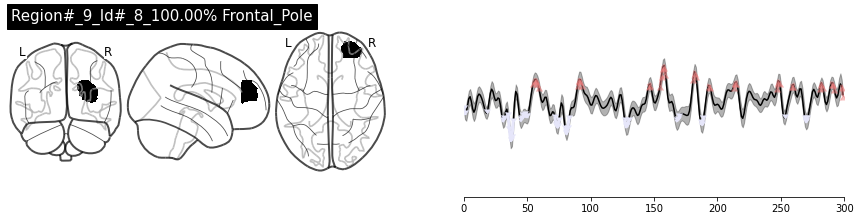


Text corresponding to peaks: is - covered - with - cream - So - I - give - him - a - moment - making - shit - up - And - they - recommend - details - If - you - want - to - see - me - again - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - I - think - you - know - what - happened - And - that’s - what - made - him - a - sensation - And - she - said - Jim - we - were - just - talking - about - knew - by - the - way - she - said - it - I - knew - that - said - Yes - Angela

Text corresponding to troughs: the - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - this - figure - holding - a - cream - pie - which - becomes - the - guy - stand

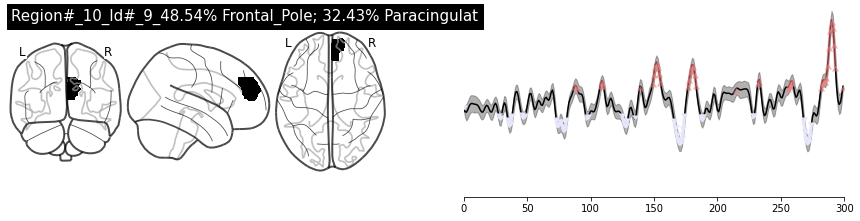


Text corresponding to peaks: embellishment - Reporters - call - this - avenger - Though - in - fact - he’d - been - capeless - And - that’s - how - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - what - made - him - a - sensation - Or - I - had - been - flirting - with - her - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - Yes - Angela - I - am - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: students - with - wealthier - more - prestigious - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - holding - a - cream - pie - which - 

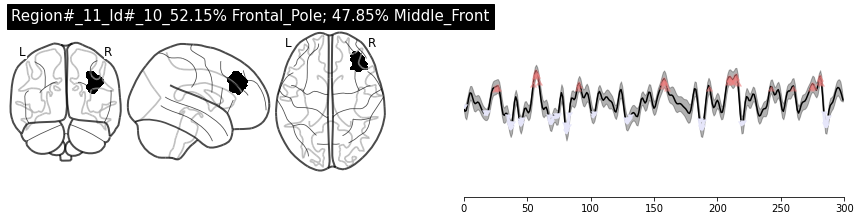


Text corresponding to peaks: policy - to - replace - Fordham’s - traditionally - working - to - middle - class - is - covered - with - cream - So - I - give - him - a - moment - making - shit - up - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - I - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - then - I - went - to - the - bar - knew - that - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - So - I - looked - at - her - and - I - said - Yes

Text corresponding to troughs: reporter - for - the - Ram - the - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream -

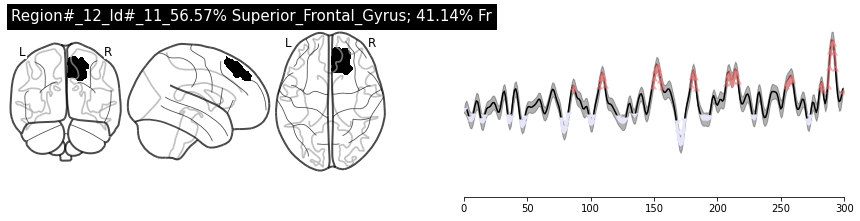


Text corresponding to peaks: by - adding - an - element - of - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - said - Yes - Angela - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled 

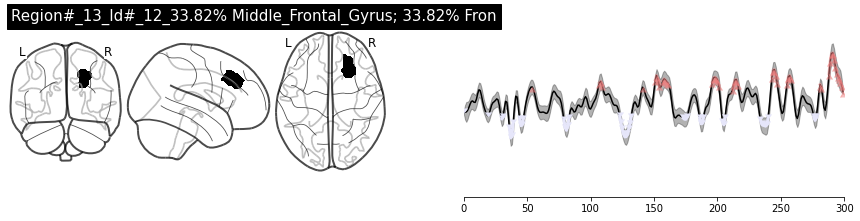


Text corresponding to peaks: And - the - Dean - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - crossed - at - 3 - o’clock - signed - Pie - Man - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - doing - this - And - that’s - what - made - him - a - sensation - on - campus - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - are - you - Pie - Man - And - I - said - Yes - and - tell - me - all - about - it

Text corresponding to troughs: student - newspaper - at - Fordham - ones - So - I - whip - out - my - notebook - and - I - go - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - in - the - corner - of - my - eye - which - bec

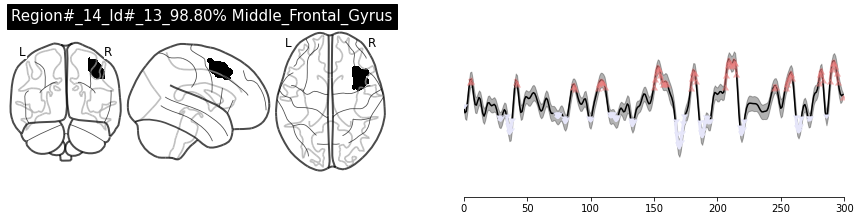


Text corresponding to peaks: and - he - says - Listen - up - punk - And - by - adding - an - element - of - embellishment - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - a - tap - on - my - shoulder - And - it - was - her - And - we - were - wondering - are - you - Pie

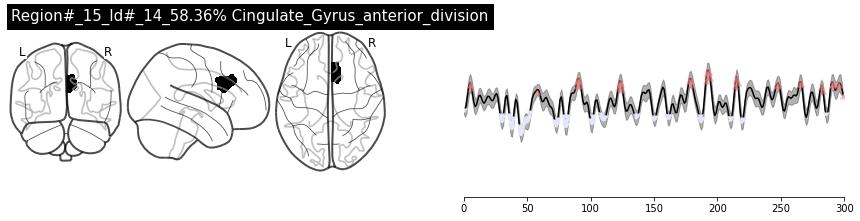


Text corresponding to peaks: give - him - a - moment - Reporters - call - this - making - shit - up - non - an - bestia - which - means - I - am - not - an - animal - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - in - public - was - in - poor - taste - I - think - you - know - what - happened - And - that’s - what - made - him - a - sensation - on - campus - And - she - said - I - really - Pie - Man - Yes - Angela

Text corresponding to troughs: wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - and - he - will - go - on - to - win - a - Pulitze

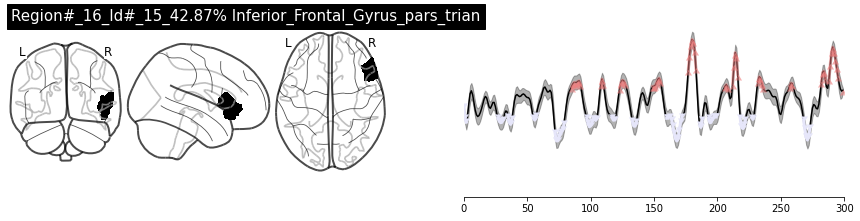


Text corresponding to peaks: by - adding - an - element - of - embellishment - Reporters - call - this - making - shit - up - avenger - Though - in - fact - he’d - been - capeless - which - means - I - am - not - an - animal - Which - makes - no - sense - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - doing - this - And - that’s - what - made - him - a - sensation - on - campus - Or - I - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she - And - I - knew - by - the - way - she - said - it - I - Yes - Angela - I - am - Pie - Man - a

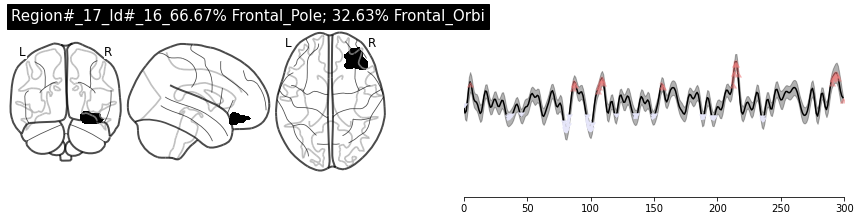


Text corresponding to peaks: by - adding - an - element - of - embellishment - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - there - with - a - photographer - from - the - Ram - doing - this - And - that’s - what - made - him - a - sensation - on - campus

Text corresponding to troughs: substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - that - guy’s - a - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - kind - of - liked - it - I - said - that - he - cried - out - and - he - says - Pie - Man - be - on - the - steps - of - Duane - Library - Tuesday - right - boo - that - rule - Pie - Man - emerged - from - behind - the - such - nuance - that - th

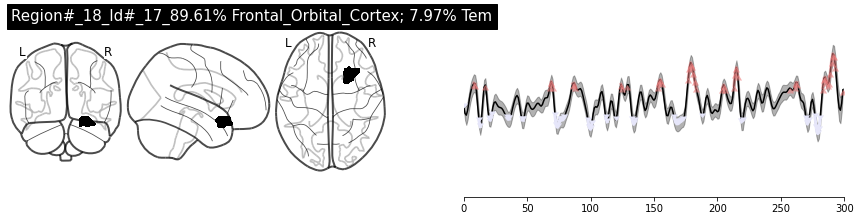


Text corresponding to peaks: reporter - for - the - Ram - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - by - adding - an - element - of - embellishment - which - means - I - am - not - an - animal - I - needed - something - Pie - Man - So - I - was - there - with - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Or - at - least - that’s - what - it - said - in - my - story - in - the - And - that’s - what - made - him - a - sensation - on - campus - And - if - I - said - yes - she - would - have - sex - with - me - Angela - I - am - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - University - And - one - day - I’m - walking - toward - the - campus 

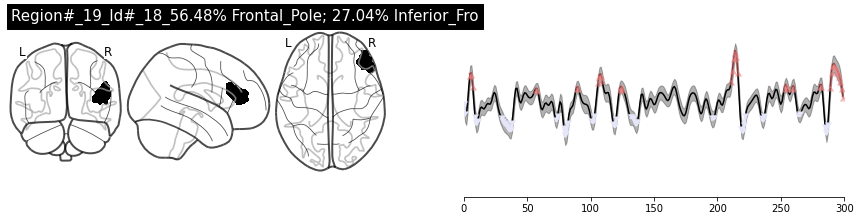


Text corresponding to peaks: So - I - give - him - a - moment - Reporters - call - this - making - shit - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - which - means - I - am - not - an - animal - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - Man - will - strike - And - we - were - wondering - are - knew - by - the - way - she - said - it - I - knew - that - said - Yes - about - it

Text corresponding to troughs: ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - on - to - win - a - Pulitzer - Prize - that - is - TRUE - that - guy’s - a - dick - Write - it - up - So - I’m - banging - out - my - story - and - I 

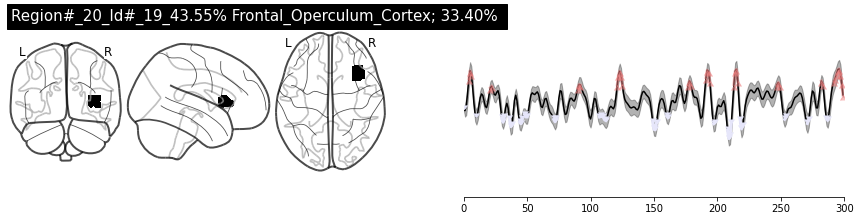


Text corresponding to peaks: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - making - shit - up - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - in - public - was - in - poor - taste - I - think - you - know - what - happened - And - that’s - what - made - him - a - sensation - on - campus - And - she - said - Jim - we - were - just - talking - about - Yes - Angela

Text corresponding to troughs: ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - Jim - Dwyer - who’s - a - senior - a

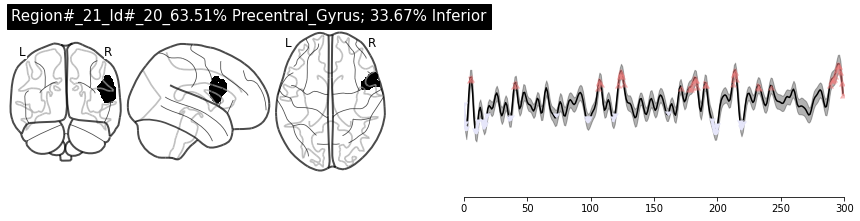


Text corresponding to peaks: and - looks - at - me - and - he - says - And - I - described - him - as - a - cape - wearing - masked - avenger - non - an - bestia - which - means - I - am - not - an - animal - was - the - kind - of - student - that - Dean - McGown - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - in - public - was - in - doing - this - And - that’s - what - made - him - a - sensation - Or - I - had - been - flirting - with - her - And - then - I - went - to - the - bar - about - it

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - on - to - win - a - Pulitzer - Prize - that - is - the - line - crossed - between - 

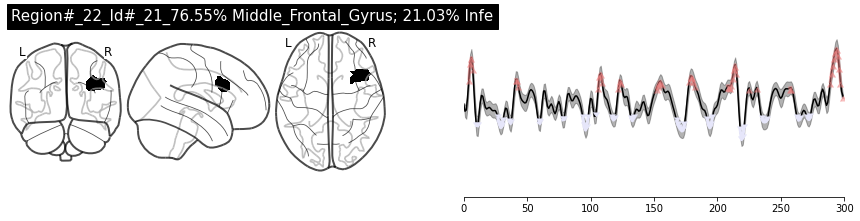


Text corresponding to peaks: and - he - says - Listen - up - punk - And - right - then - there’s - a - blur - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - non - an - bestia - which - means - I - am - signed - Pie - Man - So - I - was - there - with - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - I - came - and - I - saw - in - the - for - two - months - And - I - about - it

Text corresponding to troughs: working - to - middle - class - students - with - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - and - then - I - say - Dean 

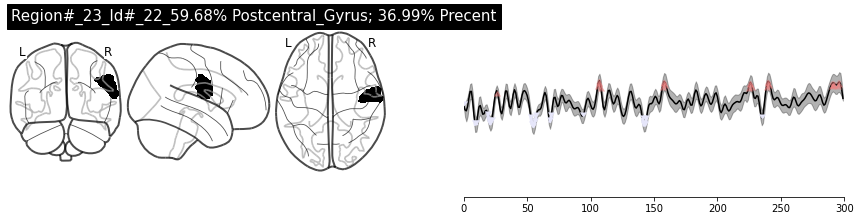


Text corresponding to peaks: Fordham’s - traditionally - And - I - described - him - as - a - cape - wearing - masked - avenger - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - I - came - and - I - saw - in - the - corner - Angela - from - my - Brit - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it

Text corresponding to troughs: student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - And - the - Dean - is - covered - with - cream - So - I - So - I - race - back - to - the - newsroom - with - my - scoop - against - crossing - that - line - crossed - A - few - days - later - I - get - a - letter - It - says - Dear - Jim - such - nuance - that


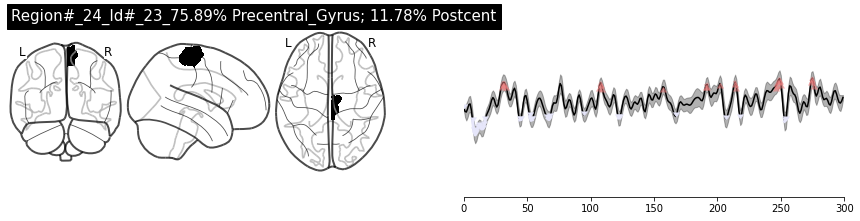


Text corresponding to peaks: ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - a - photographer - from - the - Ram - in - public - was - in - poor - taste - Ego - sum - non - And - that’s - what - made - him - a - sensation - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - in - the - corner - of - my - eye - which - becomes - this - figure - And - then - runs - away - And - the - Dean - Fuck - you - So - I - race - back - to - non - an - bestia - well - bred - Sheila - newsp

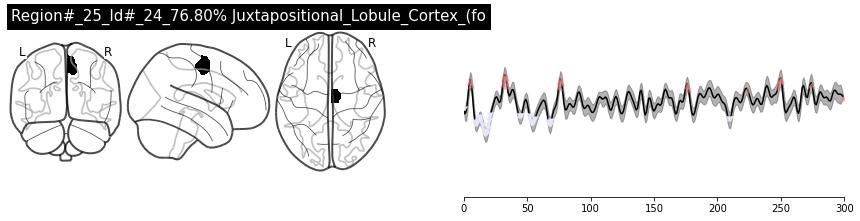


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - his - desk - But - that’s - toward - the - end - of - this - run - I - was - out - at - a - bar - she - said - Jim - we - were - just - talking - about - how - you - always - seem - question - that - came - with

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - in - the - corner - of - my - eye - which - becomes - this - figure - And - then - runs - away - And - the - Dean - is - covered - with - cream - So - I - 

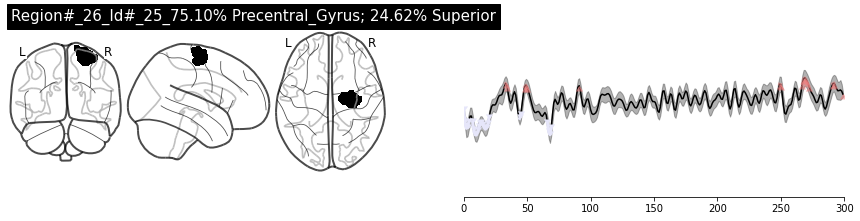


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - up - Jim - we - were - just - talking - about - how - you - always - seem - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - in - the - corner - of - my - eye - which - becomes - this - figure - Fuck - you - So - I - race - back - to - the - newsroom - with - my - scoop


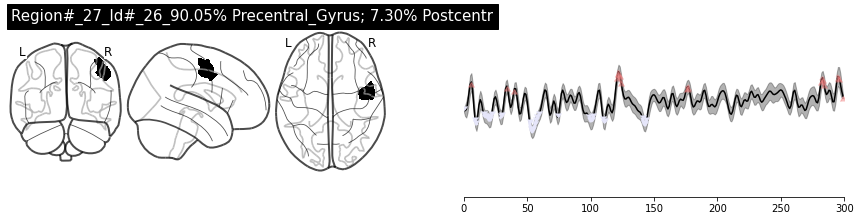


Text corresponding to peaks: University - plans - to - raise - tuition - and - looks - at - me - Ego - sum - non - an - bestia - which - means - I - am - his - desk - But - that’s - Yes - Angela - I - am - Pie - Man

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - wealthier - more - prestigious - ones - And - then - runs - away - And - the - Dean - is - covered - with - cream - So - I - give - him - a - moment - TRUE - and - assault - with - a - pastry - and - I - kind - of - liked - it - So - the - first - I - did - capeless - And - said - that - as - he - fled - the - scene - crossed - A - few - days - later - I - get - a - letter - It - says - Dear - Jim


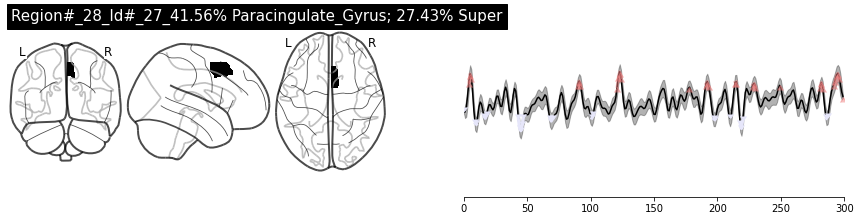


Text corresponding to peaks: making - shit - up - Ego - sum - non - an - bestia - which - means - I - am - just - a - rumor - please - do - not - spread - it - in - public - was - in - poor - taste - I - And - that’s - what - made - him - a - sensation - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - Jim - we - were - just - talking - about - said - Yes - Angela

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - kind - of - liked - it - So - the - first - I - did - from - behind - the - late - night - library - drop - box - leaving - the - scene - cape - and - quoting - him - in - class - The - Ram - ran - five -

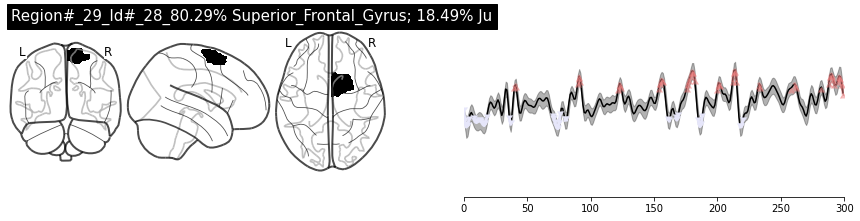


Text corresponding to peaks: and - looks - at - me - and - he - says - making - shit - up - non - an - bestia - which - means - I - am - So - I - was - there - with - a - photographer - from - the - Ram - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - and - fled - away - crying - Ego - sum - non - doing - this - And - that’s - what - made - him - a - sensation - had - been - flirting - with - her - and - with - I - if - I - said - yes - she - would - have - sex - with - me - Yes - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - and 

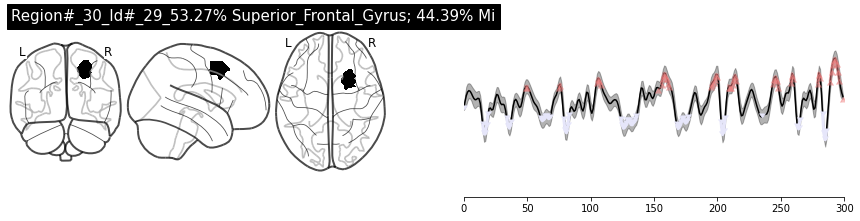


Text corresponding to peaks: mashing - a - cream - pie - into - Dean - McGowan’s - face - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - capital - P - capital - M - And - I - described - him - as - a - cape - wearing - masked - avenger - Pie - Man - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - was - different - from - me - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - she - said - I - knew - by - the - way - she - said - it - I - knew - that - out - of - costume - So - I - looked - at - her - and - I - said - about

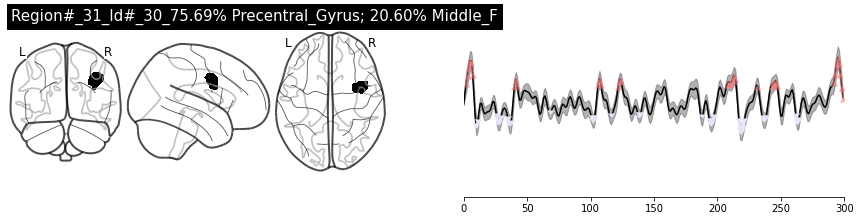


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - And - I - described - him - as - a - cape - wearing - masked - avenger - non - an - bestia - which - means - I - am - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - for - two - months - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And

Text corresponding to troughs: Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - So - I - race - back - to - kind - of - liked - it - So - the - first - I - did - was - I - gave - the - figure - a - name - him - a - catchphrase - And - that’s - how - right - boo - that - rule - think - you - know - what - happened - next - Pie - Man - emerged - f

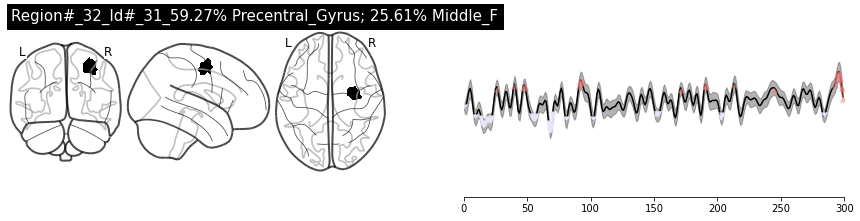


Text corresponding to peaks: Fordham’s - traditionally - and - looks - at - me - the - guy - standing - next - to - me - up - And - they - recommend - was - the - kind - of - student - that - Dean - McGown - Sheila - thought - drinking - in - public - was - in - a - tap - on - my - shoulder

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - And - the - Dean - is - covered - with - cream - So - I - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - So - I’m - banging - So - the - first - I - did - signed - Pie - Man - an - bestia - I - am - Pie - Man


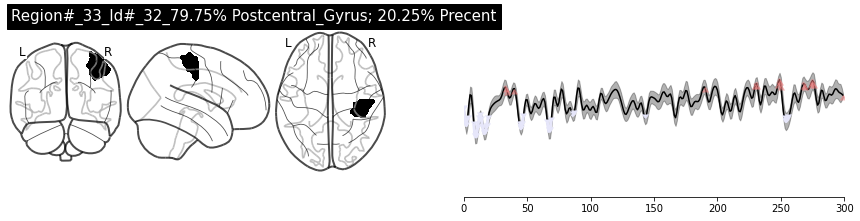


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - and - looks - at - me - Sheila - thought - drinking - and - I - had - been - flirting - for - two - months - she - said - Jim - we - were - just - talking - about - how - you - always - seem - For - having - brought - him - into - being - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - Fuck - you - So - I - race - back - to - the - newsroom - with - my - scoop - by - adding - an - element - of - I - get - a - letter - Man - will - strike - And - we - were - wondering - are - yo

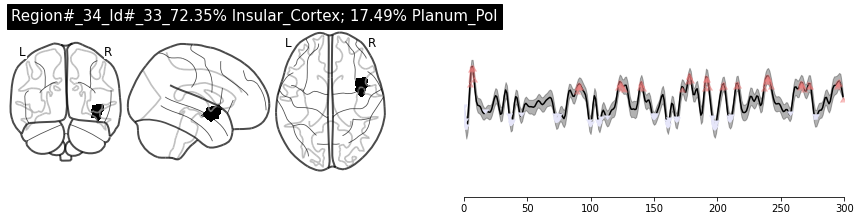


Text corresponding to peaks: Reporters - call - this - making - shit - up - non - an - bestia - which - means - I - am - not - an - animal - And - that’s - how - the - first - line - got - crossed - wanted - more - of - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - Sheila - thought - drinking - in - public - was - in - poor - taste - I - Or - at - least - what - made - him - a - sensation - on - campus - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - I - really - Pie - Man - For - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: reporter - for - the - Ram - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - and - assault - with

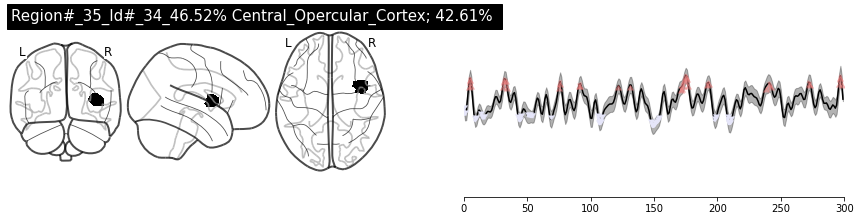


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - up - non - an - bestia - Latin - just - comes - to - me - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - Although - rumor - had - it - that - he - got - plenty - of - her - in - his - office - on - his - desk - But - that’s - poor - taste - I - about - it - And - then - I - went - to - the - bar - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - And - then - runs - away - And - the - Dean - the - newsroom - with - my - scoop - And - I

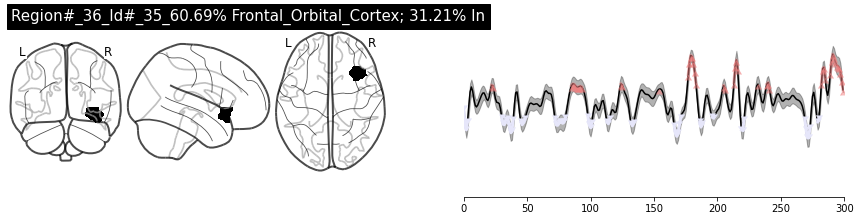


Text corresponding to peaks: and - out - comes - the - elusive - Dean - McGowan - by - adding - an - element - of - embellishment - Reporters - call - this - making - shit - up - And - they - recommend - which - means - I - am - not - an - animal - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Or - at - least - that’s - what - it - said - in - my - story - in - the - And - that’s - what - made - him - a - sensation - on - campus - Or - I - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - Yes - Angela - I - am - Pie - Man - about - it

Text corresponding to troughs: ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - substantially - above - the - inflation - rate - and - if - so - would

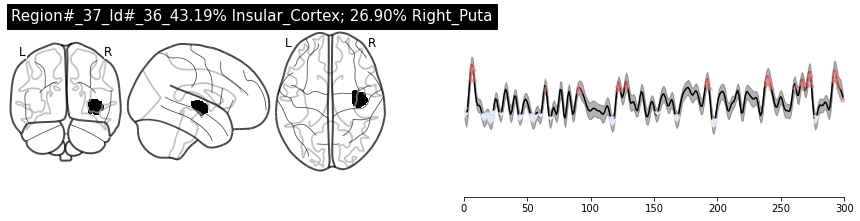


Text corresponding to peaks: the - Dean - says - Yes - making - shit - up - Ego - sum - non - an - bestia - I - needed - something - in - public - was - in - poor - taste - I - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - if - I - said - yes - she - would - have - sex - For - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - wealthier - more - prestigious - in - the - corner - of - my - eye - which - becomes - this - figure - And - the - Dean - is - covered - with - cream - and - then - I - say - Dean - McGowan - would - you - care - So - I

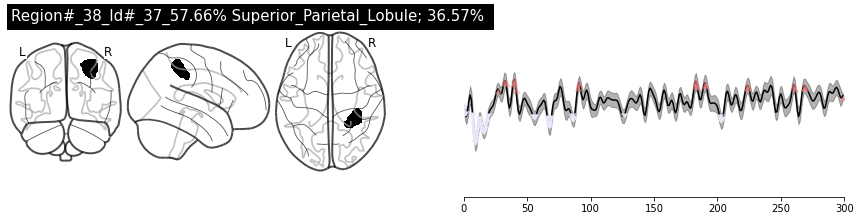


Text corresponding to peaks: working - to - middle - class - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - And - he - stops - and - looks - at - me - and - he - says - making - shit - up - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - in - public - was - in - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - knew - that - if - I - said - yes - she - would - have - sex - For - having - brought - him - into - being

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - is - covered - with - cream - Fuck - you - So - I - race - back - to - the - newsroom - with - my - scoop - by - adding - an - element - of - Ego - sum - non - an - bestia


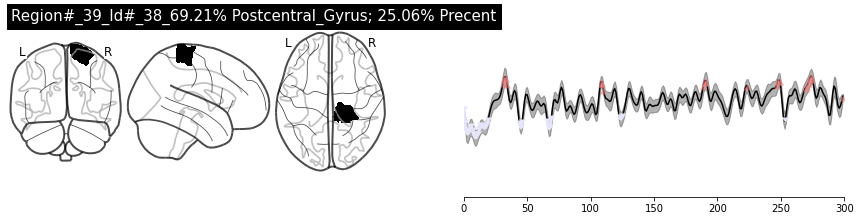


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - avenger - Though - in - fact - he’d - been - capeless - Sheila - thought - drinking - in - public - was - in - toward - the - end - of - this - run - I - was - out - at - a - bar - And - she - said - Jim - we - were - just - talking - about - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - Fuck - you - So - I 

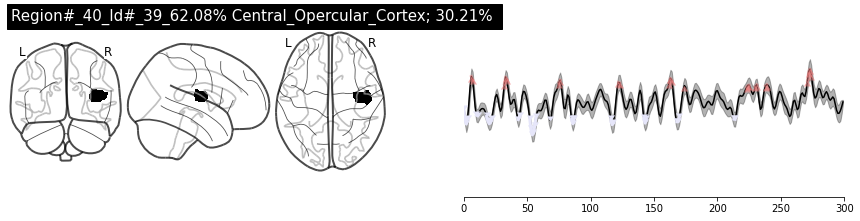


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - non - an - bestia - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - had - it - that - he - got - plenty - of - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - and - I - had - been - flirting - for - two - months - So - I - I - saw - her - there - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - right - then - there’s - a - blur - in

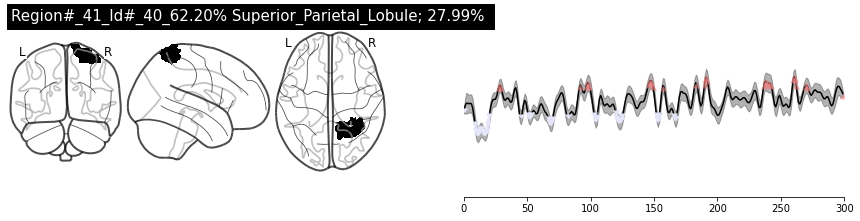


Text corresponding to peaks: students - with - wealthier - more - prestigious - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - details - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - Duane - a - photographer - from - the - Ram - had - collaborated - with - the - Dean - Sheila - thought - drinking - in - public - was - in - poor - taste - knew - I - existed - So - I - I - saw - her - there - about - it - And - then - I - went - to - the - bar - knew - that - if - I - said - yes - she - would - have - sex - with - me - Didn’t - she - only - know - about - him - through - me

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - this - figure - And - then - runs - away - So - I - race - back - to - the - newsroom - wit

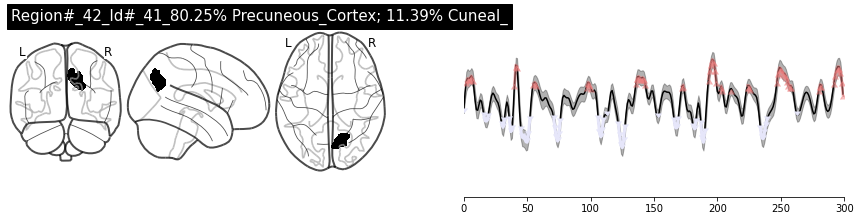


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - is - covered - with - cream - So - I - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - Man - I - love - it - Page - one - And - that’s - how - the - first - line - got - crossed - A - few - days - later - I - get - a - letter - wanted - more - of - Although - rumor - I - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - an - bestia - flowing - behind - him - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - So - I - looked - at - her - and - I - said - Yes

Text corresponding to troughs: toile

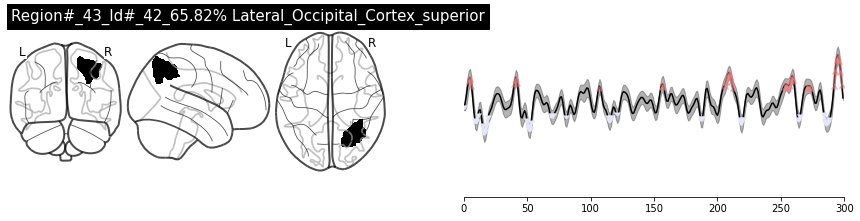


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - him - as - a - cape - wearing - masked - there - with - a - photographer - from - the - Ram - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - about - him - through - me - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - into - Dean - McGowan’s - face - And - then - runs - away - the - newsroom - with - my - scoop - and - I - find - the - editor - So - I’m - banging - And - I - gave - him - a - catchphrase - Ego - sum - beer -

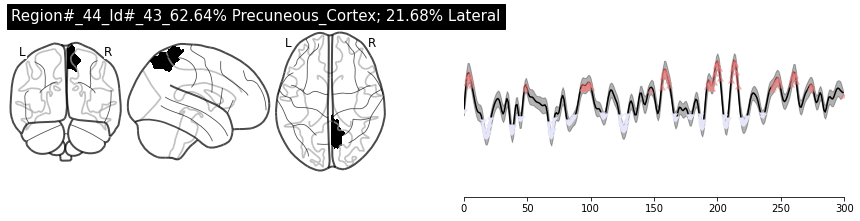


Text corresponding to peaks: next - to - me - mashing - a - cream - pie - And - they - recommend - against - crossing - that - line - But - I - had - just - seen - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - If - you - want - to - see - me - again - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - was - different - from - me - poor - taste - I - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - I - knew - by - the -

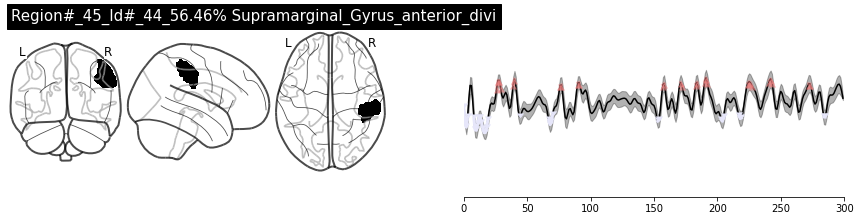


Text corresponding to peaks: Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - And - he - stops - and - looks - at - me - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - making - shit - up - a - photographer - from - the - Ram - And - sure - enough - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - in - public - was - in - poor - taste - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - Angela - from - my - Brit - about - it - And - then - I - went - to - the - bar - to - buy - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - in

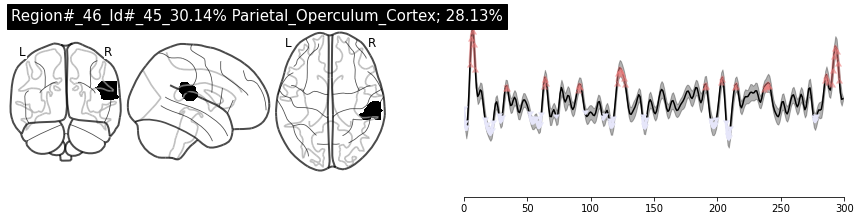


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - the - Dean - says - Yes - I - would - care - to - comment - making - shit - up - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - Which - makes - no - sense - Sheila - thought - drinking - in - public - was - in - an - bestia - And - that’s - what - made - him - a - sensation - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - she - said - Oh - good - Now - buy - me - a - beer

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - students - with - wealthier - more - prestigious - ones - And - then - runs - away - And - the - Dean - is - covered - with - cream - So - I - give - him - a - moment - an

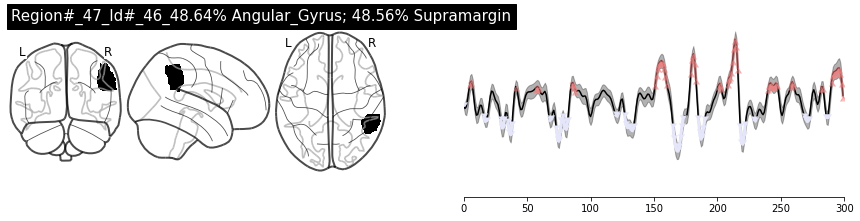


Text corresponding to peaks: and - he - says - So - I - give - him - a - moment - by - adding - an - element - of - embellishment - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - crying - Ego - sum - non - an - bestia - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - I - knew - by - the - way - she - said - it - I - knew - that - Yes - Angela

Text corresponding to troughs

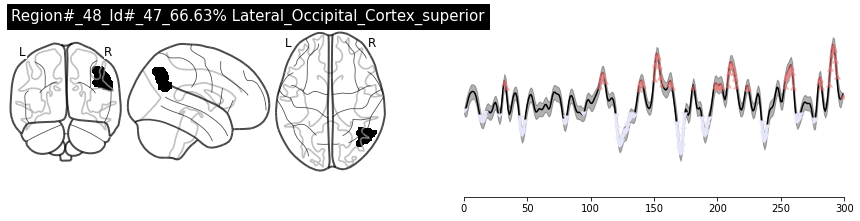


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - And - that’s - how - the - first - line - got - crossed - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - say - that - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - an - bestia - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - Man - will - strike - And - we - were - wondering - are - you - Pie - Man 

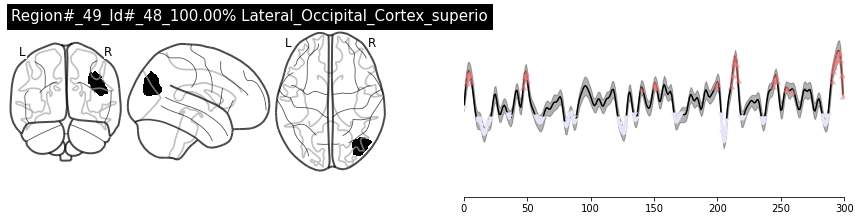


Text corresponding to peaks: the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - the - first - line - got - Library - Tuesday - at - 3 - o’clock - signed - made - his - delivery - and - fled - away - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - And - we - were - wondering - are - knew - by - the - way - she - said - it - I

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - substantially - above - the - inflation - rate - and - if - so - So - I - give - him - a - moment - and - then - I - say - Dean - McGowan - would - you - care - to - com

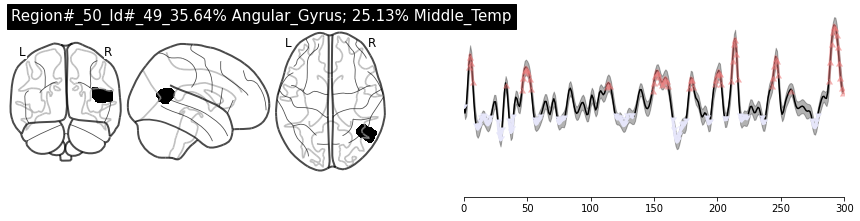


Text corresponding to peaks: is - it - TRUE - that - Fordham - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - in - rakish - glee - And - I - gave - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - an - bestia - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - she - sa

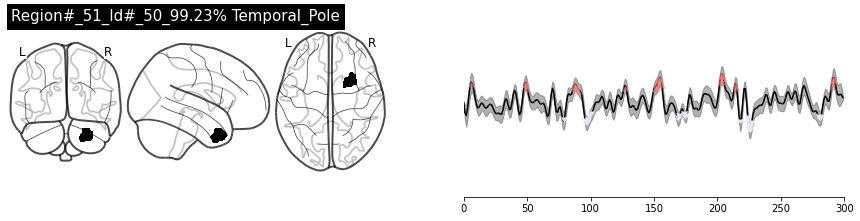


Text corresponding to peaks: next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - by - adding - an - element - of - embellishment - Reporters - call - this - making - shit - Which - makes - no - sense - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - Ego - sum - non - an - bestia - Or - at - least - And - that’s - what - made - him - a - sensation

Text corresponding to troughs: that - guy’s - a - But - I - had - just - seen - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - spirit - Sheila - had - it - that - he - got - plenty - of - her - in - his - office - on - and - quoting - him - in - class - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - Angela - from - my - Brit - So - I - looked - at - her - and - I - said


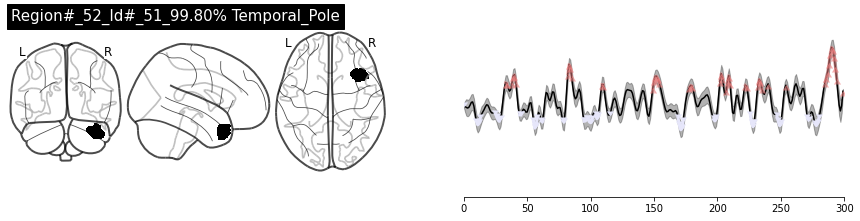


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - And - he - stops - and - looks - at - me - and - he - says - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - Though - in - fact - he’d - been - capeless - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - Ego - sum - non - an - bestia - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - And - toward - the - end - of - this - run - I - was - out - at - a - bar - Or - I - had - been - flirting - with - her - and - with - such - nuance - that - and - made - a - mental - note - to - do - nothing - And - we - were - wondering - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Text c

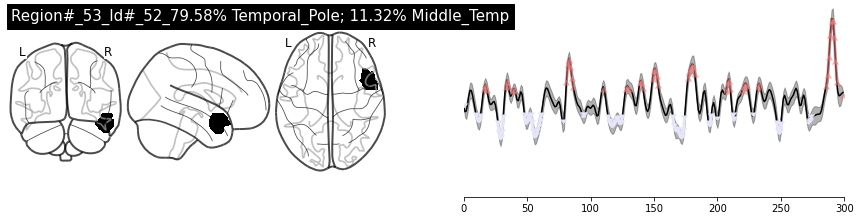


Text corresponding to peaks: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - And - he - stops - and - looks - at - me - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - capeless - I - needed - something - I’m - Catholic - And - that’s - how - the - first - line - got - crossed - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out -

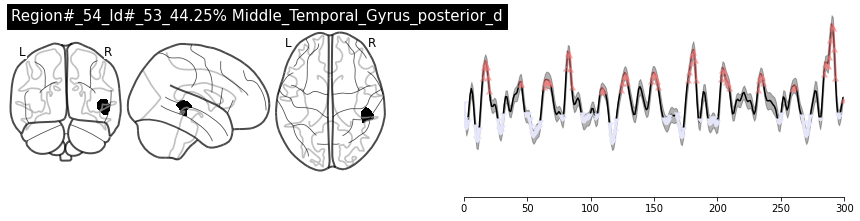


Text corresponding to peaks: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - in - the - corner - of - my - eye - which - becomes - this - figure - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - So - I - race - back - to - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - avenger - Though - in - fact - he’d - been - capeless - which - means - I - am - not - an - animal - Which - makes - no - sense - I - needed - something - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - an - bestia - Or - at - least - that’s - what - it 

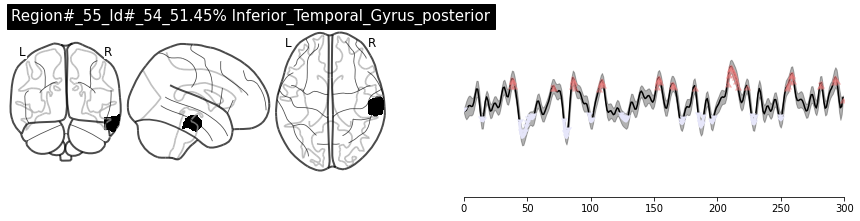


Text corresponding to peaks: wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - and - looks - at - me - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - by - adding - an - element - of - embellishment - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - signed - Pie - Man - So - I - was - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - But - the - fact - was - Sheila - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - toward - the - end - of - this - run - I - was - out - at - a - bar - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - said - Yes

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - in - the - corner - of - my - eye - which - becomes - 

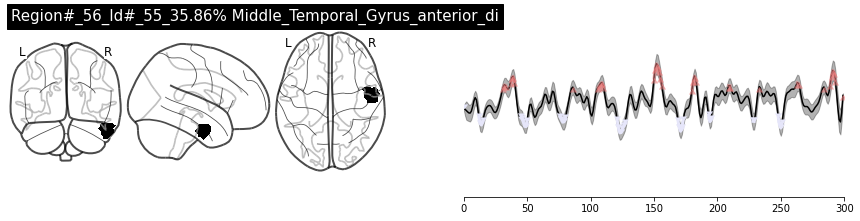


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - and - looks - at - me - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - photo - of - him - leaving - the - scene - cape - had - been - flirting - with - her - And - wasn’t - I - am - Pie - Man - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan

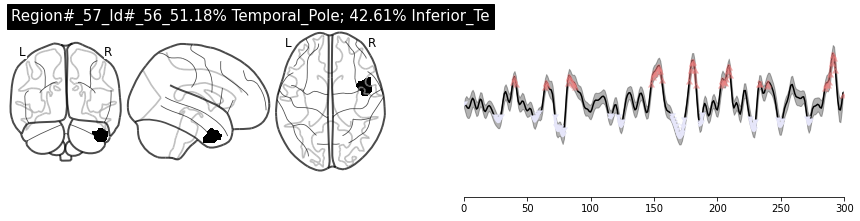


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - by - adding - an - element - of - embellishment - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - had - been - flirting - with - her - and - with - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - And - she - said -

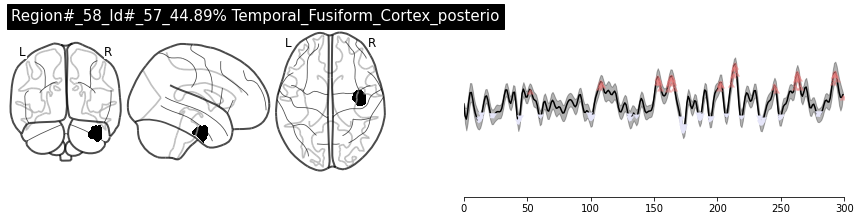


Text corresponding to peaks: And - then - runs - away - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - signed - Pie - Man - So - I - was - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - crying - Ego - sum - non - an - bestia - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - a - tap - on - my - shoulder - And - it - was - her - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - and - out - comes - the - elusive - Dean - McGowan - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - and - then - I - say - Dean - McGowan - would - you - care - and - assault - with - a - pastry - and - I - kind - of - lik

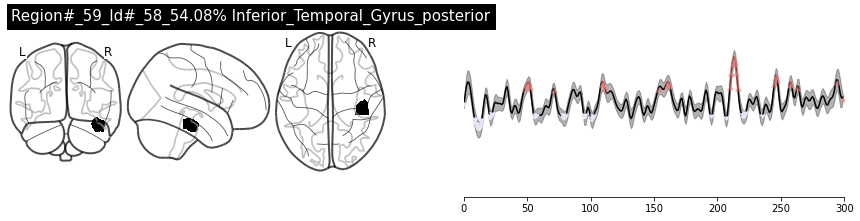


Text corresponding to peaks: mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - Jim - Dwyer - who’s - a - senior - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - student - body - president - And - now - Sheila - was - different - from - me - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - a - tap - on - my - shoulder - And - it - was - her - And - And - I

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - with - cream - So - I - Dean - McGowan - that - guy’s - a - dick - Write - it - up - But - I - had - just - seen - kind - of - liked - it - So - the - first - I - did - next - newspaper - the - next - day - five - major - stories - about - Pie - Man - all - of - them - by 

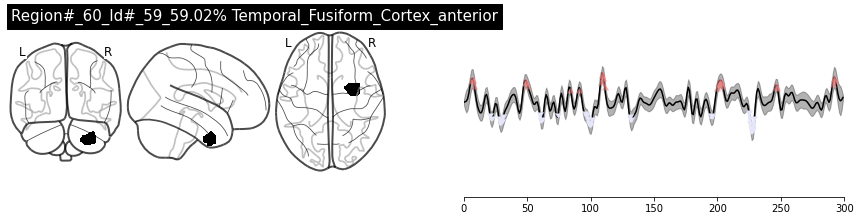


Text corresponding to peaks: next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - make - it - better - up - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - and - fled - away - crying - Ego - sum - non - an - bestia - And - it - was - her - And

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - students - with - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - TRUE - But - I - had - just - seen - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - kind - of - liked - it - Latin - just - comes - to - me - next - Pie - Man - emerged - I - came - and - I - saw - in - the - corner - Angela - from - my - Brit - Lit - c

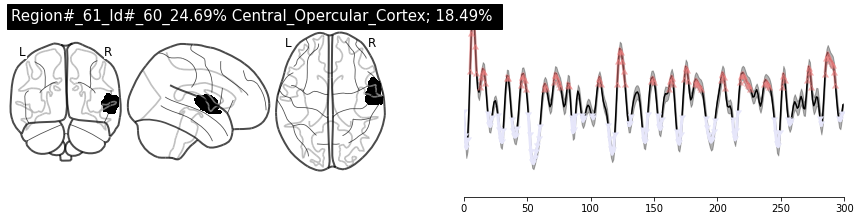


Text corresponding to peaks: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - University - plans - to - raise - tuition - substantially - above - the - inflation - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - the - Dean - says - Yes - I - would - care - to - comment - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - out - my - story - and - I - know - it’s - good - and - then - I - start - to - And - I - described - him - as - a - cape - wearing - masked - avenger - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - Which - makes - no - sense - in - action - be - on - the - steps - of - Duane - Library - Tuesday 

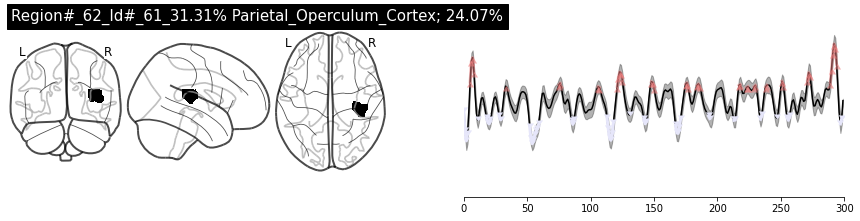


Text corresponding to peaks: is - it - TRUE - that - Fordham - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - And - I - described - him - as - a - cape - wearing - masked - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - in - action - be - on - the - steps - of - Duane - Library - Tuesday - her - in - his - office - on - his - desk - But - that’s - to - ban - outdoor - drinking - on - campus - The - infamous - no - more - People - started - dressing - like - him - and - quoting - him - in - class - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - with - some - friends - And - now - Angela - and - I - had - been - flirting - So - I - I - saw - her - there - to - know - when - and - where - Pie - about - him - through - me - But - she - had - asked - me - a - straightforward - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordha

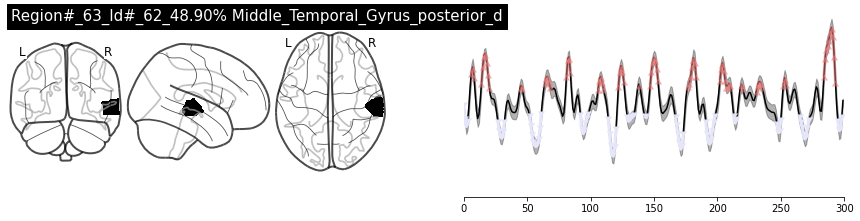


Text corresponding to peaks: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - this - figure - holding - a - cream - pie - which - becomes - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - So - I - race - back - to - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - non - an - bestia - which - means - I - am - not - an - animal - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - colla

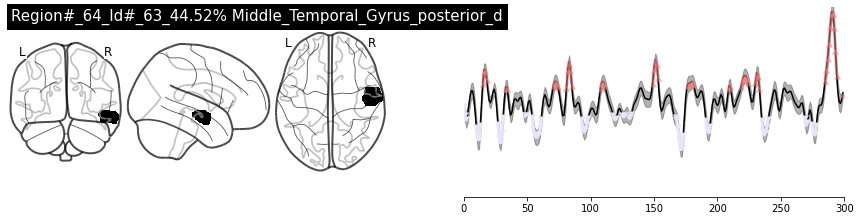


Text corresponding to peaks: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - photo - of - him - leaving - the - scene - cape - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar 

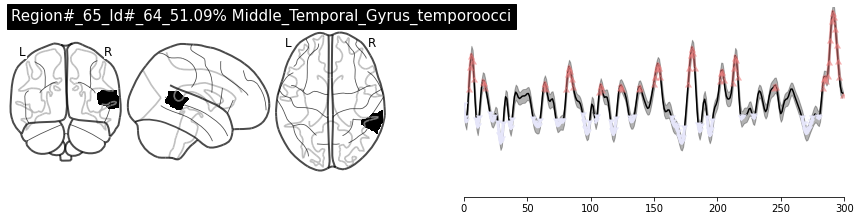


Text corresponding to peaks: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - Dean - says - Yes - I - would - care - to - comment - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - which - means - I - am - not - an - animal - And - that’s - how - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - Ego - sum - non - an - bestia - Or - at - least - doing - this - And - that’s - what - made - him - a - sensation - on - campus - a - tap - on - my - shoulder - And - it - was - her - Angela - I - am - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - a

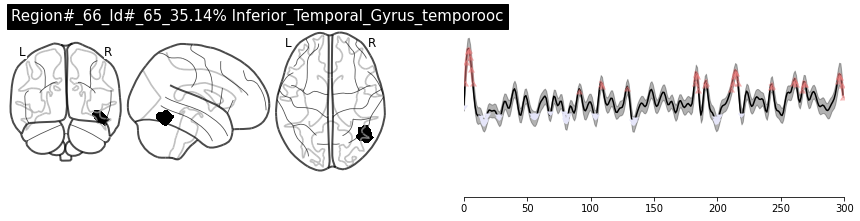


Text corresponding to peaks: up - avenger - Though - in - fact - he’d - been - I - needed - something - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - Sheila - thought - drinking - in - public - was - in - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - then - I - went - to - the - bar - to - buy - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - having - brought - him - into - being

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - working - to - middle - class - students - with - And - the - Dean - is - covered - with - cream - So - I - So - I - race - back - to - that - guy’s - a - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - was - I - gave - the - figure - a - name -

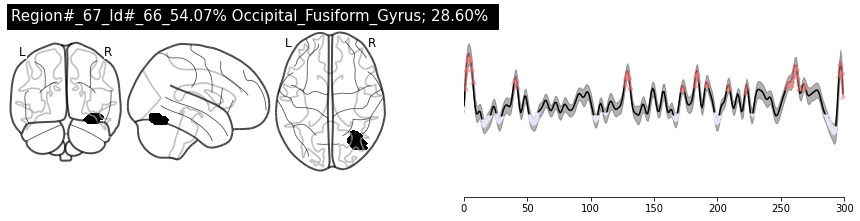


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - Which - makes - no - sense - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - wanted - more - of - Although - rumor - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - in - public - was - in - poor - taste - which - ran - with - a - photo - of - him - And - toward - the - end - of - this - run - I - was - out - at - a - bar - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - For - having - brought - him - into - being

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - Fordham’s - traditionally - working - to - middle - class - students - with - we

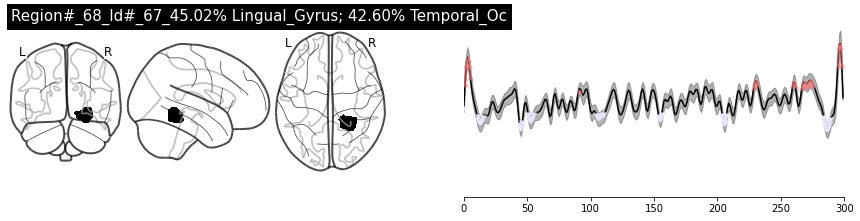


Text corresponding to peaks: up - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - knew - that - if - I - said - yes - she - would - have - sex - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - And - then - runs - away - And - the - Dean - is - covered - capital - P - capital - M - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - So - I - was - there - with - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next

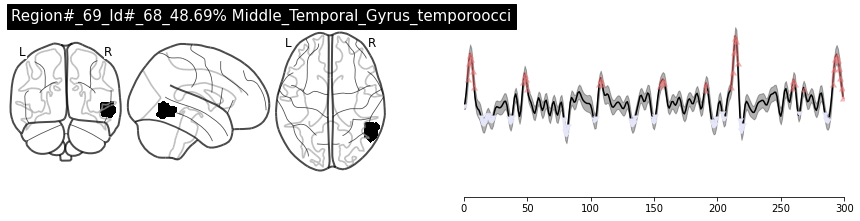


Text corresponding to peaks: the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - Sheila - thought - drinking - in - public - was - in - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - For

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - that - guy’s - a - dick - Write - it - up - So - I’m - 

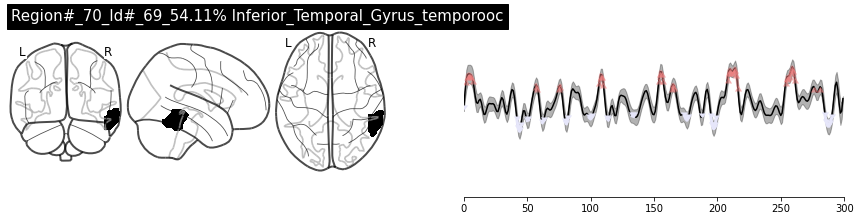


Text corresponding to peaks: So - I - give - him - a - moment - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - So - I - was - there - with - a - photographer - from - the - Ram - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - I - wasn’t - Pie - said

Text corresponding to troughs: Listen - up - punk - And - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - into - Dean - McGowan’s - face - And

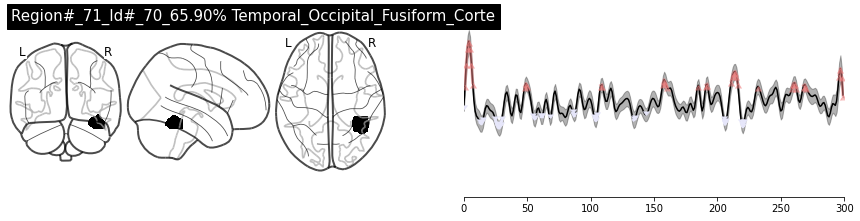


Text corresponding to peaks: next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - avenger - Though - in - fact - he’d - been - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - drinking - on - campus - in - public - was - in - poor - taste - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - Or - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - having - brought - him - into - being - Didn’t - she - only - know

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - is - covered - with - cream - to - comment - on - this - latest - attack - And - So - I - r

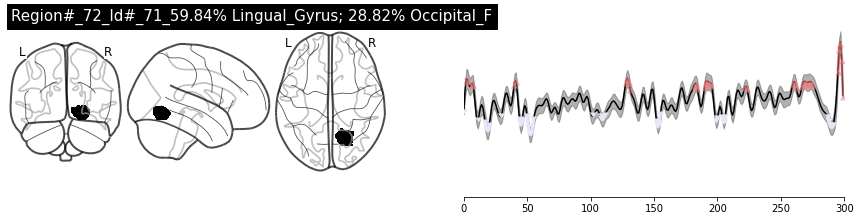


Text corresponding to peaks: and - looks - at - me - and - he - says - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - in - public - was - in - poor - taste - I - think - you - know - what - happened - next - And - toward - the - end - of - this - run - I - was - out - at - a - bar - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - wealthier - more - prestigious - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - 

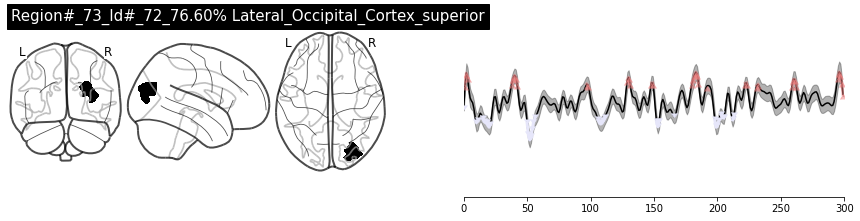


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - Listen - up - punk - And - the - line - crossed - between - a - high - powered - dean - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - in - action - be - on - the - steps - of - Duane - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - poor - taste - And - toward - the - end - of - this - run - I - was - out - at - a - bar - for - two - months - Or - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - into - Dean - McGowan’s - face - And - then

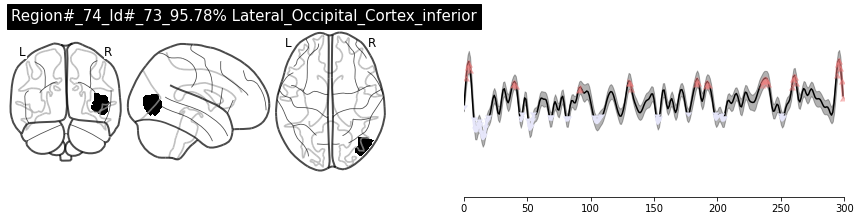


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - up - I’m - Catholic - Latin - just - comes - to - me - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - in - public - was - in - poor - taste - I - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - this - figure - holding - a - cream - pie - which - becomes - And - then - runs - away - And - the - Dean - is - covered - So - I - race - back - to - the - newsroom - with - my - scoop - So - I

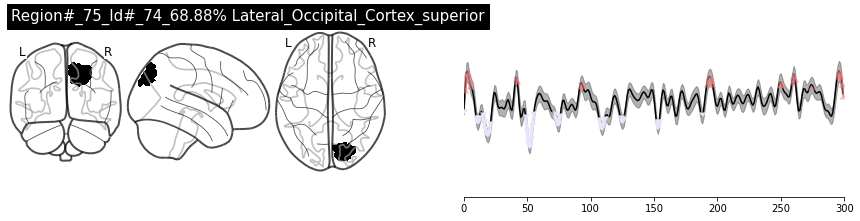


Text corresponding to peaks: and - he - says - Listen - up - punk - And - And - they - recommend - poor - taste - I - think - you - know - what - happened - next - Pie - Man - emerged - Jim - we - were - just - talking - about - how - you - always - seem - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - question - that - came - with

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - And - the - Dean - is - covered - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - him - as - a - cape - wearing - masked - avenger - Th

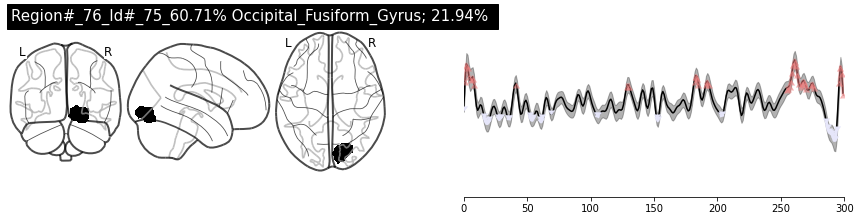


Text corresponding to peaks: and - he - says - I - needed - something - I’m - Catholic - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - in - public - was - in - poor - taste - I - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - For - having - brought - him - into - being - Didn’t - she - only - know - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - working - to - middle - class - students - with - wealthier - more - prestigious - substantially - above - the - inflation - rate - and - if - so - And - then - runs - away - And - the - Dean - is - covered - and - then - I - say - Dean - McGowan - would - 

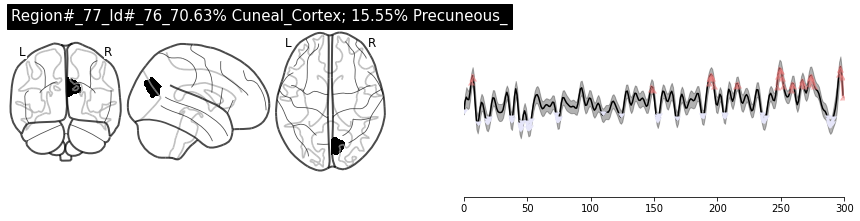


Text corresponding to peaks: in - action - be - on - the - steps - of - Duane - I - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - what - made - him - a - sensation - on - campus - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - I - knew - by - the - way - she - said - it - I - knew - that - For - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - into - Dean - McGowan’s - face - And - then - runs - away - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - capeless 

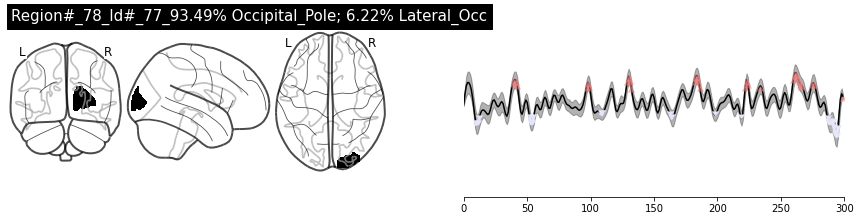


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - Listen - up - punk - And - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - The - infamous - no - more - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - and - with - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: And - then - runs - away - And - the - Dean - is - covered - avenger - Though - in - fact - he’d - been - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - late - night - library - drop - box - The -

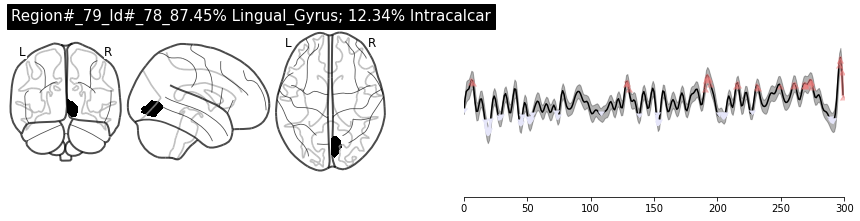


Text corresponding to peaks: I - needed - something - I’m - Catholic - Sheila - thought - drinking - in - public - was - in - poor - taste - I - think - you - know - what - happened - what - made - him - a - sensation - on - campus - for - two - months - Or - I - Jim - we - were - just - talking - about - knew - that - if - I - said - yes - she - would - have - sex - For - having - brought - him - into - being - Didn’t - she - only - know - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - students - with - wealthier - more - prestigious - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - And - then - runs - away - And - the - Dean - on - to - win - a - Pulitzer - 

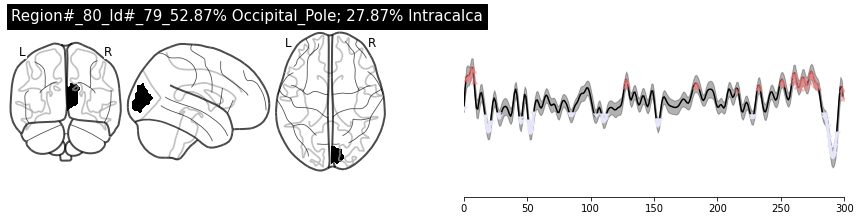


Text corresponding to peaks: Which - makes - no - sense - I - needed - something - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - what - made - him - a - sensation - Or - I - had - been - flirting - with - her - how - you - always - seem - to - know - when - and - where - Pie - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - I - really - Pie - Man - For - having - brought - him - into - being - Didn’t - she - only - know - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - seen - the - guy - out - of - costume

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - working - to - middle - class 

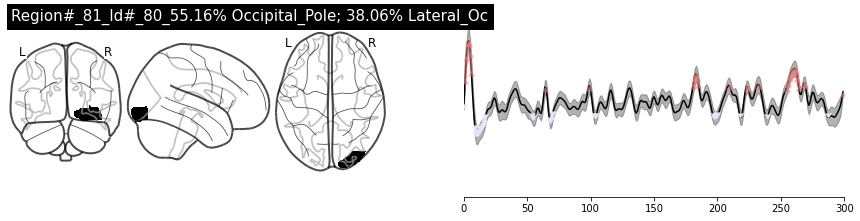


Text corresponding to peaks: the - Dean - says - Yes - and - assault - with - a - pastry - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - photo - of - him - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - Or - I - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - For - having - brought - him - into - being

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - And - the - Dean - is - covered - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - from - behind - the - late - night - librar

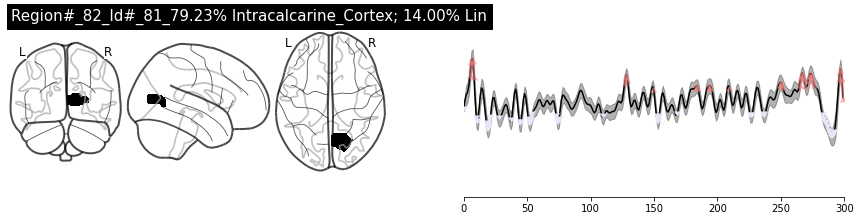


Text corresponding to peaks: Which - makes - no - sense - I - needed - something - be - on - the - steps - of - Duane - had - collaborated - with - the - Dean - to - ban - outdoor - I - think - you - know - what - happened - photo - of - him - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - I - really - Pie - Man - For - having - brought - him - into - being - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - students - with - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - And - then - runs - away - And - the - Dean - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - ca

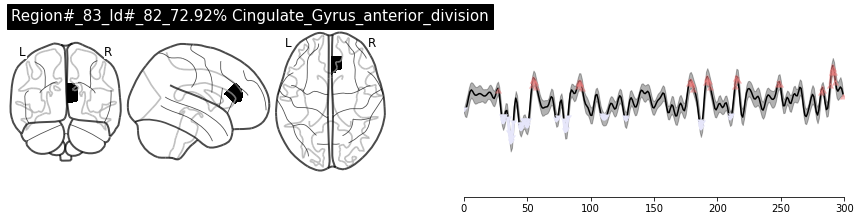


Text corresponding to peaks: working - to - middle - class - And - the - Dean - is - covered - with - cream - So - I - making - shit - up - And - they - recommend - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - in - public - was - in - poor - taste - I - think - you - know - what - happened - And - that’s - what - made - him - a - sensation - on - campus - she - said - Jim - we - were - just - talking - about - Yes - Angela - about - it

Text corresponding to troughs: ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - Mc

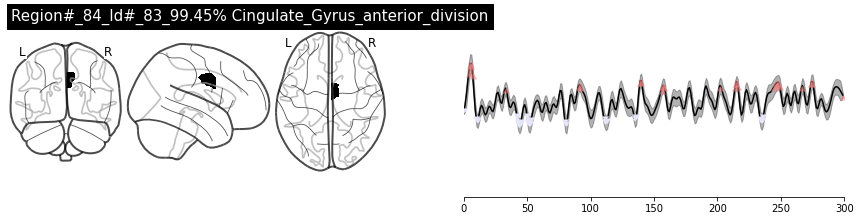


Text corresponding to peaks: is - it - TRUE - that - Fordham - up - And - that’s - how - the - first - line - got - there - with - a - photographer - from - the - Ram - And - sure - enough - Ego - sum - non - And - that’s - what - made - him - a - sensation - on - campus - a - tap - on - my - shoulder - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: Listen - up - punk - And - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - into - Dean - McGowan’s - face - And - then - runs - away - dick - Write - it - up - So - I’m - banging - And - said - that - as - he - fled - the - scene - he - clicked - his - heels - in - rakish - glee - and - he - says - Pie - Man - and - with - such - nuance - that - there - was - a - question - about - whether - she


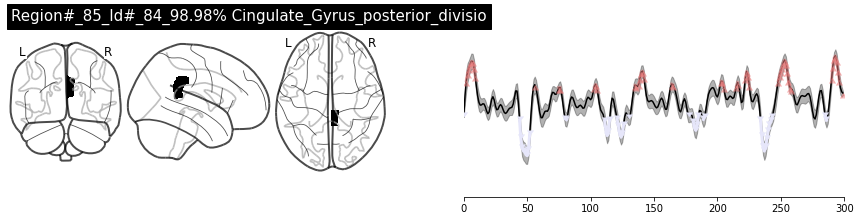


Text corresponding to peaks: with - cream - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - capital - P - capital - M - and - he - says - Pie - Man - And - that’s - how - the - first - line - got - crossed - A - few - days - later - students - who - wore - flannel - shirts - and - worked - part - time - jobs - an - bestia - Or - at - least - what - made - him - a - sensation - on - campus - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - she - said - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I

Text corresponding to troughs: in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - 

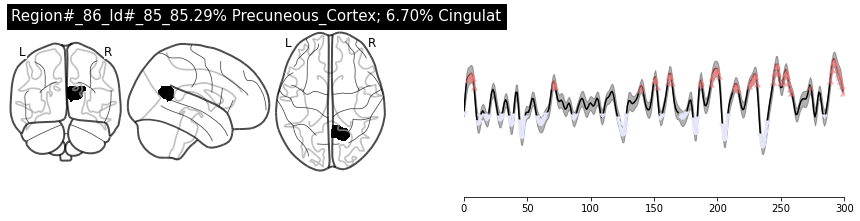


Text corresponding to peaks: and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - and - he - will - go - And - that’s - how - the - first - line - got - Library - Tuesday - at - 3 - o’clock - signed - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - The - infamous - no - more - beer - at - barbecues - rule - That’s - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - And - that’s - what - made - him - a - sensation - on - campus - I - came - and - I - saw - in - the - corner - Angela - from - my - Brit - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - and - where - Pie - Man - w

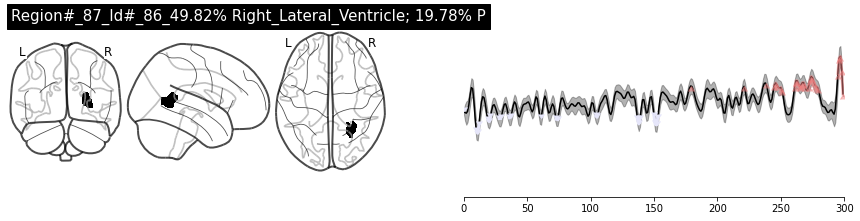


Text corresponding to peaks: outside - this - rumor - Man - all - of - them - by - me - a - tap - on - my - shoulder - And - it - was - her - And - how - you - always - seem - to - know - when - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man - For - having - brought - him - into - being - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - seen - the - guy - out - of - costume

Text corresponding to troughs: student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - students - with - wealthier - more - prestigious - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - to - comment - on - this - latest - attack - on - to - win - a - Pulitzer - Prize - that - is - TRUE - I - called - him - Pie - Man - capit

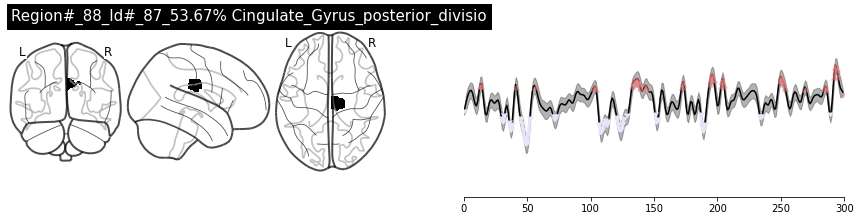


Text corresponding to peaks: I - began - my - illustrious - career - in - journalism - and - he - says - with - cream - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - Man - I - love - it - Page - one - And - that’s - how - I - get - a - letter - It - says - Dear - Jim - wanted - more - of - Although - rumor - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - an - bestia - Or - at - least - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - Man - will - strike - having - brought - him - into - being - And - she - said - Oh - good

Text corresponding to troughs: ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this -

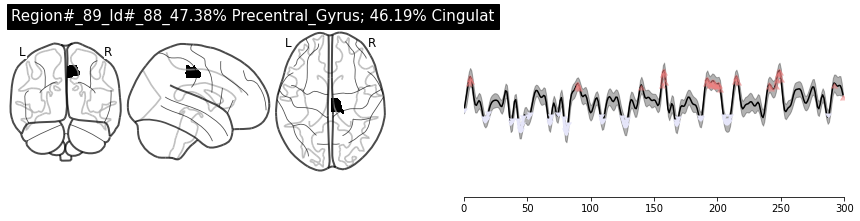


Text corresponding to peaks: Reporters - call - this - making - shit - up - the - first - line - got - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - in - public - was - in - poor - taste - I - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - And - that’s - what - made - him - a - sensation - on - campus - about - it - And - then - I - went - to - the - bar - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - wouldn’t - that - be - a - betrayal - of - its - mission - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - 

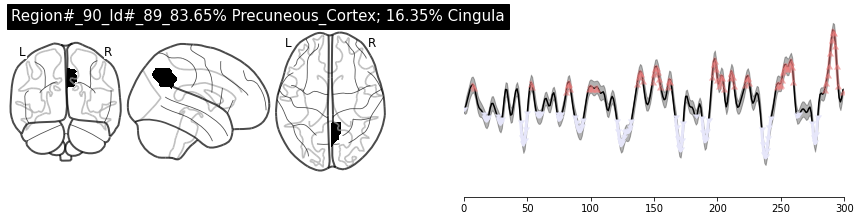


Text corresponding to peaks: And - the - Dean - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - and - assault - with - a - pastry - and - I - kind - of - liked - it - I - called - him - Pie - Man - capital - P - capital - M - I - love - it - Page - one - And - that’s - how - the - first - line - got - crossed - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - an - bestia - Or - at - least - leaving - the - scene - cape - flowing - behind - him - doing - this - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - And - she - s

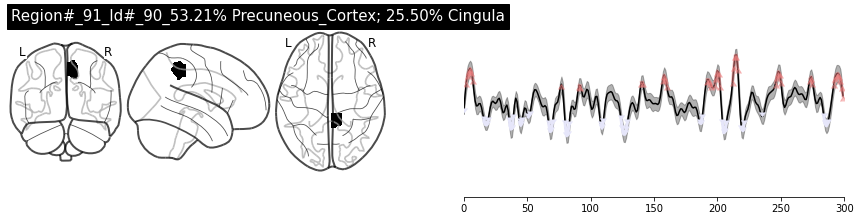


Text corresponding to peaks: and - he - says - up - the - first - line - got - crossed - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - poor - taste - I - think - you - know - what - happened - next - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - in - the - corner - of - my - eye - which - becomes - this

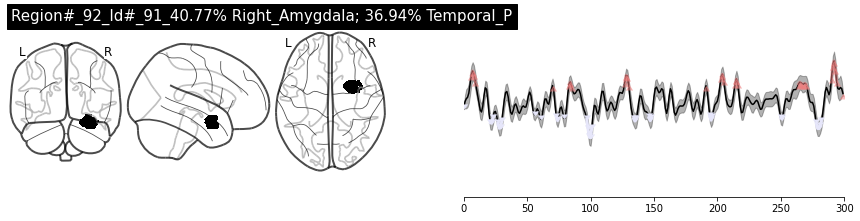


Text corresponding to peaks: and - I - find - the - editor - and - then - I - start - to - make - it - better - Which - makes - no - sense - I - needed - something - I’m - Catholic - in - public - was - in - an - bestia - Or - at - least - And - that’s - what - made - him - a - sensation - on - campus - And - wasn’t - I - really - Pie - Man - For - having - brought - him - into - being - Didn’t - she - only - know

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - working - to - middle - class - students - with - wealthier - more - prestigious - ones - with - cream - to - comment - on - this - latest - attack - on - to - win - a - Pulitzer - Prize - that - is - TRUE - that - guy’s - a - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - kind - of - liked - it - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says 

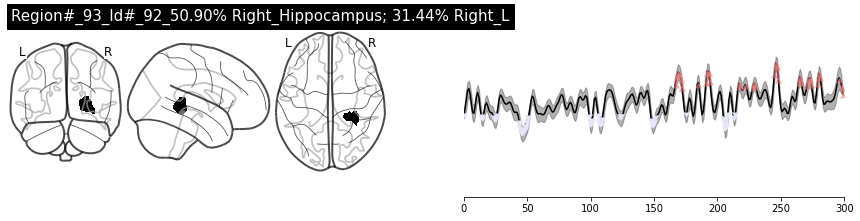


Text corresponding to peaks: well - bred - Sheila - had - school - spirit - Sheila - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - drinking - on - campus - in - public - was - in - poor - taste - I - think - you - know - what - happened - People - started - dressing - like - him - and - quoting - him - in - class - And - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - a - tap - on - my - shoulder - And - it - was - her - And - she - said - And - wasn’t - I - really - Pie - Man - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - out - of - costume - So - I - looked - at - her - and - I - said

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - architect - of - a - policy - to - replace - Fordham’s - traditionally - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pi

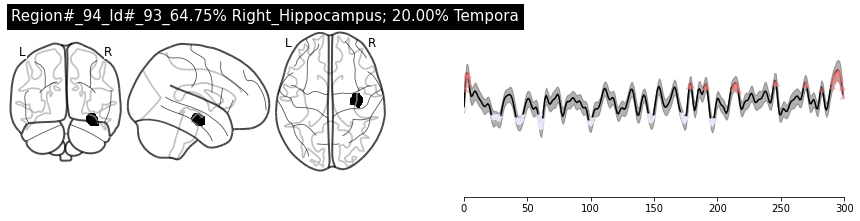


Text corresponding to peaks: just - a - rumor - please - do - not - spread - it - outside - this - rumor - Sheila - thought - drinking - in - public - was - in - doing - this - And - that’s - what - made - him - a - sensation - on - campus - a - tap - on - my - shoulder - And - it - was - her - having - brought - him - into - being - Didn’t - she - only - know - Yes

Text corresponding to troughs: Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - Listen - up - punk - And - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - and - assault - with - a - pastry - and - I - kind - of - liked - it - details - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - D

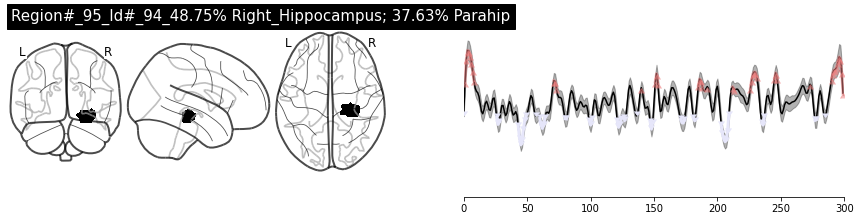


Text corresponding to peaks: Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - the - first - line - got - at - 3 - o’clock - signed - Pie - Man - drinking - on - campus - The - infamous - no - more - beer - at - barbecues - rule - That’s - right - boo - that - rule - poor - taste - doing - this - corner - Angela - from - my - Brit - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - a - tap - on - my - shoulder - And - it - was - her - And - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: Fordham’s - traditionally - working - to - middle - class - students - with - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - So - I - and - then - I - say - Dean - 

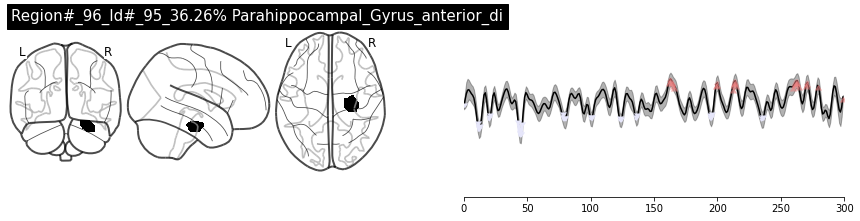


Text corresponding to peaks: was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - made - his - delivery - and - fled - away - doing - this - And - that’s - what - made - him - a - sensation - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - Didn’t - she - only - know - about - him - through - me - out - of - costume

Text corresponding to troughs: I - began - my - illustrious - career - University - And - one - day - I’m - walking - toward - the - campus - center - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - Dean - McGowan - that - guy’s - a - dick - Write - it - up - and - I - kind - of - liked - it - which - means - I - am - Man - I - love - it - Page - one - think - you - know - what - happened - next - Pie - Man - emerged - such 

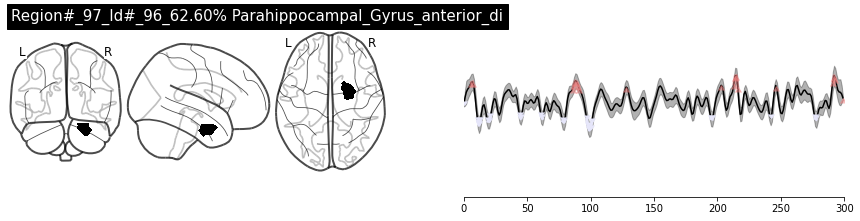


Text corresponding to peaks: by - adding - an - element - of - embellishment - Reporters - call - this - making - shit - up - an - bestia - And - that’s - what - made - him - a - sensation - on - campus - And - it - was - her

Text corresponding to troughs: I - began - my - illustrious - career - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - in - the - corner - of - my - eye - which - becomes - this - figure - to - comment - on - this - latest - attack - And - Dean - McGowan - that - guy’s - a - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - kind - of - liked - it - next - Pie - Man - emerged - And - then - I - went - to - the - bar - Man - As - far - as - I - knew - I - had - never - seen - the - guy


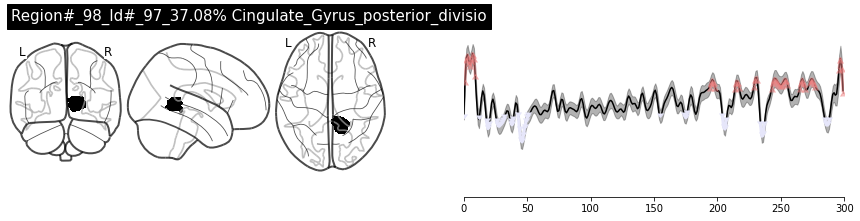


Text corresponding to peaks: think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - And - that’s - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - to - know - when - and - where - Pie - Man - will - strike - And - we - were - wondering - are - I - really - Pie - Man - For - having - brought - him - into - being - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - Fordham’s - traditionally 

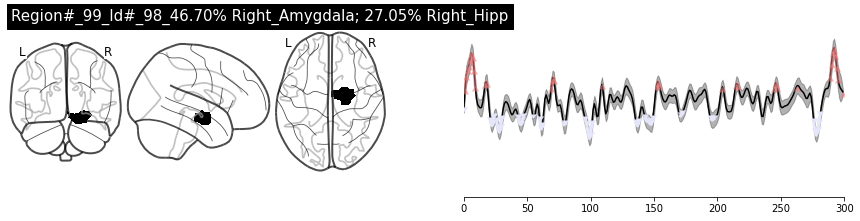


Text corresponding to peaks: reporter - for - the - Ram - the - the - newsroom - with - my - scoop - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - Though - in - fact - he’d - been - signed - Pie - Man - what - made - him - a - sensation - on - campus - a - tap - on - my - shoulder - And - it - was - her - And - about - it

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - is - covered - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - that - guy’s - a - dick - Write - it - up - But - I - had - j

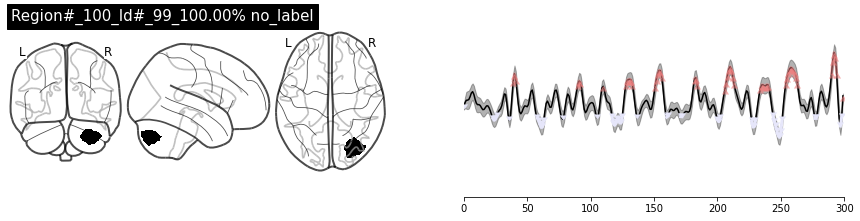


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - making - shit - up - capeless - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - So - I - finish - my - story - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me

Text corresponding to 

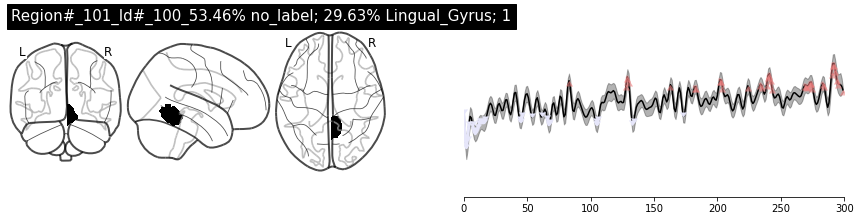


Text corresponding to peaks: and - then - I - start - to - I - needed - something - I’m - Catholic - and - all - the - other - Fordham - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Ego - sum - non - an - bestia - one - night - and - I - saw - and - with - such - nuance - that - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - to - buy - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - Angela - I - am - Pie - Man

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - wh

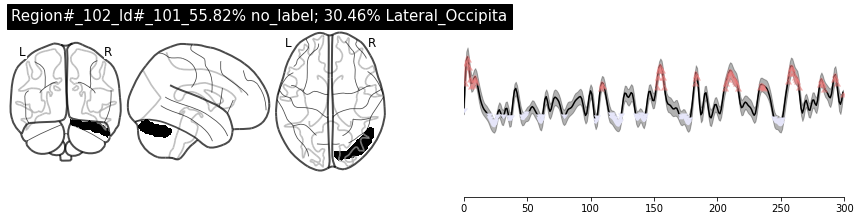


Text corresponding to peaks: avenger - Though - in - fact - he’d - been - capeless - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - said - Yes - Angela - I - am - Pie - Man

Text corresponding to troughs: University - And - one - day - I’m - walking - toward - the - campus - center - and - out - 

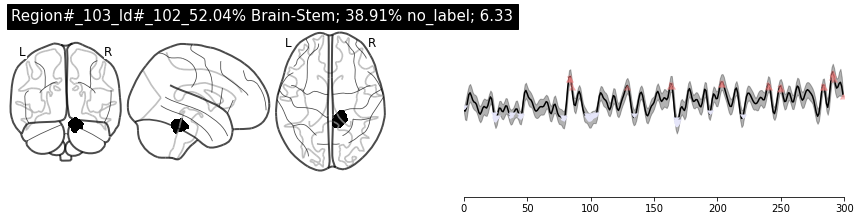


Text corresponding to peaks: and - then - I - start - to - make - it - better - I - needed - something - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - an - bestia - and - made - a - mental - note - to - do - nothing - about - it - Jim - we - were - just - talking - about - how - you - always - seem - Angela - I - am - Pie - Man

Text corresponding to troughs: architect - of - a - policy - to - replace - Fordham’s - traditionally - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - Dean - McGowan - that - guy’s - a - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - kind - of - liked - it - So - the - first - I - did - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - and - I - hand - it - to - Dwyer - and - he - reads - well - bred - Sheila - had - school - spirit - think - you - know - wha

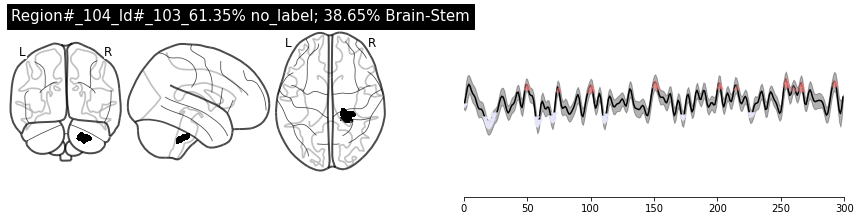


Text corresponding to peaks: mashing - a - cream - pie - into - Dean - McGowan’s - face - TRUE - and - assault - with - a - pastry - and - I - kind - of - liked - it - Library - Tuesday - at - 3 - o’clock - signed - crying - Ego - sum - non - what - made - him - a - sensation - Man - will - strike - And - we - were - wondering - are - knew - that - I - really - Pie - Man

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - So - I - give - him - a - moment - the - newsroom - with - my - scoop - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - capeless - And - said - that - as - he - fled - the - scene - he - clicked - his - heels - wanted - more - of - Although - rumor - corner - Angela - from - my - Brit


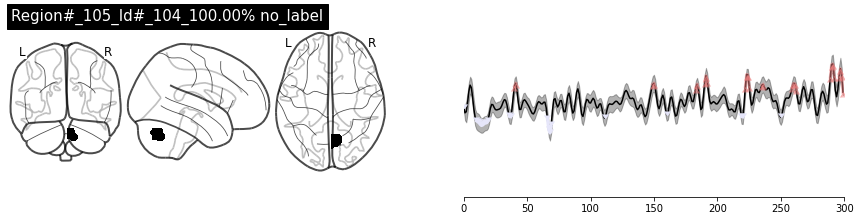


Text corresponding to peaks: and - looks - at - me - and - he - says - be - on - the - steps - of - Duane - Library - Tuesday - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - in - public - was - in - poor - taste - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - such - nuance - that - there - was - a - question - about - whether - she - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - Fuck - you - So - I - race - back - to - the - newsroom - with - my - scoop - 

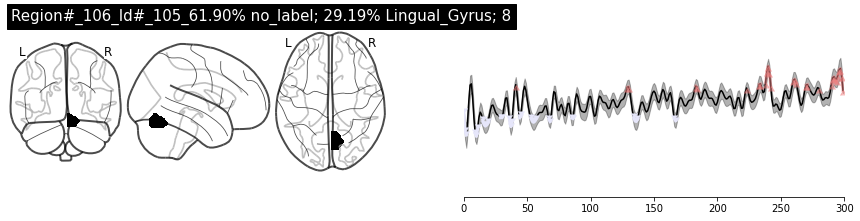


Text corresponding to peaks: and - he - says - I - needed - something - I’m - Catholic - had - collaborated - with - the - Dean - to - ban - outdoor - toward - the - end - of - this - run - I - was - out - at - a - bar - had - been - flirting - with - her - and - with - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - knew - that - if - I - said - yes - she - would - have - sex - with - me - Didn’t - she - only - know - about - him - through - me - So - I - looked - at - her - and - I

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - wealthier - more - prestigious - ones - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - And - the - Dean - is - covered - with - cream - So - I -

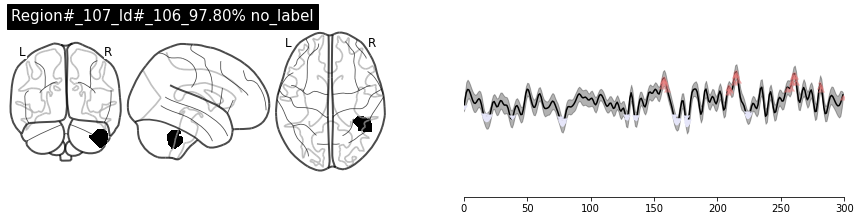


Text corresponding to peaks: there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - which - ran - with - a - photo - of - him - leaving - the - scene - cape - And - that’s - what - made - him - a - sensation - on - campus - are - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - said - Yes

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - Dean - McGowan - that - guy’s - a - I - needed - something - and - he - says - Pie - Man - Sheila - was - well - bred - Sheila - had - school - spirit - her - in - his - office - on - his - desk - But - that’s - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and 

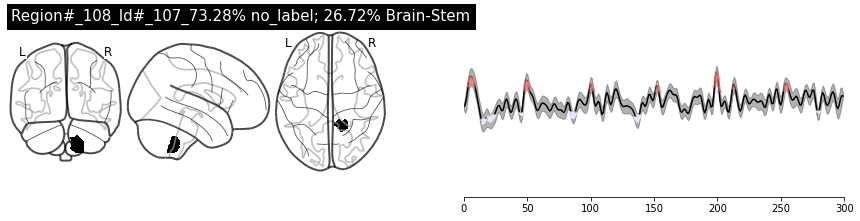


Text corresponding to peaks: next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - and - I - kind - of - liked - it - signed - Pie - Man - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Man - will - strike - And - we - were - wondering - are

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - this - figure - by - adding - an - element - of - Man - I - love - it - Page - one - out - of - costume


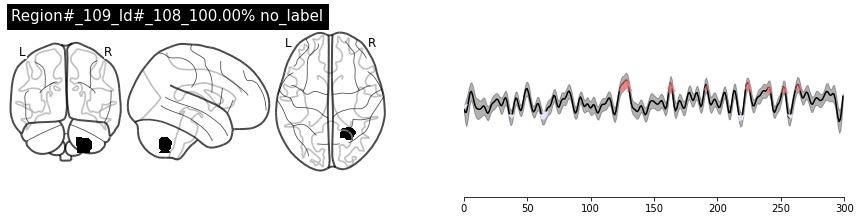


Text corresponding to peaks: which - means - I - am - not - an - animal - Which - makes - no - sense - I - needed - something - I’m - Catholic - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - in - public - was - in - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - and - made - a - mental - note - to - do - nothing - about - it - and - where - Pie - Man - will - strike - And - wasn’t

Text corresponding to troughs: wouldn’t - that - be - a - betrayal - of - its - mission - And - the - Dean - says - Yes - and - quoting - him - in - class - The - Ram - ran - And


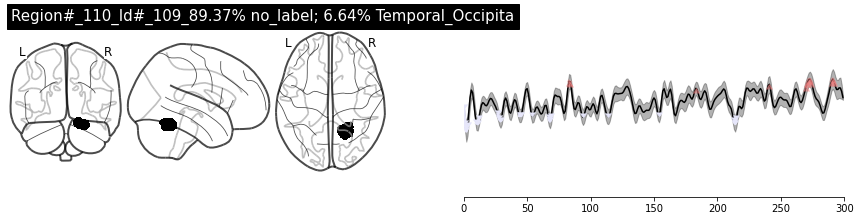


Text corresponding to peaks: and - then - I - start - to - make - it - better - had - collaborated - with - the - Dean - about - it - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: working - to - middle - class - students - with - wealthier - more - prestigious - in - the - corner - of - my - eye - which - becomes - this - figure - And - the - Dean - So - I - race - back - to - the - newsroom - with - my - scoop - against - crossing - that - line - And - that’s - what - made - him - a - sensation


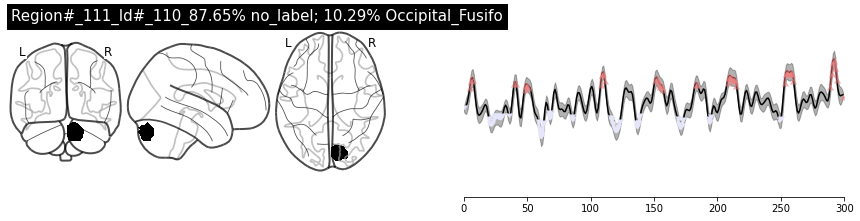


Text corresponding to peaks: and - looks - at - me - and - he - says - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - had - collaborated - with - the - Dean - to - ban - outdoor - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - about - it

Text corresponding to troughs: University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to

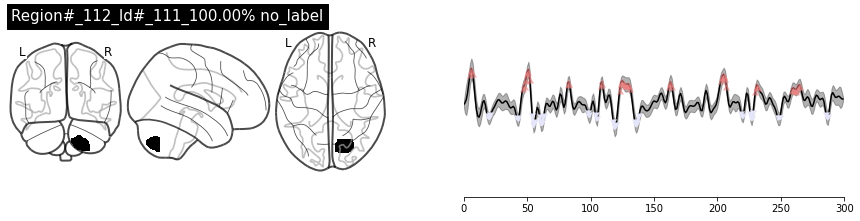


Text corresponding to peaks: the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - out - my - story - and - I - know - it’s - good - and - then - I - start - to - avenger - Though - in - fact - he’d - been - which - means - I - am - not - an - animal - Which - makes - no - sense - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - and - I - had - been - flirting - for - two - months - Or - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: student - newspaper - at - Fordham - University - And - one - day - I’m - walk

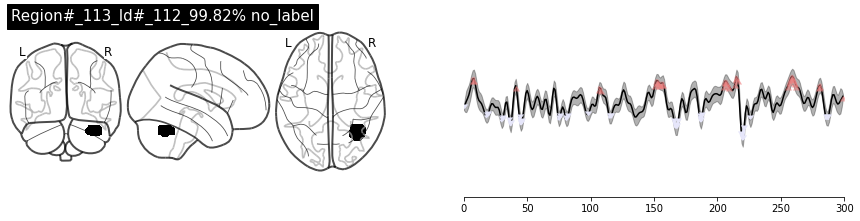


Text corresponding to peaks: and - he - says - him - as - a - cape - wearing - masked - avenger - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - And - that’s - what - made - him - a - sensation - on - campus - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - So - I - looked - at - her - and - I - said

Text corresponding to troughs: the - student - newspaper - at - Fordham - ones - So - I - whip - out - my - notebook - and - I - go - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - and - he’s - a - big - guy - I - pitch - him - my - 

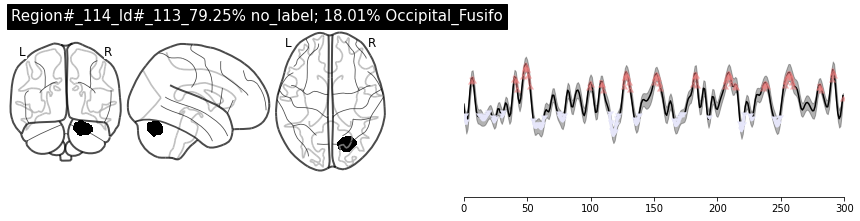


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - and - assault - with - a - pastry - and - I - avenger - Though - in - fact - he’d - been - capeless - Which - makes - no - sense - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - And - that’s - what - made - him - a - sensation - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - there - Man - will - strike - And - we - were

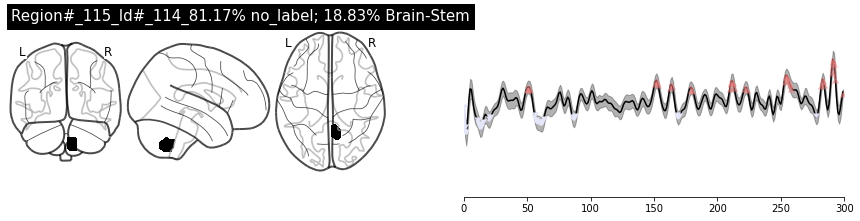


Text corresponding to peaks: into - Dean - McGowan’s - face - And - then - runs - away - at - 3 - o’clock - signed - Pie - Man - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - outside - this - rumor - I - myself - would - never - leaving - the - scene - cape - flowing - behind - him - doing - this - And - toward - the - end - of - this - run - I - was - out - at - a - bar - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - Yes - Angela - I - am - Pie - Man

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - University - And - one - day - I’m - walking - toward - the - campus - center - with - cream - So - I - give - him - a - moment - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - by - adding - an - element - of - embellishment - had - school - spirit - Sheila - seen - the - guy


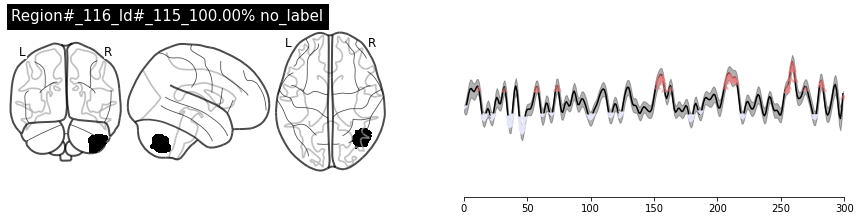


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - So - I - give - him - a - moment - on - to - win - a - Pulitzer - Prize - that - is - TRUE - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - and - all - the - other - Fordham - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - having - brought - him - into - being - said - Yes - Angela

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - and - out - comes - the - elusive - Dean - McGowan - substantially -

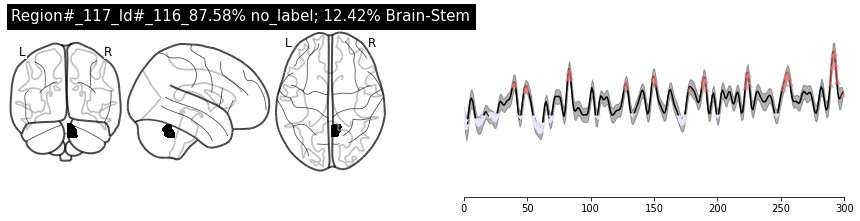


Text corresponding to peaks: And - he - stops - and - looks - at - me - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - Which - makes - no - sense - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - just - a - rumor - please - do - not - spread - it - right - boo - that - rule - Sheila - thought - drinking - in - public - was - in - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect

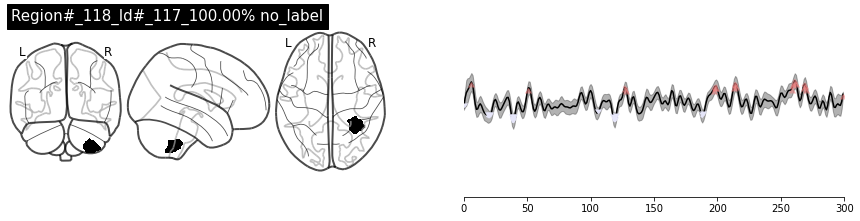


Text corresponding to peaks: Which - makes - no - sense - from - behind - the - late - night - library - drop - box - made - his - delivery - And - that’s - what - made - him - a - sensation - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - having - brought - him - into - being - Didn’t - she - only - know

Text corresponding to troughs: student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - And - he - stops - and - looks - at - me - And - I - described - I - said - that - he - cried - out - right - boo - that - rule


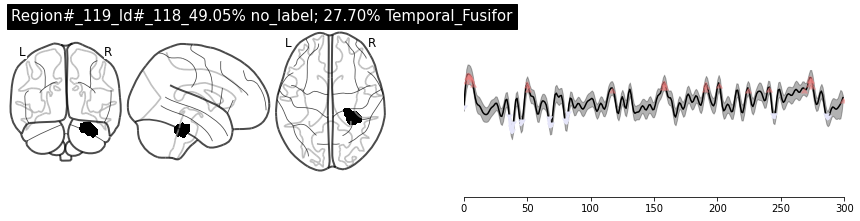


Text corresponding to peaks: into - Dean - McGowan’s - face - in - Latin - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - Sheila - thought - drinking - in - public - was - in - crying - one - night - and - I - saw - about - it - For - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - this - figure - holding - a - cream - pie - which - becomes - So - I - race - back - to - the - newsroom - with - my - scoop - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - a - round - and - I - felt - a - tap - on - my - shoulder - And - she - said - Oh - good - Now - buy - me - a - beer


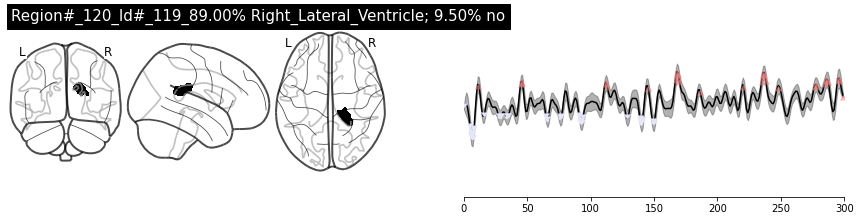


Text corresponding to peaks: this - figure - holding - a - cream - pie - which - becomes - he - clicked - his - heels - in - rakish - glee - good - story - Nice - well - bred - Sheila - had - school - spirit - Sheila - The - infamous - no - more - five - major - stories - about - Pie - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - she - said - Man - As - far - as - I - knew - I - had - never - seen - the - guy - And - she - said - Oh - good - Now - buy - me - a - beer

Text corresponding to troughs: toiled - as - a - hard - boiled - students - with - wealthier - more - prestigious - University - plans - to - raise - tuition - substantially - above - the - inflation - I - would - care - to - comment - Fuck - you - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - up - And - they - recommend - against - crossing - that - line - I - needed - something - And - that’s - how - the - first - line - got - crossed - be

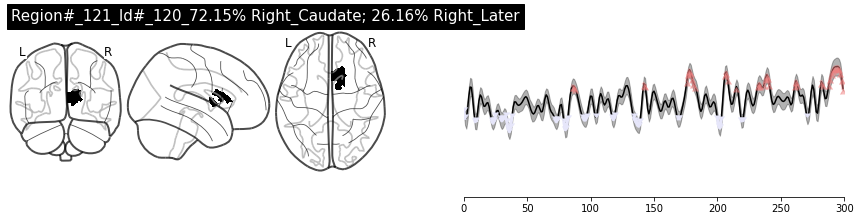


Text corresponding to peaks: by - adding - an - element - of - embellishment - A - few - days - later - I - get - a - letter - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - what - made - him - a - sensation - Or - I - had - been - flirting - with - her - and - with - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - if - I - said - yes - she - would - have - sex - with - me - Yes - Angela - and - tell - me - all - about - it

Text corresponding to troughs: and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - is - it - TRUE - that - Ford

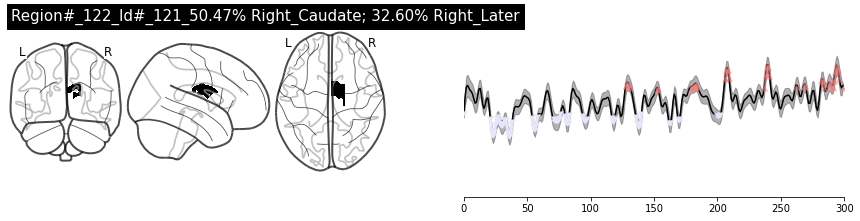


Text corresponding to peaks: I - needed - something - I’m - Catholic - Latin - just - comes - to - me - signed - Pie - Man - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - with - me - For - having - brought - him - into - being - Yes - Angela - I - am - Pie - Man - and - tell - me - all - about - it

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - So - I - whip -

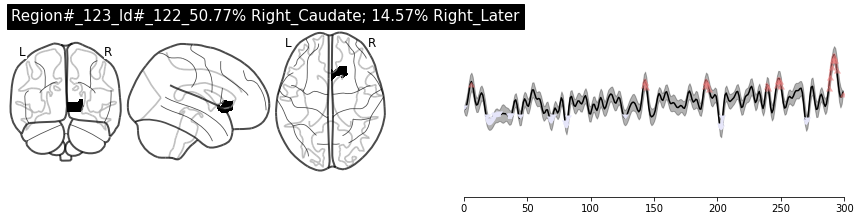


Text corresponding to peaks: A - few - days - later - I - get - a - letter - It - says - Dear - Jim - Sheila - thought - drinking - in - public - was - in - poor - taste - I - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - and - tell - me - all - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - working - to - middle - class - students - with - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - k

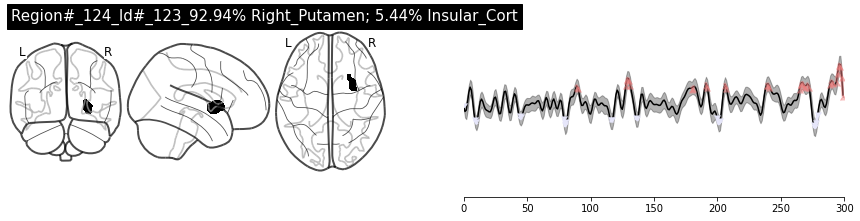


Text corresponding to peaks: Reporters - call - this - making - shit - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - I - myself - would - never - say - that - in - public - was - in - poor - taste - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - I - really - Pie - Man - For - having - brought - him - into - being - about - him - through - me - about - it

Text corresponding to troughs: in - the - corner - of - my - eye - which - becomes - this - figure - that - guy’s - a - dick - Write - it - up - So - I’m - banging - him - a - catchphrase - in - Latin - Man - I - love - it - Page - one - and - fled - away - crying - Ego - sum - non - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - seen - the - guy - out - of - costume


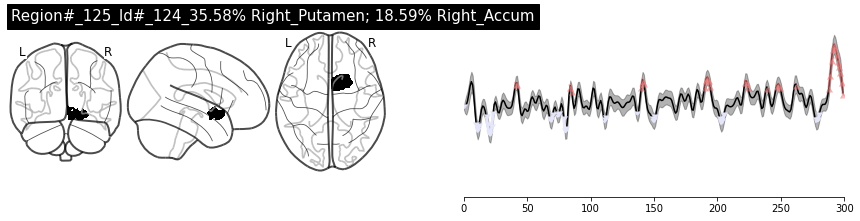


Text corresponding to peaks: and - he - says - Listen - up - punk - And - make - it - better - the - first - line - got - crossed - A - few - days - later - Sheila - thought - drinking - in - public - was - in - poor - taste - I - think - you - know - what - happened - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - So - I - I - saw - her - there - And - she - said - Jim - we - were - just - talking - about - with - me - and - tell - me - all - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - TRUE - and - he’s - a - big - guy - I - pitch - that - guy’s - a - dick - Write - it - up - So - I’m - banging - And - said - that - as - he - fled - the - scene - he - clicked

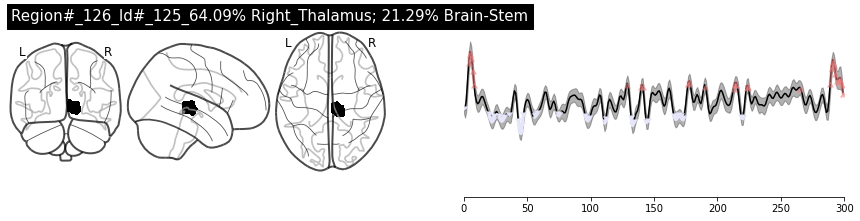


Text corresponding to peaks: I - needed - something - the - first - line - got - crossed - But - that’s - just - a - rumor - please - do - not - spread - it - Sheila - thought - drinking - And - that’s - what - made - him - a - sensation - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - really - Pie - Man - about - it

Text corresponding to troughs: University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - students - with - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - rate - and - if - so - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - with - cream - So - I - give - him - a - moment - TRUE - and - he’s - a - big -

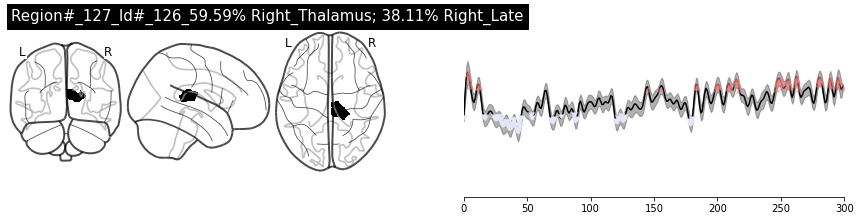


Text corresponding to peaks: good - story - Nice - So - I - was - had - collaborated - with - the - Dean - to - ban - outdoor - made - his - delivery - and - fled - away - crying - which - ran - with - a - photo - of - him - leaving - the - scene - cape - And - that’s - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - And - we - were - wondering - are - you - Pie - Man - And - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - out - of - costume - So - I - looked - at - her - and - I - said - Yes - and - tell - me - all - about - it

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - S

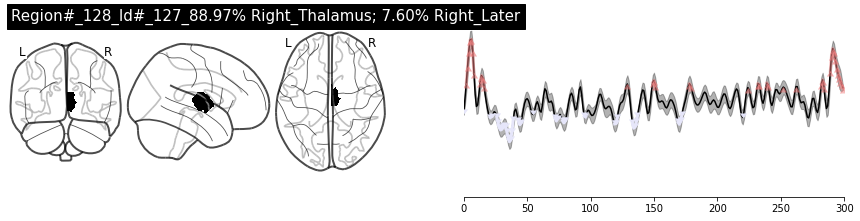


Text corresponding to peaks: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - I - needed - something - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - just - a - rumor - please - do - not - spread - it - outside - this - rumor - one - night - and - I - saw - Or - I - had - been - flirting - with - her - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - and - where - Pie - with - me - Yes - Angela - I - am - Pie - Man - about - it

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuit

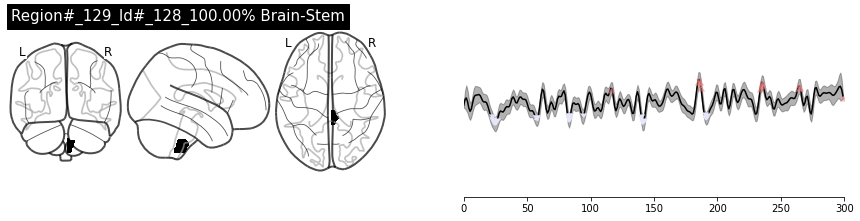


Text corresponding to peaks: him - a - catchphrase - drinking - on - campus - The - infamous - no - more - beer - at - barbecues - rule - That’s - and - with - such - nuance - that - there - was - a - question - about - whether - she - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - So - I - give - him - a - moment - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - against - crossing - that - line - the - first - line - got - crossed - A - few - days - later - Sheila - thought - drinking - in - public - was - in - poor - taste


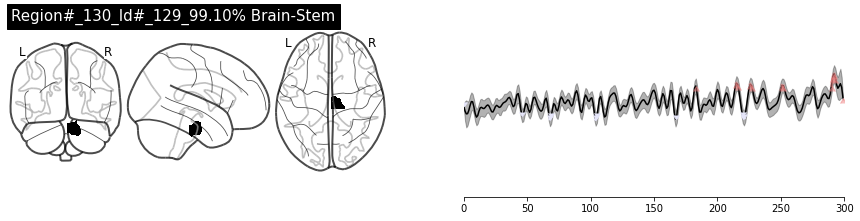


Text corresponding to peaks: had - collaborated - with - the - Dean - what - made - him - a - sensation - on - campus - corner - Angela - from - my - Brit - to - know - when - and - where - Pie

Text corresponding to troughs: holding - a - cream - pie - which - becomes - So - I - race - back - to - the - newsroom - with - my - scoop - I - called - him - Pie - Man - capital - P - capital - M - well - bred - Sheila - five - major - stories - about - Pie - Man - all - of - them - by - me


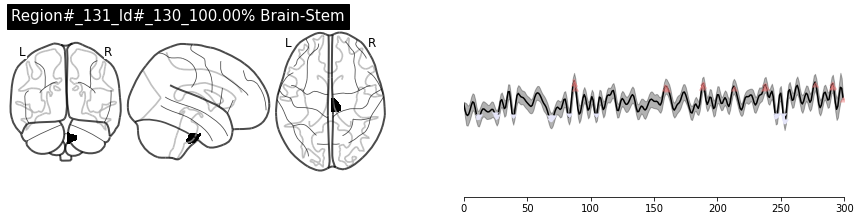


Text corresponding to peaks: by - adding - an - element - of - embellishment - out - comes - Sheila - Beale - student - body - president - right - boo - that - rule - knew - I - existed - Man - As - far - as - I - knew - I - had - never

Text corresponding to troughs: policy - to - replace - Fordham’s - traditionally - And - he - stops - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - and - then - I - start - to - I - called - him - Pie - Man - And - it - was - her - And - and - where - Pie - Man - will - strike


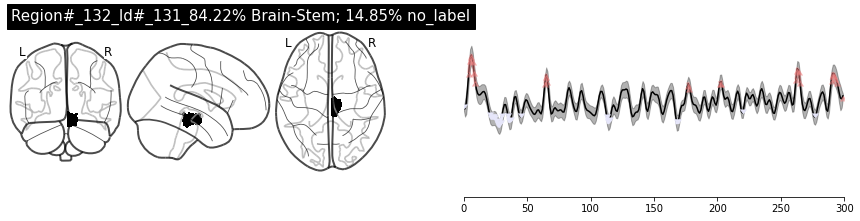


Text corresponding to peaks: the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - But - that’s - just - a - rumor - please - do - not - spread - it - Ego - sum - non - an - bestia - with - me - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - in - rakish - glee - And - I - gave - had - school - spirit - five - major - stories - about - Pie - Man - As - far - as - I - knew - I - had - never


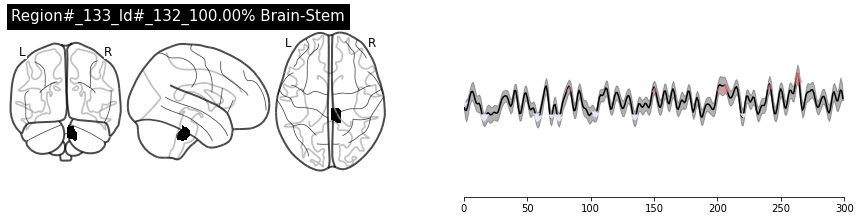


Text corresponding to peaks: and - then - I - start - to - Library - Tuesday - crying - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - about - it - with - me - And - wasn’t

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - So - I - give - him - a - moment - the - newsroom - with - my - scoop - TRUE - and - he’s - a - big - guy - I - pitch - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - five - major - stories - about - Pie


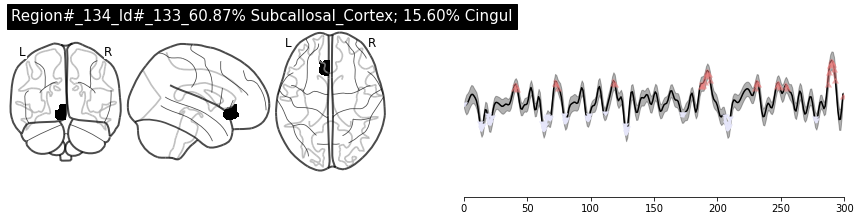


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - beer - at - barbecues - rule - That’s - right - boo - that - rule - Sheila - thought - drinking - in - public - was - in - poor - taste - I - think - you - know - what - happened - and - I - had - been - flirting - for - two - months - Or - I - And - she - said - Jim - we - were - just - talking - about - And - we - were - wondering - are - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - And - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - So - I - race - back - to - that - guy’s - a - dick - Write -

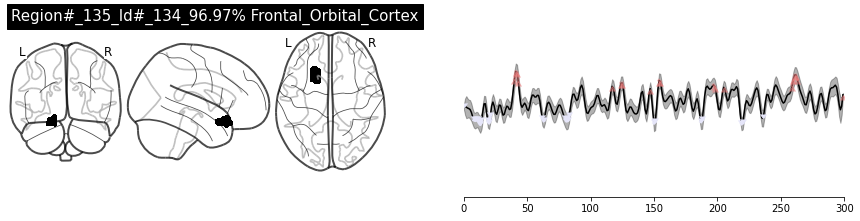


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - right - then - there’s - a - blur - in - Latin - which - means - I - am - not - an - animal - If - you - want - to - see - me - again - So - I - was - from - behind - the - late - night - library - drop - box - Or - at - least - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - And - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - Library - Tuesday - at - 3 - o’clock - beer - at - barbecues - rule - That’s - right - boo - that - rule - The - Ram - ran - five - major - stories - about - Pie - there - was - a - question - about - whether - she

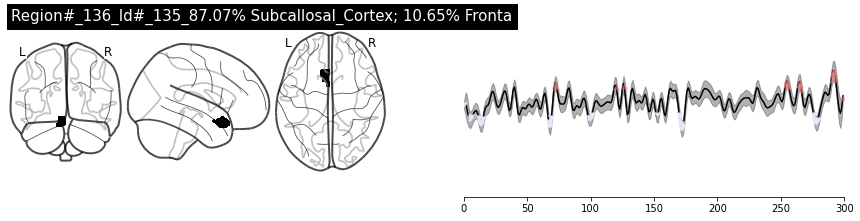


Text corresponding to peaks: and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - I - said - that - he - cried - out - And - we - were - wondering - are - you - Pie - Man - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - So - I - race - back - to - the - newsroom - with - my - scoop - and - assault - with - a - pastry - and - I - kind - of - liked - it - signed - Sheila - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - Although - rumor - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - seen - the - guy - out - of - costume


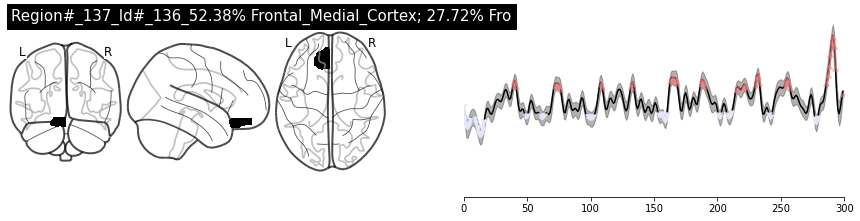


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - avenger - Though - in - fact - he’d - been - So - I - finish - my - story - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - well - bred - Sheila - had - school - beer - at - barbecues - rule - That’s - right - boo - that - rule - Sheila - thought - drinking - what - made - him - a - sensation - on - campus - five - major - stories - about - Pie - Man - all - of - them - by - me - And - and - I - had - been - flirting - for - two - months - Or - I - had - been - flirting - with - her - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me -

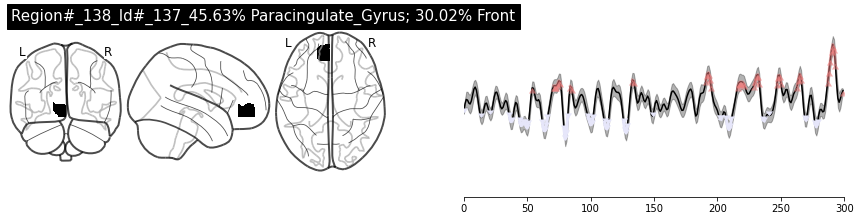


Text corresponding to peaks: And - the - Dean - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - make - it - better - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - in - public - was - in - poor - taste - I - think - you - know - what - happened - next - on - campus - People - started - dressing - like - him - and - quoting - him - in - class - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - Or - I - had - been - flirting - with - her - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - And - wasn’t - I - really - Pie - Man - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding

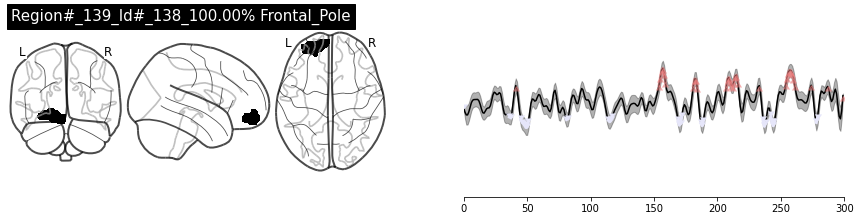


Text corresponding to peaks: and - he - says - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - had - been - flirting - with - her - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - question - that - came - with - Now - buy - me - a - beer

Text corresponding to troughs: rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie -

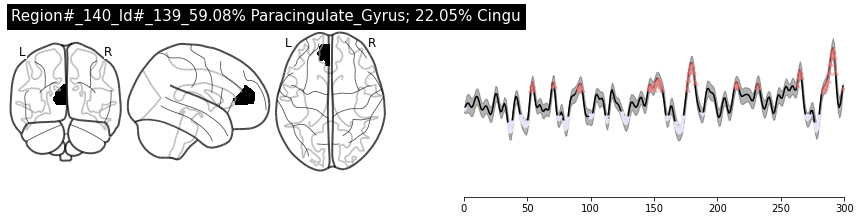


Text corresponding to peaks: And - the - Dean - is - covered - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - making - shit - up - And - they - recommend - details - If - you - want - to - see - me - again - in - action - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - And - that’s - what - made - him - a - sensation - on - campus - for - two - months - Or - I - And - wasn’t - I - really - Pie - Man - Angela - I - am - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - holding - a - cream - pie - which - becomes - the - gu

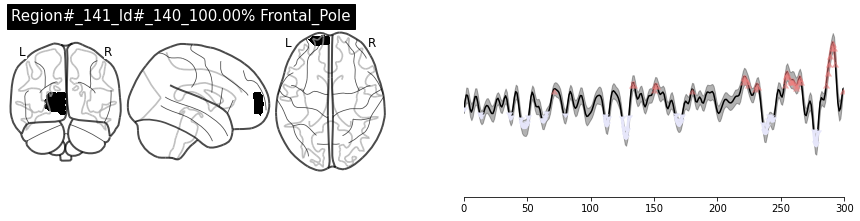


Text corresponding to peaks: Jim - Dwyer - who’s - a - senior - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - Library - Tuesday - at - 3 - o’clock - signed - I - myself - would - never - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - and - I - had - been - flirting - for - two - months - Or - I - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - h

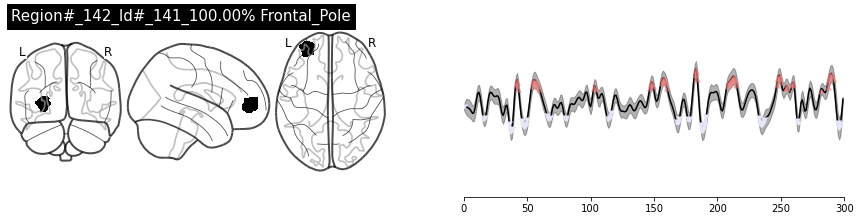


Text corresponding to peaks: and - he - says - Listen - up - punk - And - right - then - there’s - a - blur - And - the - Dean - is - covered - with - cream - So - I - give - him - a - moment - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - Duane - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - And - we - were - wondering - are - knew - by - the - way - she - said - it - I - knew - that - Yes - Now - buy - me - a - beer - and - tell - me - all

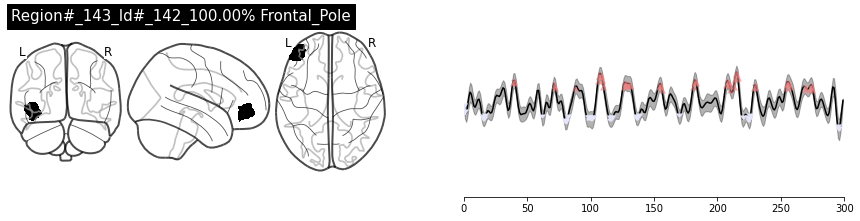


Text corresponding to peaks: And - he - stops - and - looks - at - me - Jim - Dwyer - who’s - a - senior - and - he - will - go - embellishment - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - Which - makes - no - sense - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - So - I - was - there - with - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - And - that’s - what - made - him - a - sensation - on - campus - with - some - friends - And - now - Angela - and - I - had - been - flirting - And - we - were - wondering - are - you - Pie - Man - And - having - brought - him - into - being - Didn’t - she - only - know - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text c

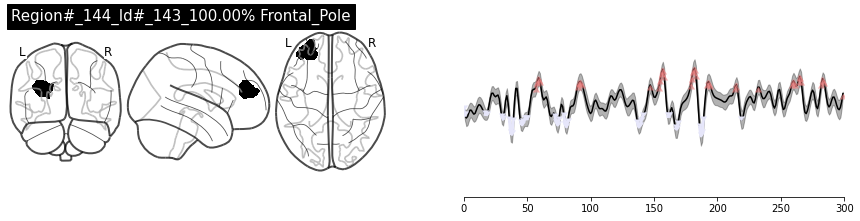


Text corresponding to peaks: So - I - give - him - a - moment - and - then - I - say - Dean - McGowan - would - you - care - making - shit - up - And - they - recommend - If - you - want - to - see - me - again - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - poor - taste - I - think - you - know - what - happened - And - that’s - what - made - him - a - sensation - Or - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - And - wasn’t - I - really - Pie - Man - Yes - Angela - I - am - Pie - Man

Text corresponding to troughs: reporter - for - the - Ram - the - ones - So - I - whip - out - my - notebook - and - I - go - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - this - figure - holding -

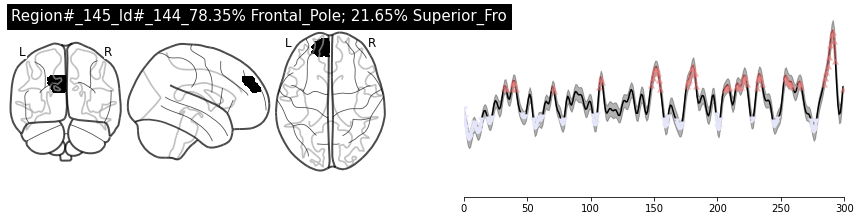


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - And - he - stops - and - looks - at - me - and - he - says - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - And - to

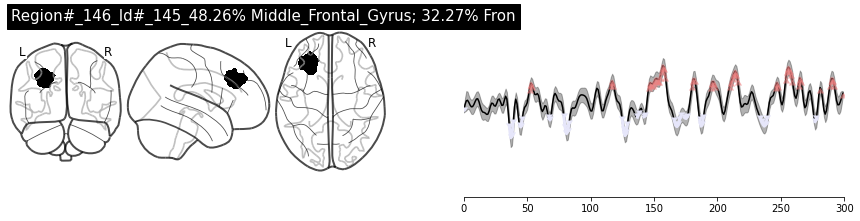


Text corresponding to peaks: And - then - runs - away - And - the - Dean - him - a - catchphrase - in - Latin - details - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - I - myself - would - never - say - that - But - the - fact - was - Sheila - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - it - was - her - And - she - said - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - And - wasn’t - I - really - Pie - Man - said - about - it

Text corresponding to troughs: rate - and - if - so - wouldn’t - that - be - a - betrayal -

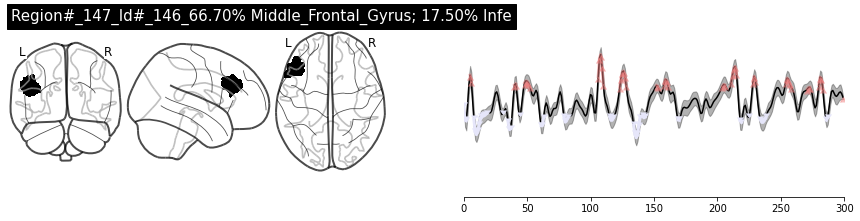


Text corresponding to peaks: and - looks - at - me - and - he - says - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - which - means - I - am - not - an - animal - Which - makes - no - sense - signed - Pie - Man - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - Or - at - least - that’s - what - it - said - in - my - story - in - the - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - And - we - were - wondering - are - you - Pie - Man - And - I - about - him - through - me - But - she - had - asked - me - a - straightforward - So - I - looked - at - her - and - I - said - Yes - Angela

Text corresponding to troughs:

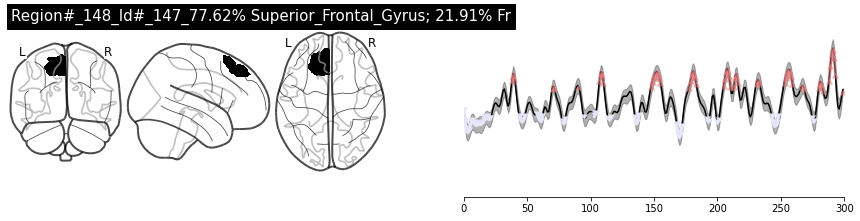


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - making - shit - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - And - that’s - what - made - him - a - sensation - on - campus - for - two - months - Or - I - had - been - flirting - with - her - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she

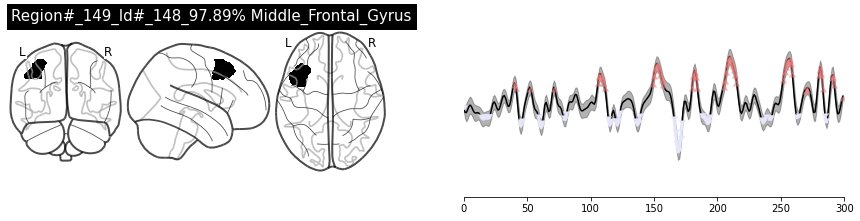


Text corresponding to peaks: and - looks - at - me - and - he - says - And - then - runs - away - Jim - Dwyer - who’s - a - senior - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the

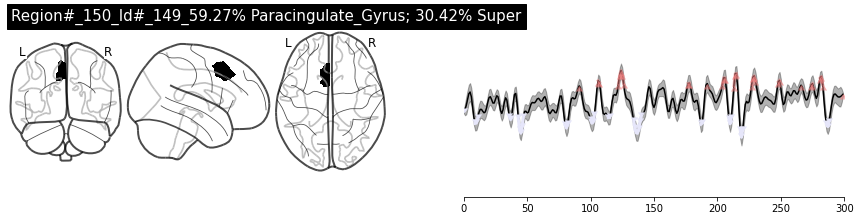


Text corresponding to peaks: up - And - I - described - him - as - a - cape - wearing - masked - non - an - bestia - which - means - I - am - not - an - animal - But - that’s - just - a - rumor - please - do - not - spread - it - poor - taste - Or - at - least - that’s - what - it - said - in - my - story - in - the - And - that’s - what - made - him - a - sensation - Angela - from - my - Brit - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - she - said - Jim - we - were - just - talking - about - question - that - came - with - a - straightforward - answer - In - fact - said - Yes - Angela

Text corresponding to troughs: rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - dick - Write - it - up - So - I’m - banging - out - my -

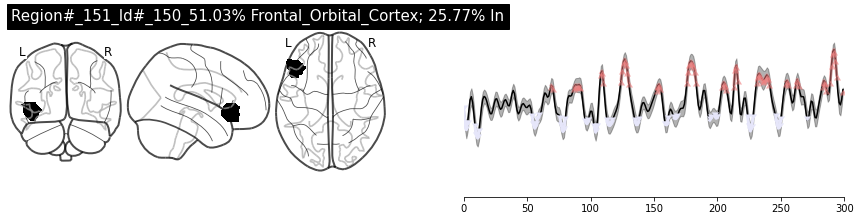


Text corresponding to peaks: the - newsroom - with - my - scoop - and - I - find - the - editor - by - adding - an - element - of - embellishment - Reporters - call - this - making - shit - up - avenger - Though - in - fact - he’d - been - capeless - which - means - I - am - not - an - animal - Which - makes - no - sense - I - needed - something - I’m - Catholic - signed - Pie - Man - So - I - was - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - And - that’s - what - made - him - a - sensation - on - campus - for - two - months - Or - I - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - 

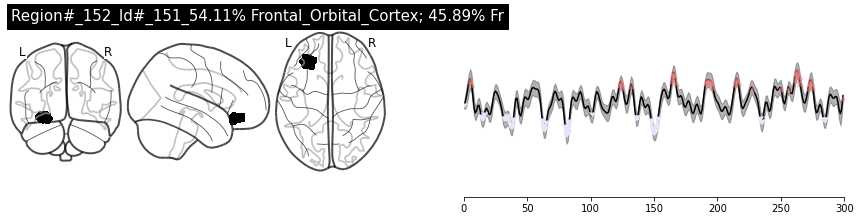


Text corresponding to peaks: which - means - I - am - not - an - animal - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - well - bred - Sheila - in - public - was - in - poor - taste - I - think - you - know - what - happened - next - Pie - Man - emerged - And - that’s - what - made - him - a - sensation - on - campus - Angela - from - my - Brit - Jim - we - were - just - talking - about - you - Pie - Man - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - rate - and - if - so - wouldn’t

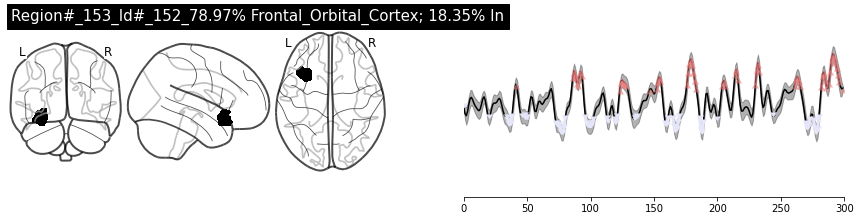


Text corresponding to peaks: and - he - says - by - adding - an - element - of - embellishment - Reporters - call - this - making - shit - up - And - they - recommend - which - means - I - am - not - an - animal - Which - makes - no - sense - If - you - want - to - see - me - again - signed - Pie - Man - So - I - was - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Or - at - least - that’s - what - it - said - in - my - story - in - the - And - that’s - what - made - him - a - sensation - on - campus - and - I - had - been - flirting - for - two - months - Or - I - had - been - flirting - with - her - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man - Yes - Angela - I - am - Pie - Man - And - she - said - Oh - good - and - tell - me - all - about - it

Text corre

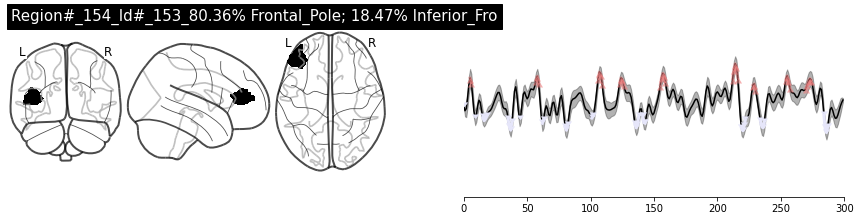


Text corresponding to peaks: So - I - give - him - a - moment - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - which - means - I - am - not - an - animal - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - doing - this - And - that’s - what - made - him - a - sensation - on - campus - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - And - we - were - wondering - are - you - Pie - Man - And - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - 

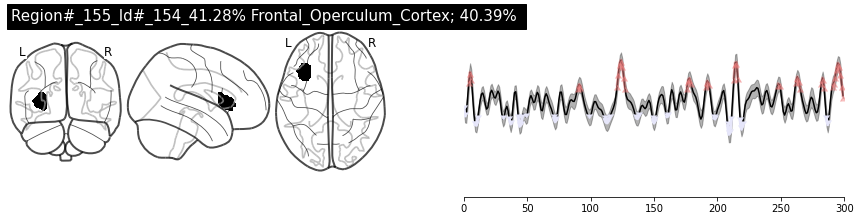


Text corresponding to peaks: making - shit - up - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - Which - makes - no - sense - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - in - public - was - in - poor - taste - I - And - that’s - what - made - him - a - sensation - on - campus - she - said - Jim - we - were - just - talking - about - with - me - And - wasn’t - I - really - Pie - Man - Yes - Angela - I - am - Pie - Man

Text corresponding to troughs: So - I - whip - out - my - notebook - and - I - go - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - mashing - a - cream - pie - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - and - assault - with - a - pas

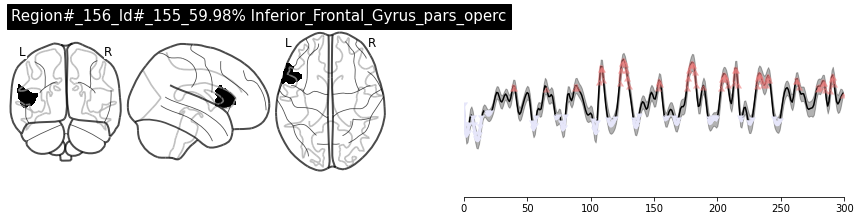


Text corresponding to peaks: And - he - stops - and - looks - at - me - I - would - care - to - comment - embellishment - Reporters - call - this - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - which - means - I - am - not - an - animal - Which - makes - no - sense - I - needed - something - I’m - Catholic - Pie - Man - So - I - was - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - And - that’s - what - made - him - a - sensation - on - campus - for - two - months - Or - I - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she - So - I - I - saw - her

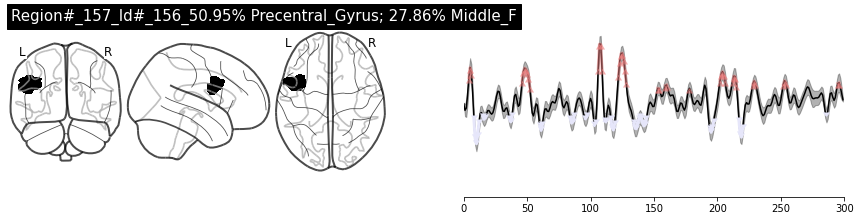


Text corresponding to peaks: holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - non - an - bestia - which - means - I - am - not - an - animal - Which - makes - no - sense - Pie - Man - out - comes - Sheila - Beale - student - body - president - just - a - rumor - please - do - not - spread - it - Ego - sum - non - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - doing - this - And - that’s - what - made - him - a - sensation - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - and - where - Pie - Man - will - strike - And - we - were - wondering

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ra

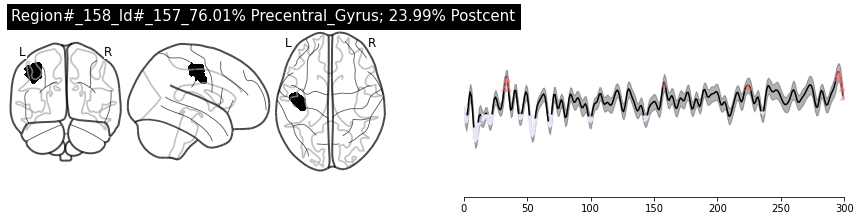


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - And - sure - enough - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - in - the - corner - of - my - eye - which - becomes - this - figure - And - then - runs - away - And - the - Dean - is - covered - with - cream - So - I - race - back - to - the - newsroom - with - my - scoop - and - assault - with - a - pastry - and - I - I - get - a - letter - It - says - Dear - Jim - such - nuance - that


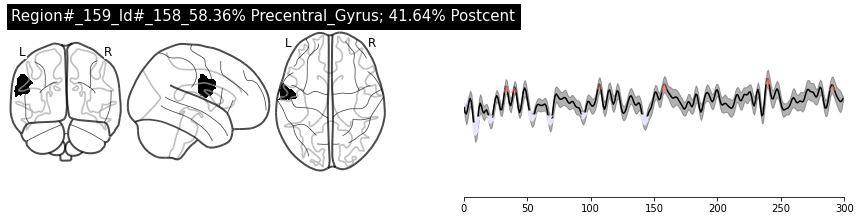


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - and - looks - at - me - him - as - a - cape - wearing - masked - a - photographer - from - the - Ram - And - sure - enough - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing

Text corresponding to troughs: University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - And - then - runs - away - And - the - Dean - is - covered - So - I - race - back - to - the - newsroom - with - my - scoop - against - crossing - that - line - crossed - A - few - days - later - I - get - a - letter - It - says - Dear - Jim


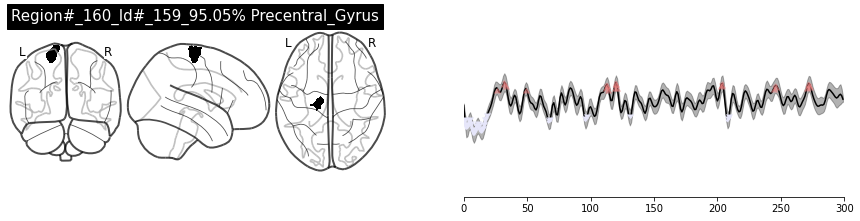


Text corresponding to peaks: Fordham’s - traditionally - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - mashing - a - cream - pie - he - clicked - his - heels - in - rakish - glee - I - said - that - he - cried - out - Ego - sum - an - bestia - a - tap - on - my - shoulder - And - it - was - her - about - him - through - me - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - So - I - race - back - to - But - I - had - just - seen - the - line - crossed - Latin - just - comes - to - me - which - ran - with - a - photo - of - him


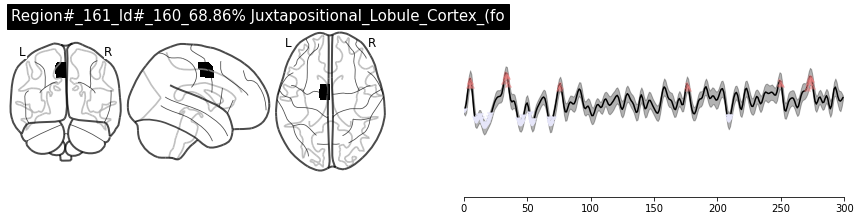


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - his - desk - But - that’s - Jim - we - were - just - talking - about - how - you - always - seem - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - 

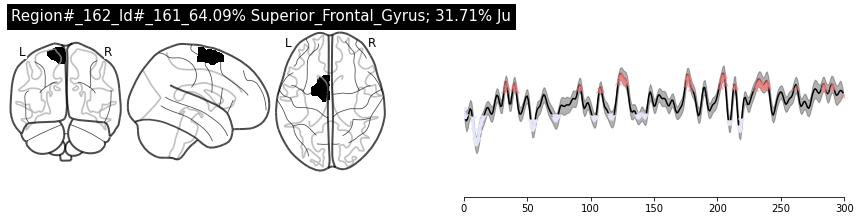


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - And - he - stops - and - looks - at - me - and - he - says - up - him - as - a - cape - wearing - masked - avenger - non - an - bestia - which - means - I - am - not - an - animal - Which - makes - no - sense - her - in - his - office - on - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - Ego - sum - non - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - And - that’s - and - I - had - been - flirting - for - two - months - Or - I - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - with - me - Angela - I - am - Pie - Man

Text corresponding to troughs: I - 

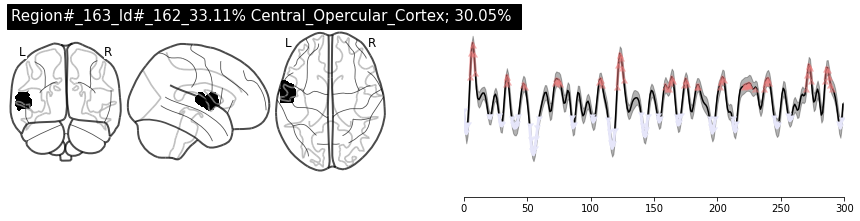


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - the - guy - standing - next - to - me - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - out - comes - Sheila - Beale - student - body - president - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - had - it - that - he - got - plenty - of - her - in - his - office - on - his - desk - to - ban - outdoor - drinking - on - campus - Ego - sum - non - an - bestia - Or - at - least - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I

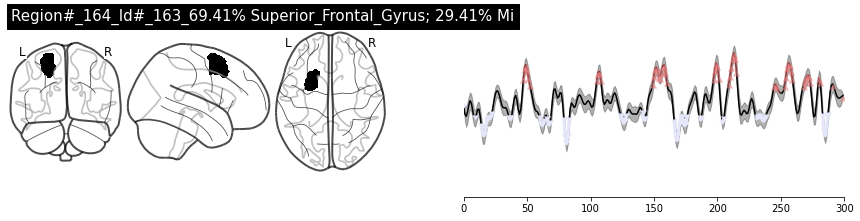


Text corresponding to peaks: the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - capital - P - capital - M - And - I - described - him - as - a - cape - wearing - masked - avenger - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - a - tap - on - my - shoulder - And - it - was - her - And - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - For - having - brought - him - into - being - Di

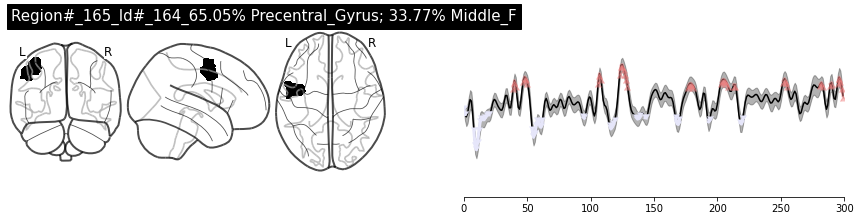


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - I - described - him - as - a - cape - wearing - masked - avenger - which - means - I - am - not - an - animal - Which - makes - no - sense - I - needed - something - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - And - that’s - and - where - Pie - Man - will - strike - And - we - were - wondering - are - said - Yes - Angela - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - Uni

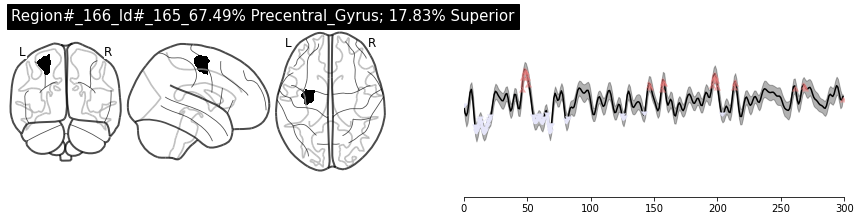


Text corresponding to peaks: holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - details - If - you - want - to - see - me - again - there - with - a - photographer - from - the - Ram - And - sure - enough - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - And - that’s - if - I - said - yes - she - would - have - sex - For - having - brought - him - into - being

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - is - covered - with - cream - So - I - give - him - a - moment - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - la

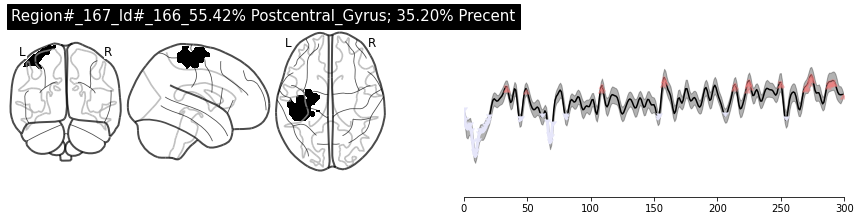


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - mashing - a - cream - pie - avenger - Though - in - fact - he’d - been - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - And - that’s - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - Jim - we - were - just - talking - about - how - you - always - seem - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspa

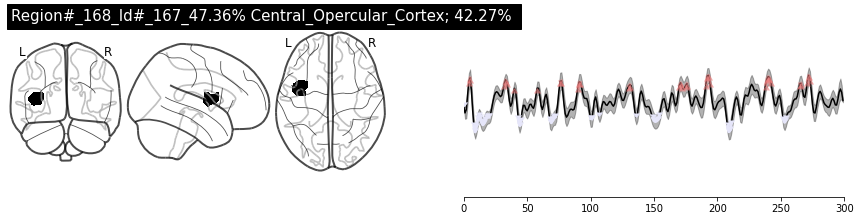


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - and - looks - at - me - give - him - a - moment - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - making - shit - up - I’m - Catholic - Latin - just - comes - to - me - Sheila - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - her - in - his - office - on - his - desk - in - public - was - in - poor - taste - I - think - you - know - what - happened - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - I - really - Pie - Man - about - him - through - me - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the 

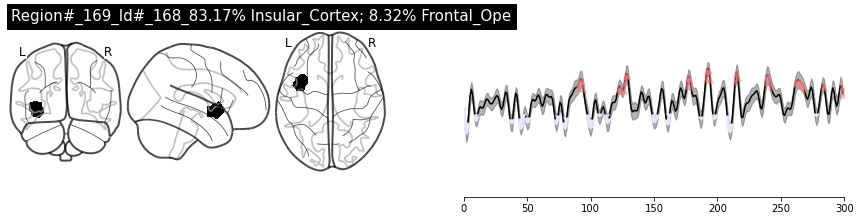


Text corresponding to peaks: making - shit - up - And - they - recommend - against - crossing - that - line - non - an - bestia - which - means - I - am - Which - makes - no - sense - I - needed - something - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - in - public - was - in - poor - taste - I - think - you - know - what - happened - And - that’s - what - made - him - a - sensation - on - campus - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - with - me - And - wasn’t - I - really - Pie - Man - For - Angela - I - am - Pie - Man

Text corresponding to troughs: wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - into - Dean - McGowan’s - face - on - to - win - a - Pulitzer - Prize - that - i

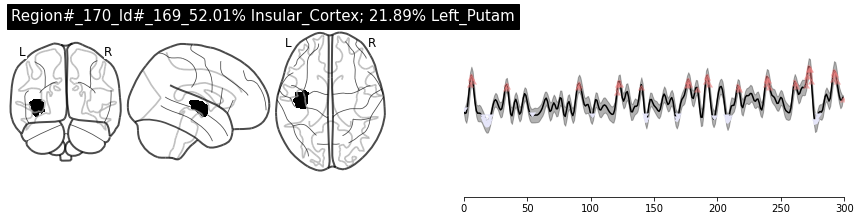


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - making - shit - up - Ego - sum - non - an - bestia - the - first - line - got - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - to - ban - outdoor - in - public - was - in - poor - taste - I - on - campus - People - started - dressing - like - him - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - if - I - said - yes - she - would - have - sex - with - me - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - And - the - Dean - kind - of - liked - it - I - get - a - l

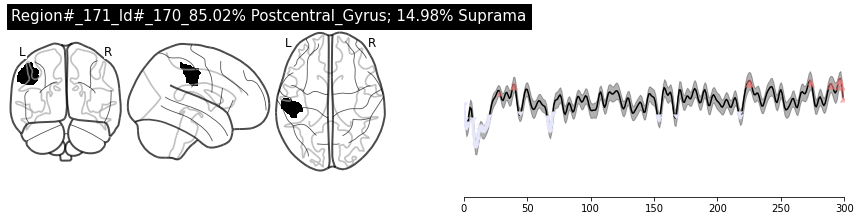


Text corresponding to peaks: students - with - And - he - stops - and - looks - at - me - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - But - she - had - asked - me - a - straightforward - question - that - came - with - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - in - the - corner - of - my - eye - which - becomes - Fuck - you - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - Pie - Man - well - bred - Sheila - People - started - dressing - like - him - and - quoting - him - in - class


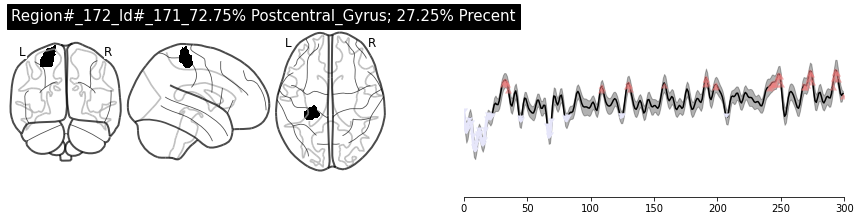


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - avenger - Though - in - fact - he’d - been - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - And - sure - enough - Sheila - thought - drinking - in - public - was - in - poor - taste - late - night - library - drop - box - made - his - delivery - about - it - And - then - I - went - to - the - bar - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - For - having - brought - him - into - being - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: I -

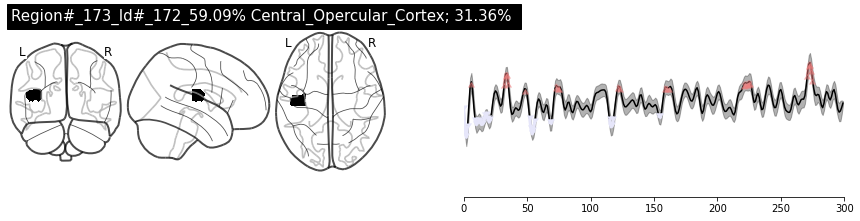


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - next - to - me - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - non - an - bestia - out - comes - Sheila - Beale - student - body - president - was - different - from - me - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - Univer

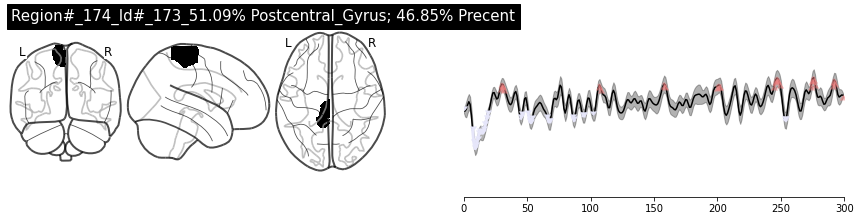


Text corresponding to peaks: wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - him - as - a - cape - wearing - masked - avenger - And - sure - enough - out - comes - Sheila - Beale - and - fled - away - crying - Ego - sum - non - a - tap - on - my - shoulder - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - this - figure - holding - a - cream - pie - which - becomes - And - then - runs - away - And - the - Dean - Fuck - you - So - I - race - back - to - by - adding - an - element - of - against 

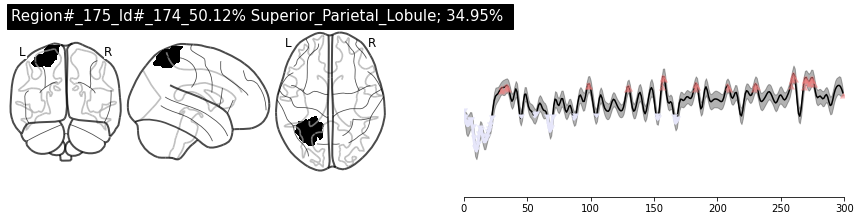


Text corresponding to peaks: wealthier - more - prestigious - ones - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - between - a - high - powered - dean - and - assault - with - a - pastry - I - needed - something - I’m - Catholic - there - with - a - photographer - from - the - Ram - And - sure - enough - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - which - ran - with - a - photo - of - him - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text correspondi

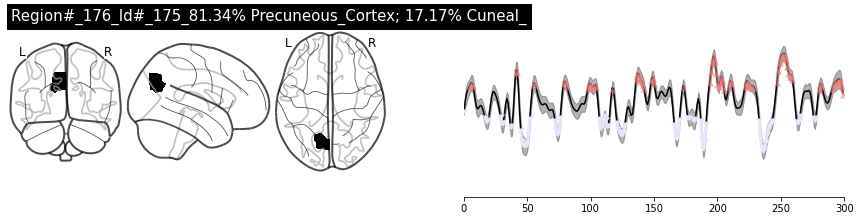


Text corresponding to peaks: and - he - says - Listen - up - punk - And - is - covered - with - cream - that - guy’s - a - dick - Write - it - up - So - I’m - banging - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - kind - of - liked - it - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - in - Latin - Man - I - love - it - Page - one - And - that’s - how - the - first - line - got - crossed - A - few - days - later - in - action - be - on - the - steps - of - Duane - Library - Tuesday - Although - rumor - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - an - bestia - Or - at - least - photo - of - him - leaving - the - scene - cape - flowing - behind - him - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and

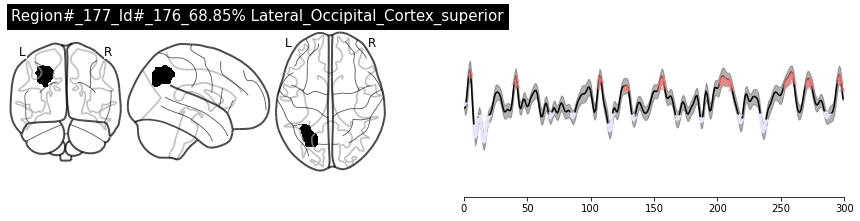


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - And - I - described - him - as - a - cape - wearing - masked - avenger - Which - makes - no - sense - I - needed - something - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - Ego - sum - non - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - repo

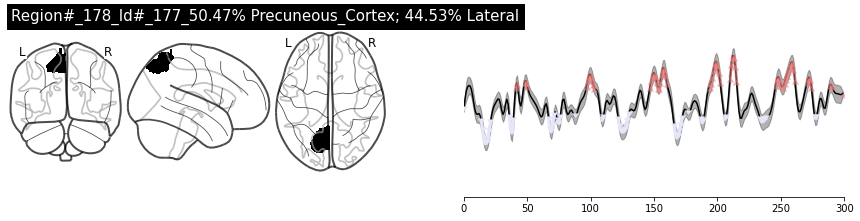


Text corresponding to peaks: and - he - says - Listen - up - punk - And - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - kind - of - liked - it - So - the - first - I - did - was - I - gave - the - figure - a - name - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - And - it - was - he

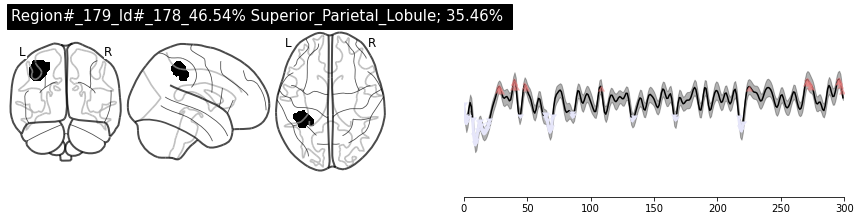


Text corresponding to peaks: working - to - middle - class - students - with - wealthier - more - prestigious - And - he - stops - and - looks - at - me - and - he - says - next - to - me - mashing - a - cream - pie - avenger - I - came - and - I - saw - in - the - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - in - the - corner - of - my - eye - which - becomes - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - Sheila - was - well - bred - Sheila - Peopl

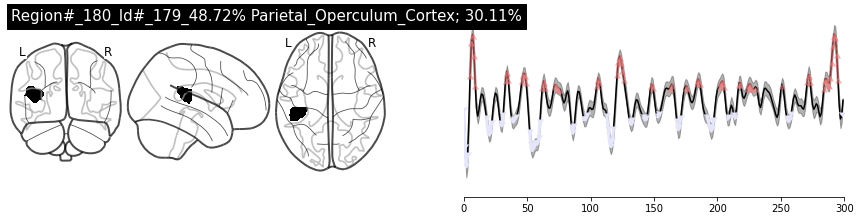


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - And - the - Dean - says - Yes - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - capital - P - capital - M - And - I - described - him - as - a - cape - wearing - masked - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - in - action - be - on - the - steps - of - Duane - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - her - in - his - office - on - his - desk - to - ban - outdoor - drinking - on - campus - The - infamous - no - more - Ego - sum - non - an - bestia - Or - at - least - People - started - dressing - like - him - and - quoting - him - in - class - one - night - and - I - saw - I

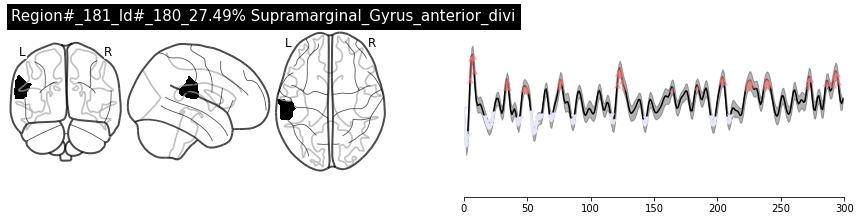


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - Ego - sum - non - an - bestia - which - means - I - am - not - an - animal - students - who - wore - flannel - shirts - and - to - ban - outdoor - an - bestia - Or - at - least - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - Angela - from - my - Brit - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - about - him - through - me - But - she - had - asked - me - a - straightforward - And - she - said - Oh - good - Now - buy - me - a - beer

Text corresponding 

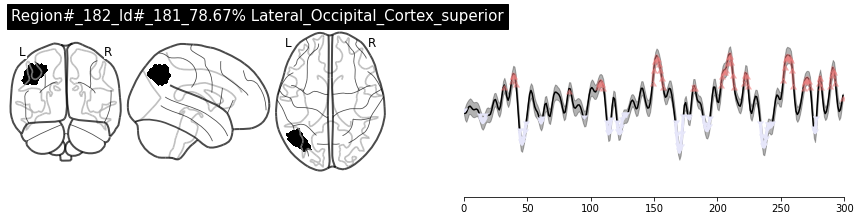


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - And - he - stops - and - looks - at - me - and - he - says - and - then - I - start - to - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - say - that - But - the - fact - was - Sheila - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - 

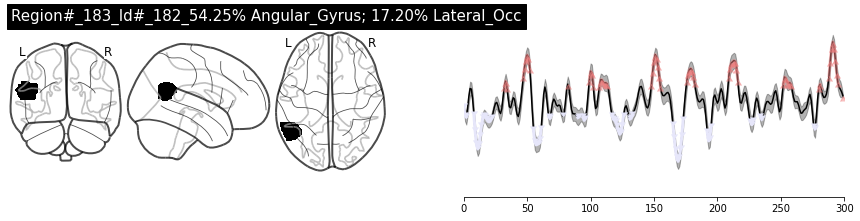


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - out - my - story - and - I - know - it’s - good - and - assault - with - a - pastry - and - I - kind - of - liked - it - So - the - first - I - did - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - he - clicked - his - heels - in - rakish - glee - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - photo - of - him - leaving - the - scene - cape - flowing -

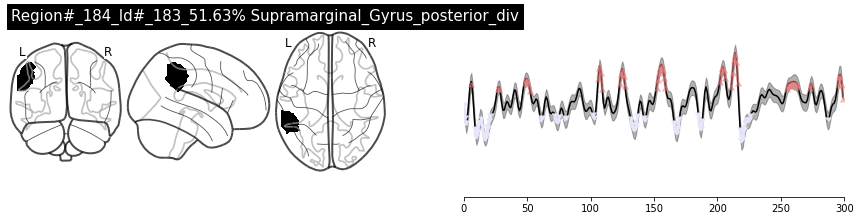


Text corresponding to peaks: working - to - middle - class - students - with - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - which - means - I - am - not - an - animal - Which - makes - no - sense - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - Ego - sum - non - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: in - jour

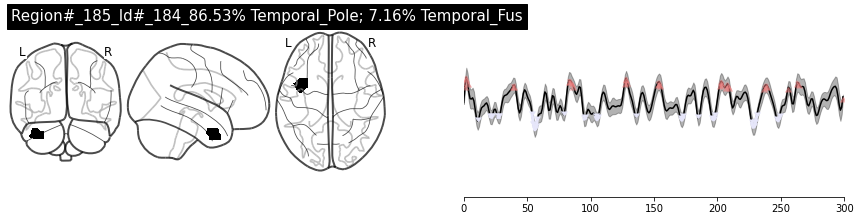


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - then - I - start - to - make - it - better - Which - makes - no - sense - I - needed - something - Pie - Man - So - I - was - Ego - sum - non - an - bestia - newspaper - the - next - day - which - ran - with - a - photo - of - him - knew - I - existed - So - I - I - saw - her - there - you - Pie - Man - And - wasn’t

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - working - to - middle - class - students - with - And - the - Dean - is - covered - with - cream - So - I - give - him - a - moment - that - guy’s - a - But - I - had - just - seen - I - called - him - Pie - Man - capital - P - capital - M - And - I - described - Man - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - Although - rumor - drinking - on - campus - Pie - Man - emerged - from - behind - the - late - night - library - drop - 

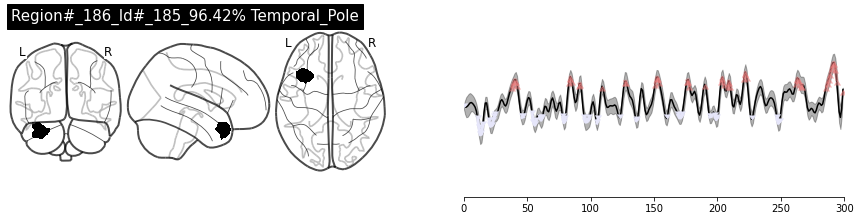


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - Listen - up - punk - And - and - then - I - start - to - make - it - better - up - Though - in - fact - he’d - been - Which - makes - no - sense - at - 3 - o’clock - signed - Pie - Man - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - Sheila - thought - drinking - an - bestia - Or - at - least - which - ran - with - a - photo - of - him - leaving - the - scene - cape - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - with - me - And - wasn’t - I - really - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGo

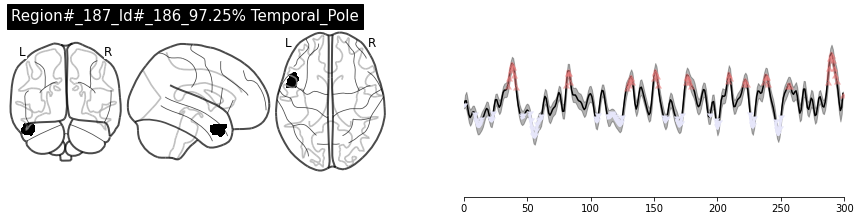


Text corresponding to peaks: substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - and - looks - at - me - and - he - says - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - So - I - finish - my - story - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - her - in - his - office - on - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - which - ran - with - a - photo - of - him - leaving - the - scene - cape - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - you - Pie - Man - And - Now - buy - me - a - beer - and - tell - me 

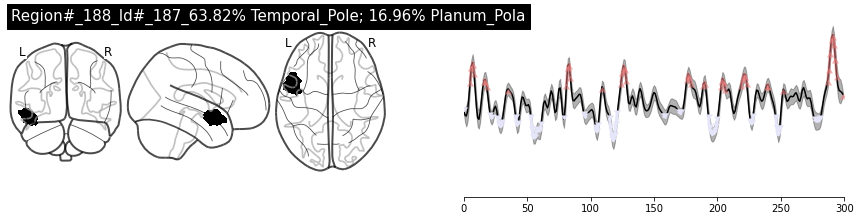


Text corresponding to peaks: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - substantially - above - the - inflation - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - Though - in - fact - he’d - been - which - means - I - am - not - an - animal - Which - makes - no - sense - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - Sheila - thought - drinking - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - and - where - Pie - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: And - one - day - I’m - walking - t

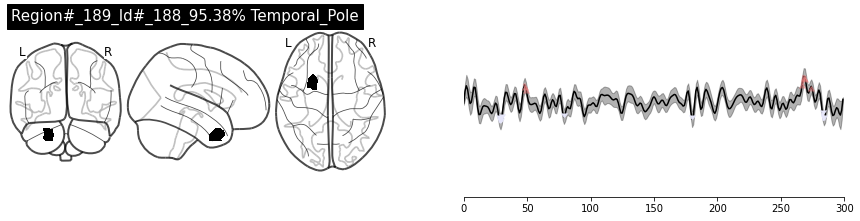


Text corresponding to peaks: next - to - me - mashing - a - cream - pie - For - having - brought - him - into - being - question - that - came - with

Text corresponding to troughs: students - with - wealthier - more - prestigious - ones - that - guy’s - a - I - myself - would - never - Angela - I - am - Pie - Man


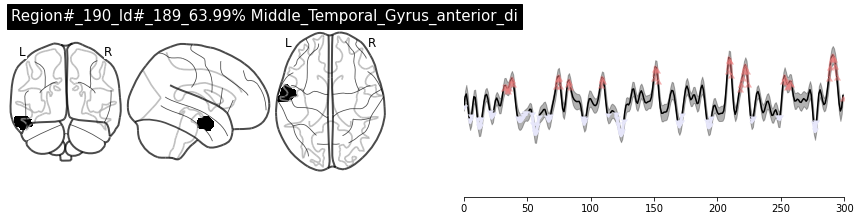


Text corresponding to peaks: up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - avenger - Though - in - fact - he’d - been - capeless - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - and - quoting - him - in - class - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - s

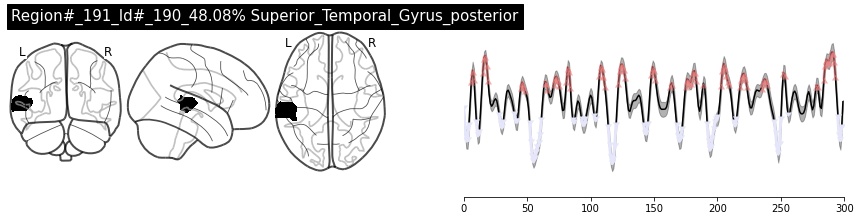


Text corresponding to peaks: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - non - an - bestia - which - means - I - am - not - an - animal - Which - makes - no - sense - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - and - all - the - other - Fordham - students - 

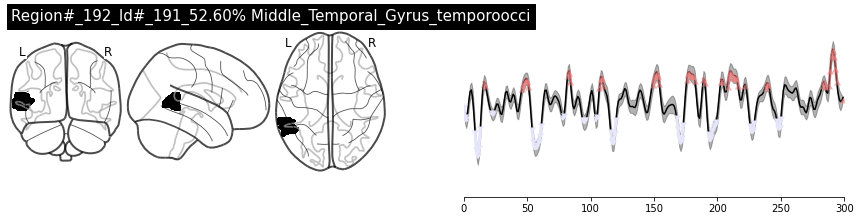


Text corresponding to peaks: toiled - as - a - hard - boiled - reporter - for - the - Ram - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - Sheila - thought - drinking - an - bestia - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - So - I - I - saw - her - there - and - made - a - men

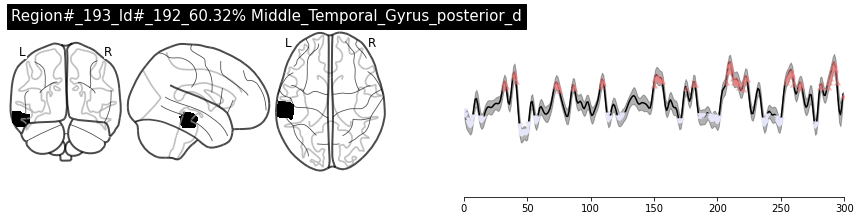


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - And - he - stops - and - looks - at - me - and - he - says - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - by - adding - an - element - of - avenger - Though - in - fact - he’d - been - capeless - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - her - in - his - office - on - say - that - But - the - fact - was - Sheila - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - 

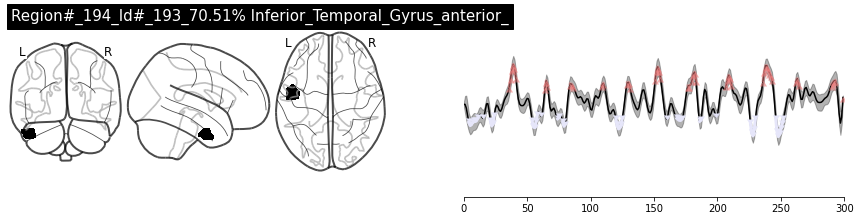


Text corresponding to peaks: rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - and - looks - at - me - and - he - says - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - make - it - better - Though - in - fact - he’d - been - capeless - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - at - 3 - o’clock - signed - Pie - Man - So - I - was - But - that’s - just - a - rumor - please - do - not - spread - it - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - to - buy - with - me - And 

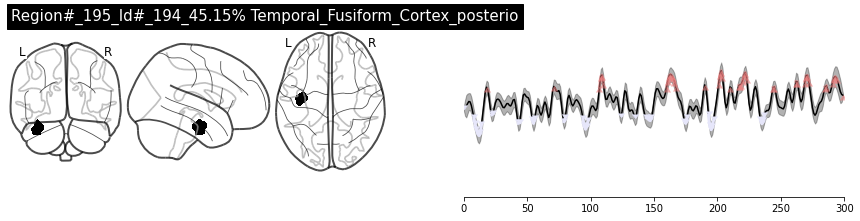


Text corresponding to peaks: the - Jim - Dwyer - who’s - a - senior - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - student - body - president - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - well - bred - Sheila - Sheila - thought - drinking - crying - Ego - sum - non - an - bestia - leaving - the - scene - cape - People - started - dressing - like - him - and - quoting - him - in - class - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - a - round - and - I - felt - a - tap - on - my - shoulder - with - me - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - And - she - said - Oh - good

Text corresponding to troughs: I - began - my - illu

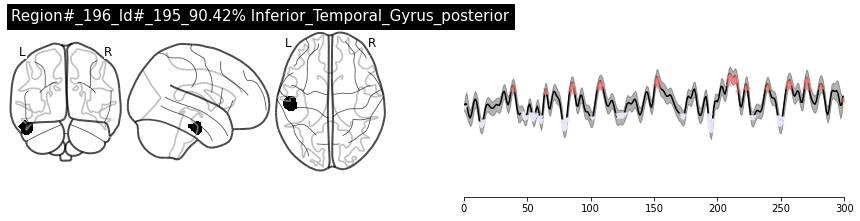


Text corresponding to peaks: And - he - stops - the - Dean - says - Yes - I - would - care - to - comment - make - it - better - by - adding - an - element - of - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - at - 3 - o’clock - signed - Pie - Man - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - toward - the - end - of - this - run - I - was - out - at - a - bar - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - are - you - Pie - Man - And - I - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - said - Yes

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - the - guy - standing - next - to - me - mashing - a - cream - pie - And - the - De

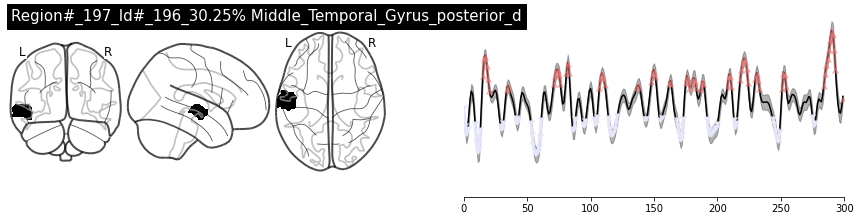


Text corresponding to peaks: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - University - plans - to - raise - tuition - substantially - above - the - inflation - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - I - love - it - Page - one - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - was - different - from - me - and - all - the - other - Fordham - her - in - his - office - on - his - desk - But - that’s - just - a - rumor - please -

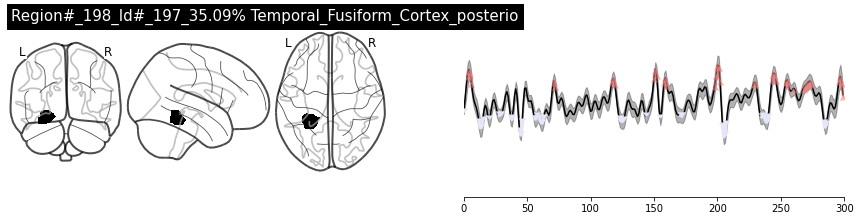


Text corresponding to peaks: Jim - Dwyer - who’s - a - senior - and - he - will - go - in - Latin - Library - Tuesday - at - 3 - o’clock - signed - And - sure - enough - out - comes - Sheila - Beale - student - body - president - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - Ego - sum - non - with - some - friends - And - now - Angela - and - I - had - been - flirting - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - we - were - wondering - are - you - Pie - Man - knew - that - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - University - students - with - wealthier - more - prestigious - wouldn’t - that - be - a - betrayal - of - its 

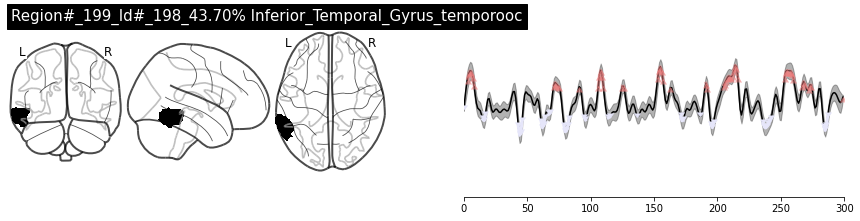


Text corresponding to peaks: Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - up - And - I - described - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - not - an - animal - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - and - all - the - other - Fordham - in - public - was - in - poor - taste - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - For - having - brought - him - into - being - But - she - had - asked - me - a - 

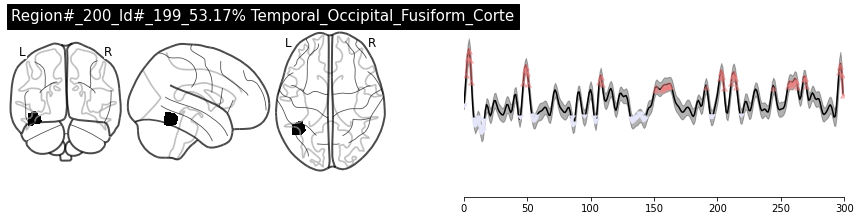


Text corresponding to peaks: the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - at - 3 - o’clock - signed - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - in - public - was - in - Ego - sum - non - an - bestia - Or - at - least - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - a - round - and - I - felt - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - having - brought - him - into - being - Didn’t - she - only - know

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where -

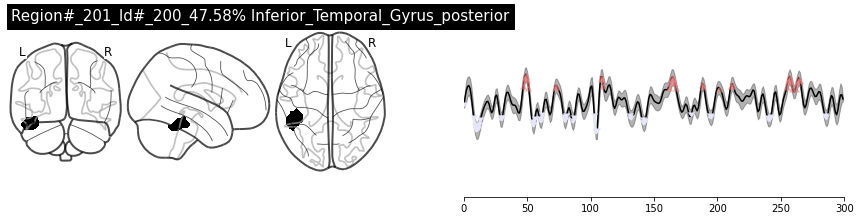


Text corresponding to peaks: the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - avenger - Though - in - fact - he’d - been - capeless - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - well - bred - Sheila - right - boo - that - rule - crying - flowing - behind - him - doing - this - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - with - me - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: I - began - my - illustrious - career - wealthier - more - prestigious - ones - And - the - Dean - is - covered - with - cream - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - that - guy’s - a - dick - Write - it - up - So - I’m - banging - by - adding

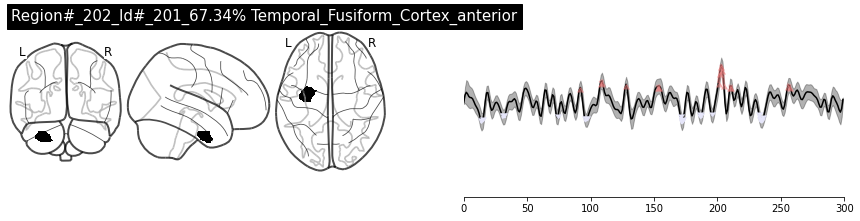


Text corresponding to peaks: avenger - Though - in - fact - he’d - been - Pie - Man - crying - Ego - sum - non - an - bestia - Or - at - least - leaving - the - scene - cape - flowing - behind - him - you - Pie - Man - And

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - TRUE - But - I - had - just - seen - the - line - crossed - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - Although - rumor - The - infamous - no - more - beer - at - barbecues - rule - That’s - Pie - Man - emerged - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she


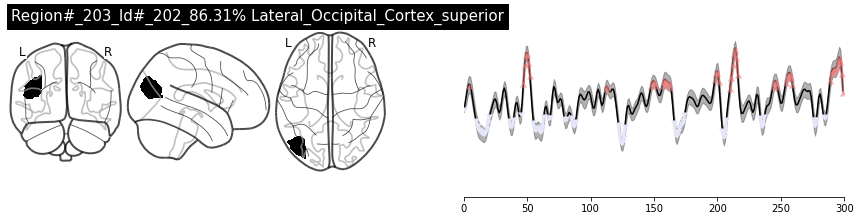


Text corresponding to peaks: the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - And - then - runs - away - he - clicked - his - heels - in - rakish - glee - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - about - it

Text corresponding to troughs: I - began - my - illustrio

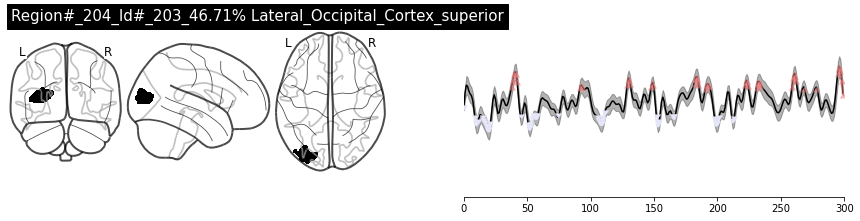


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - Listen - up - punk - And - And - they - recommend - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - in - action - be - on - the - steps - of - Duane - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - in - public - was - in - poor - taste - I - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - for - two - months - Or - I - had - been - flirting - with - her - and - with - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - seen - the - guy

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campu

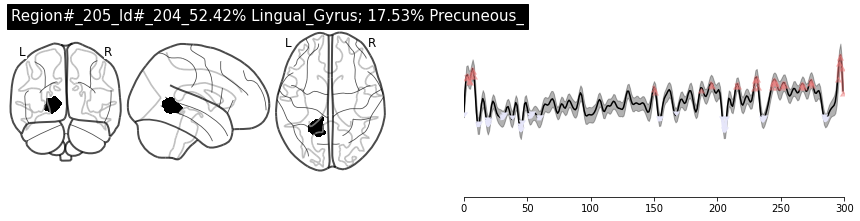


Text corresponding to peaks: Library - Tuesday - at - 3 - o’clock - beer - at - barbecues - rule - That’s - next - Pie - Man - emerged - what - made - him - a - sensation - on - campus - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - Or - I - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - to - know - when - and - where - Pie - Man - will - strike - For - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - And - then - runs - away - And - the - Dean - and - then - I - say - Dean - McGowan - would - you

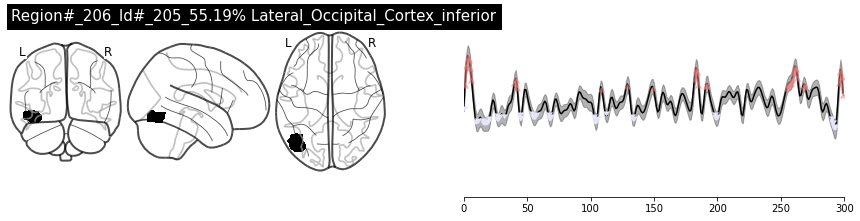


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - avenger - I - needed - something - be - on - the - steps - of - Duane - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - in - public - was - in - poor - taste - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - having - brought - him - into - being

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - Fordham’s - traditionally - working - to - middle - class - students - with - up - to - him - and - I - say - Dean - McGowan - in - the - corner - of - my - eye - which - becomes - this - figure - And - the - Dean - is - covered - with - cream - So - I - So - I - race - back - to - the 

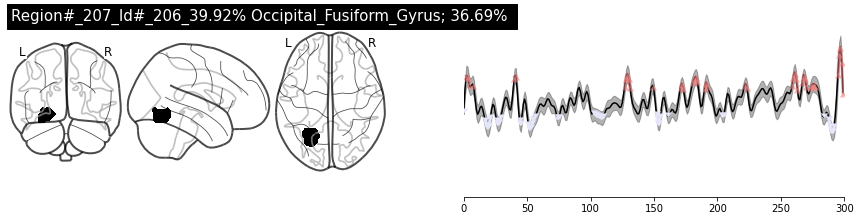


Text corresponding to peaks: and - looks - at - me - and - he - says - Which - makes - no - sense - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - be - on - the - steps - of - Duane - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - Although - rumor - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - in - public - was - in - poor - taste - And - toward - the - end - of - this - run - I - was - out - at - a - bar - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - For - having - brought - him - into - being - Didn’t - she - only - know - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fo

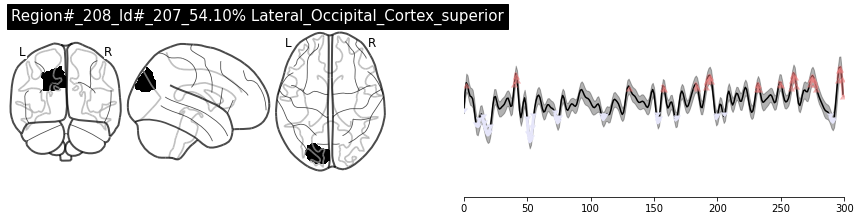


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - I’m - Catholic - a - photographer - from - the - Ram - And - sure - enough - had - collaborated - with - the - Dean - to - ban - outdoor - in - public - was - in - poor - taste - I - think - you - know - what - happened - next - for - two - months - Or - I - had - been - flirting - with - her - Jim - we - were - just - talking - about - how - you - always - seem - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - seen - the - guy

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - 

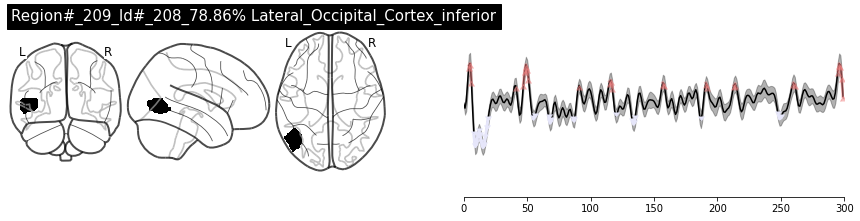


Text corresponding to peaks: and - he - says - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - up - And - I - gave - him - a - catchphrase - in - Latin - a - photographer - from - the - Ram - And - sure - enough - in - public - was - in - poor - taste - And - that’s - knew - that - if - I - said - yes - she - would - have - sex

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - is - covered - with - cream - So - I - race - back - to - the - newsroom - with - my - scoop - by - adding - an - element - of - I - said - that - he - cried - out - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - beer - at - barbecues - rule - That’s - she - said - Jim - we - were - just - talking - about - how - you - always

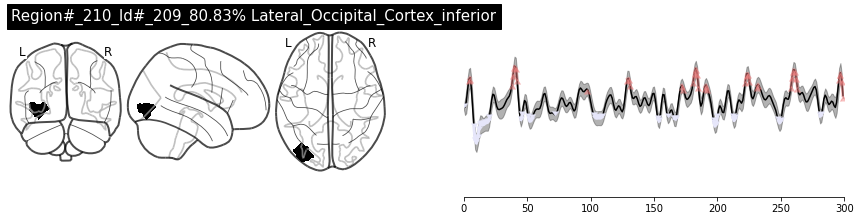


Text corresponding to peaks: And - he - stops - and - looks - at - me - and - he - says - Listen - up - punk - And - the - line - crossed - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - wanted - more - of - Although - rumor - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - Sheila - thought - drinking - in - public - was - in - poor - taste - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - for - two - months - Or - I - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - thi

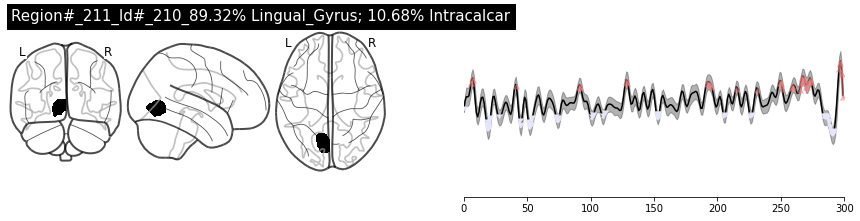


Text corresponding to peaks: and - he - says - up - I - needed - something - poor - taste - I - think - you - know - what - happened - next - what - made - him - a - sensation - for - two - months - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - knew - by - the - way - she - said - it - I - knew - that - I - really - Pie - Man - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - students - with - in - the - corner - of - my - eye - which - becomes - this - figure - And - then - runs - away - And - the - Dean - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - kind - of - liked - it - So - the - first - I - di

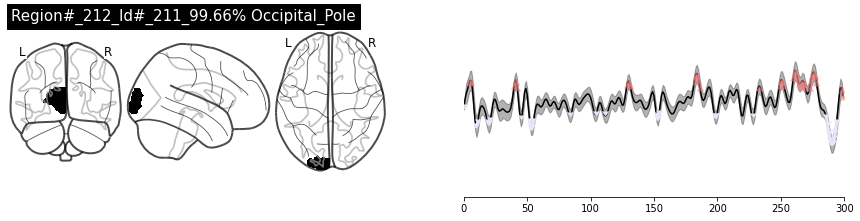


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - The - infamous - no - more - had - been - flirting - with - her - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man - For - having - brought - him - into - being - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - seen - the - guy

Text corresponding to troughs: student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - this

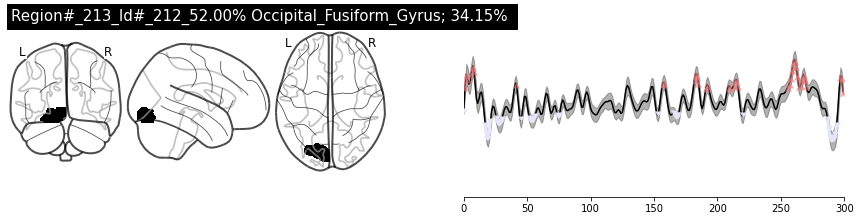


Text corresponding to peaks: and - he - says - a - photographer - from - the - Ram - And - sure - enough - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - in - public - was - in - poor - taste - photo - of - him - leaving - the - scene - cape - And - that’s - what - made - him - a - sensation - on - campus - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - For - having - brought - him - into - being - Didn’t - she - only - know

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - this - figure - And - then - runs - away - And - the - Dean - is - covered - 

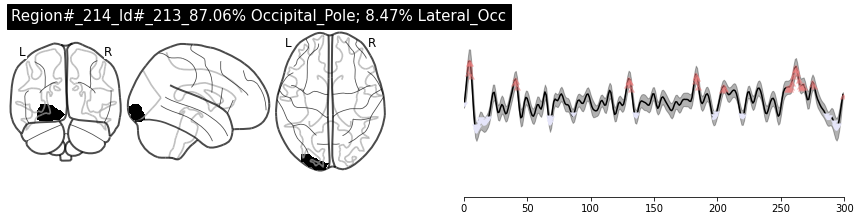


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - Or - at - least - that’s - what - it - said - in - my - story - in - the - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man - For - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - So - I - race - back - to - the - newsroom - with - my - scoop - and - he - says - Pie - Man - from - behind - the - late - night - library - 

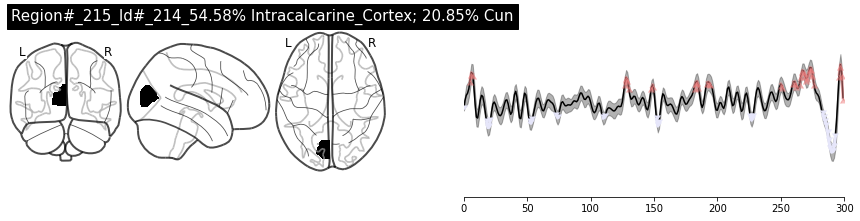


Text corresponding to peaks: Which - makes - no - sense - I - needed - something - I’m - Catholic - in - action - be - on - the - steps - of - Duane - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - poor - taste - I - think - you - know - what - happened - how - you - always - seem - to - know - when - knew - that - if - I - said - yes - she - would - have - sex - with - me - I - really - Pie - Man - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - And - then - runs - away - And - the - Dean - on - to - win - a - Pulitzer - Prize - that - is - TRUE - capeless - And

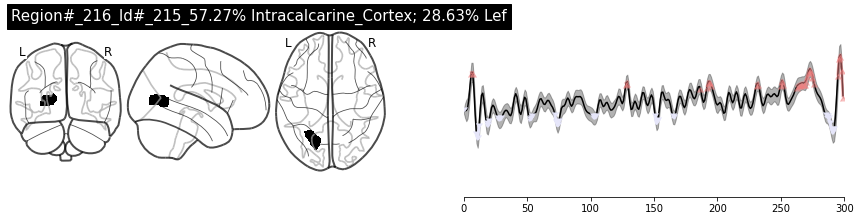


Text corresponding to peaks: I - needed - something - The - infamous - no - more - poor - taste - I - think - you - know - what - happened - next - for - two - months - Or - I - how - you - always - seem - to - know - when - and - where - Pie - And - wasn’t - I - really - Pie - Man - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - working - to - middle - class - students - with - wealthier - more - prestigious - And - then - runs - away - And - the - Dean - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - So - the - first - I - did - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - at - 3 - o’clock - sign

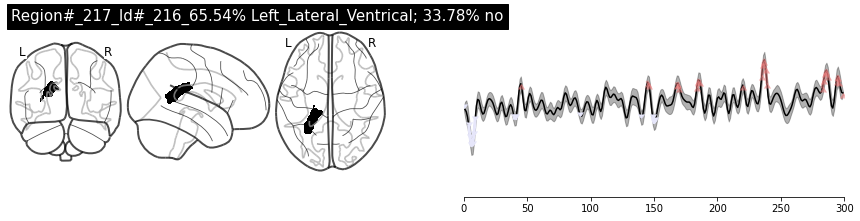


Text corresponding to peaks: this - figure - good - story - Nice - details - had - school - spirit - Sheila - to - ban - outdoor - drinking - on - campus - The - infamous - no - more - five - major - stories - about - Pie - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - there - Angela - I - am - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer

Text corresponding to troughs: and - looks - at - me - and - he - says - the - first - line - got - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock


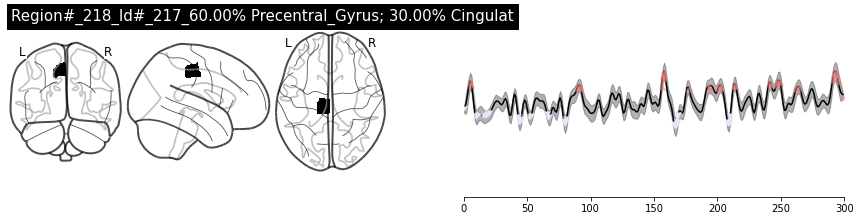


Text corresponding to peaks: making - shit - up - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - But - that’s - I - think - you - know - what - happened - crying - Ego - sum - non - an - bestia - And - that’s - about - it - And - then - I - went - to - the - bar - And - she - said - Jim - we - were - just - talking - about - And - wasn’t

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - And - then - runs - away - Fuck - you - that - guy’s - a - dick - Write - it - up - So - I’m - banging - Sheila - was - well - bred - Sheila - had - school - spirit - which - ran - with - a - photo - of - him - leaving - the - scene - cape


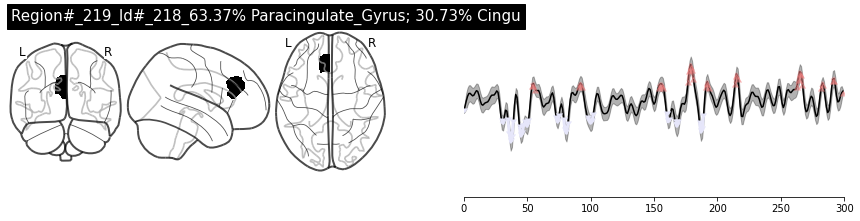


Text corresponding to peaks: And - the - Dean - is - covered - with - cream - up - And - they - recommend - So - I - was - there - with - a - photographer - from - the - Ram - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - in - public - was - in - poor - taste - I - And - that’s - what - made - him - a - sensation - on - campus - And - wasn’t - I - really - Pie - Man - Yes - Angela

Text corresponding to troughs: ones - So - I - whip - out - my - notebook - and - I - go - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a -

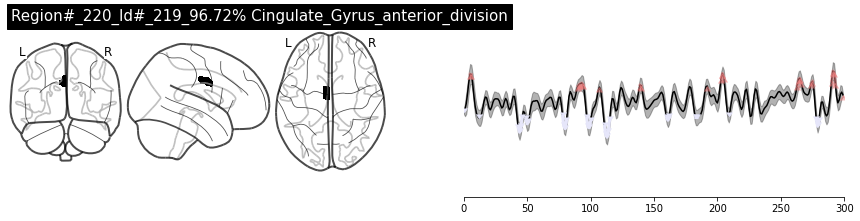


Text corresponding to peaks: making - shit - up - And - they - recommend - against - crossing - that - line - him - as - a - cape - wearing - masked - And - that’s - how - the - first - line - got - poor - taste - an - bestia - Or - at - least - And - wasn’t - I - really - Pie - Man - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - mashing - a - cream - pie - into - Dean - McGowan’s - face - Dean - McGowan - that - guy’s - a - dick - Write - it - up - So - I’m - banging - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - And - said - that - as - he - fled - the - scene - he - clicked - his - heels - in - rakish - glee - And - I - gave - student - body - president - And - now - Sheila - was - different - from - me - had - co

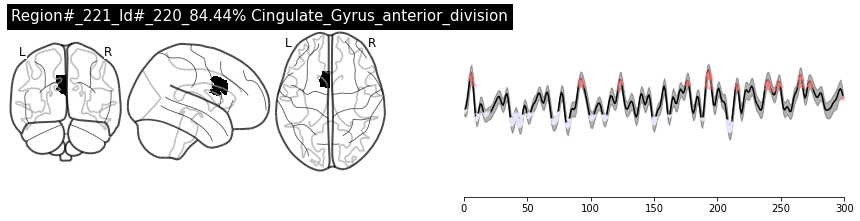


Text corresponding to peaks: up - And - they - recommend - against - crossing - that - line - non - an - bestia - which - means - I - am - his - desk - But - that’s - in - public - was - in - poor - taste - I - think - you - know - what - happened - next - what - made - him - a - sensation - on - campus - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - And - she - said - Jim - we - were - just - talking - about - And - wasn’t - I - really - Pie - Man - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: reporter - for - the - Ram - the - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - and - looks - at - me - Listen - up - punk - And - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - And - then - runs -

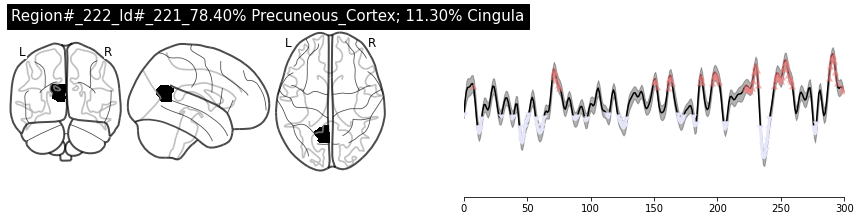


Text corresponding to peaks: and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - Library - Tuesday - at - 3 - o’clock - signed - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - The - infamous - no - more - beer - at - barbecues - rule - That’s - right - boo - that - rule - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - crying - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - corner - Angela - from - my - Brit - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - Or - I - a - tap - on - my - shoulder - And - it - was - he

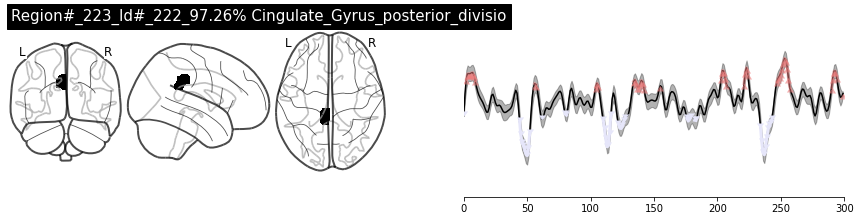


Text corresponding to peaks: with - cream - So - I - I - called - him - Pie - Man - capital - P - capital - M - And - I - described - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - Man - I - love - it - Page - one - And - that’s - how - the - first - line - got - crossed - A - few - days - later - So - I - was - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And

Text corresponding to troughs: in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - next - to - me

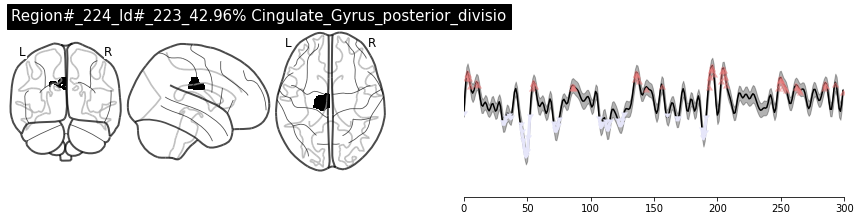


Text corresponding to peaks: And - the - Dean - is - covered - with - cream - by - adding - an - element - of - and - he - says - Pie - Man - I - love - it - Page - one - It - says - Dear - Jim - there - with - I - think - you - know - what - happened - next - Pie - Man - emerged - from - behind - the - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - she - said - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - Man - will - strike - And - we - were - wondering - with - me - And - wasn’t - I - really - Pie - Man - I - am - Pie - Man - And - she - said - Oh - good

Text corresponding to troughs: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - holding - a - cream - pie - whi

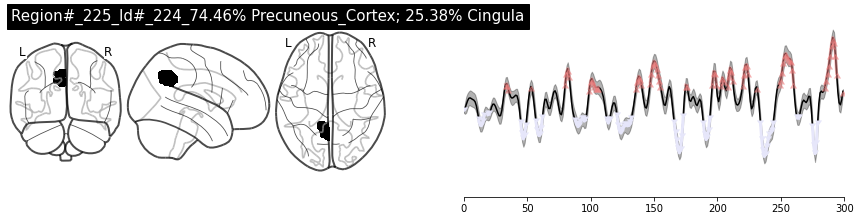


Text corresponding to peaks: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - and - then - I - start - to - and - assault - with - a - pastry - and - I - kind - of - liked - it - So - the - first - I - did - was - I - gave - the - figure - a - name - I - called - him - Pie - Man - capital - P - capital - M - And - I - described - Man - I - love - it - Page - one - And - that’s - how - the - first - line - got - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - her - in - his - office - on - his - desk - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - an - bestia - Or - at - least - which - ran - with - a - photo - of - him - leaving - the - scene -

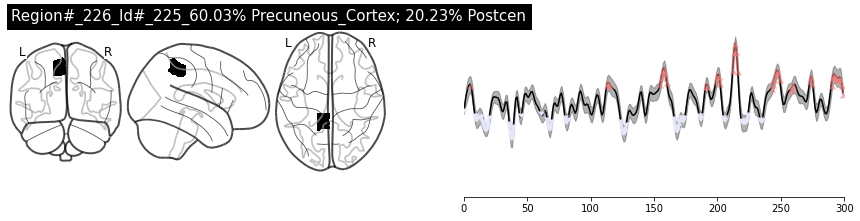


Text corresponding to peaks: in - rakish - glee - And - I - gave - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - out - comes - Sheila - Beale - student - body - president - in - public - was - in - poor - taste - made - his - delivery - and - fled - away - crying - Ego - sum - non - doing - this - And - that’s - what - made - him - a - sensation - on - campus - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - she - said - Jim - we - were - just - talking - about - I - knew - by - the - way - she - said - it - I - knew - that - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact

Text corresponding to troughs: in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - rate - and - if - so - wouldn’t - that - be -

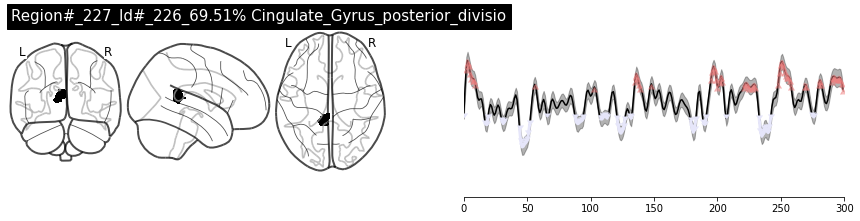


Text corresponding to peaks: with - cream - was - I - gave - the - figure - a - name - and - he - says - Pie - Man - I - love - it - Page - one - And - that’s - how - in - action - next - Pie - Man - emerged - from - behind - the - late - night - library - drop - box - made - his - delivery - and - fled - away - Ego - sum - non - an - bestia - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - Angela - from - my - Brit - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - she - said - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - having - brought - him - into - being - Didn’t - she - only - know - So - I - looked - at - her - and - I - said - Yes

Text correspon

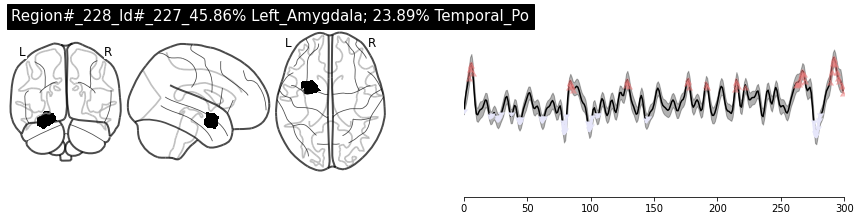


Text corresponding to peaks: and - then - I - start - to - make - it - better - I - needed - something - I’m - Catholic - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - in - public - was - in - poor - taste - And - that’s - what - made - him - a - sensation - on - campus - And - with - me - And - wasn’t - I - really - Pie - Man - For - having - brought - him - into - being - about - it

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - wouldn’t - that - be - a - betrayal - of - its - mission - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - to - comment - on - this - latest - attack - And - Dean - McGowan - that - guy’s - a - dick - Write - it - up - So - I’m - banging - between - a - high - powered - d

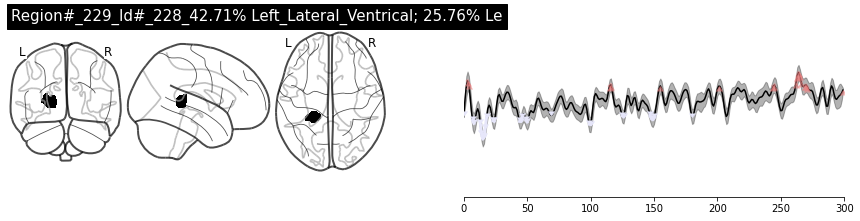


Text corresponding to peaks: And - I - gave - him - a - catchphrase - So - I - was - crying - a - round - and - I - felt - a - tap - on - my - shoulder - with - me - And - wasn’t - I - really - Pie - Man - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - Dean - McGowan - architect - of - a - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - mashing - a - cream - pie - into - Dean - McGowan’s - face - the - newsroom - with - my - scoop - and - assault - with - a - pastry - and - I - not - an - animal - If - you - want - to - see - me - again - in - action - be - on - the - steps - of - Duane - Library - Tuesday - I - myself - would - never


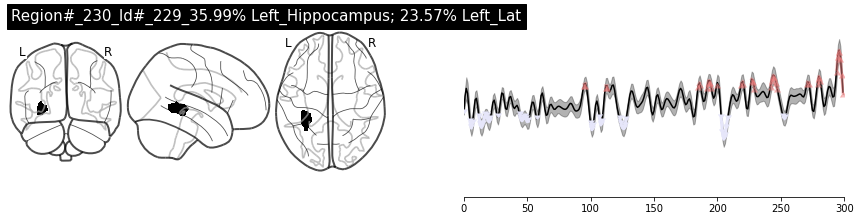


Text corresponding to peaks: But - I - had - just - seen - he - clicked - his - heels - in - rakish - glee - drinking - on - campus - The - infamous - no - more - poor - taste - I - think - you - know - what - happened - next - and - fled - away - The - Ram - ran - five - major - stories - about - Pie - Angela - from - my - Brit - Lit - class - drinking - with - some - friends - And - now - Angela - And - then - I - went - to - the - bar - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - And - about - him - through - me - out - of - costume - So - I - looked - at - her - and - I - said

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - working - to - middle - class - in - the - corner - of

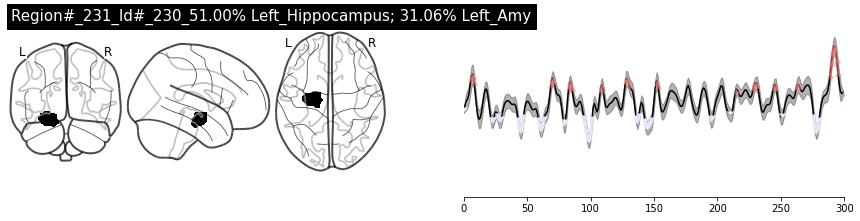


Text corresponding to peaks: the - newsroom - with - my - scoop - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - and - then - I - start - to - make - it - better - avenger - Though - in - fact - he’d - been - I - needed - something - I’m - Catholic - signed - Pie - Man - what - made - him - a - sensation - with - some - friends - And - now - Angela - and - I - had - been - flirting - for - two - months - a - tap - on - my - shoulder - And - it - was - her - And - wasn’t - about - it

Text corresponding to troughs: and - out - comes - the - elusive - Dean - McGowan - working - to - middle - class - students - with - wealthier - more - prestigious - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - that - guy’s - a - dick - Write - it

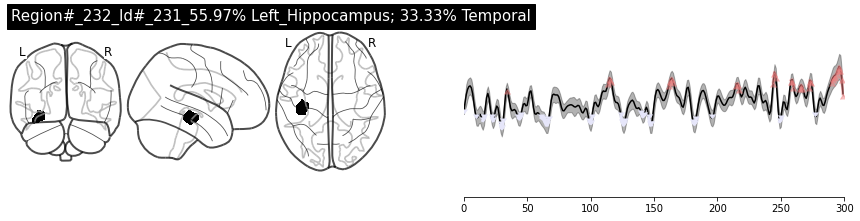


Text corresponding to peaks: University - plans - to - raise - tuition - And - I - gave - him - a - catchphrase - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her - I - knew - by - the - way - she - said - it - I - knew - that - I - really - Pie - Man - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - and - out - comes - the - elusive - Dean - McGowan - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - to - comment - on - this - latest - attack 

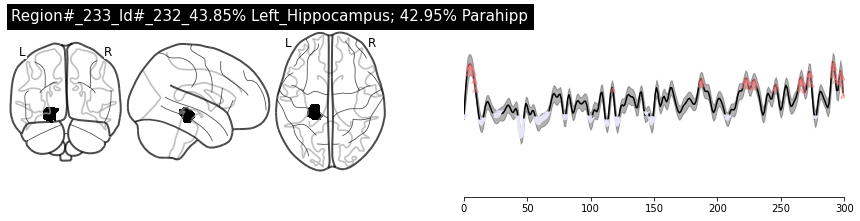


Text corresponding to peaks: in - Latin - The - infamous - no - more - beer - at - barbecues - rule - That’s - right - boo - that - rule - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - Angela - from - my - Brit - Lit - class - drinking - with - some - friends - And - now - Angela - and - I - had - been - flirting - a - tap - on - my - shoulder - And - it - was - her - And - wasn’t - I - really - Pie - Man - For - about - him - through - me - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - t

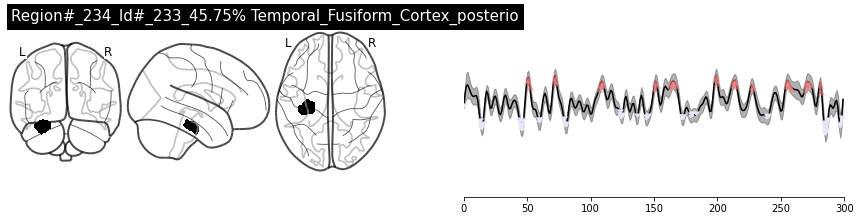


Text corresponding to peaks: into - Dean - McGowan’s - face - And - then - runs - away - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - capeless - Library - Tuesday - at - 3 - o’clock - signed - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - Sheila - was - well - bred - Sheila - late - night - library - drop - box - made - his - delivery - and - fled - away - doing - this - And - that’s - what - made - him - a - sensation - Angela - from - my - Brit - Lit - class - drinking - And - we - were - wondering - are - you - Pie - Man - And - I - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - said - Yes

Text corresponding to troughs: I - began - my - illustrious - career - in -

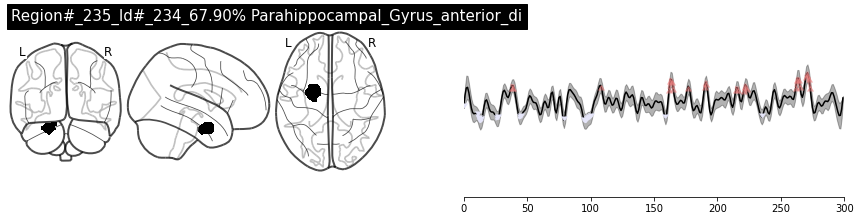


Text corresponding to peaks: And - he - stops - avenger - was - different - from - me - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - But - that’s - Sheila - thought - drinking - in - public - was - in - what - made - him - a - sensation - on - campus - Man - all - of - them - by - me - And - toward - the - end - of - this - run - I - was - out - at - a - bar - with - me - And - wasn’t - I - really - Pie - Man - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - Fordham’s - traditionally - working - to - middle - class - in - the - corner - of - my - eye - which - becomes - this - figure - that - guy’s - a - But - I - had - just - seen - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - and - I - out - comes - Sheila - Beale 

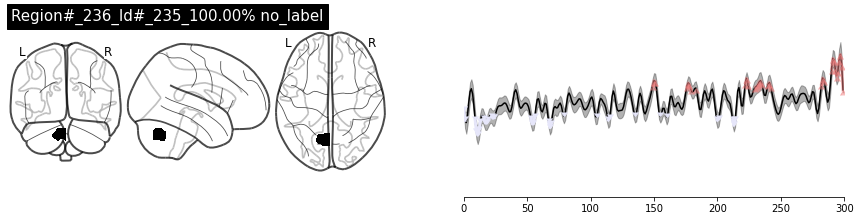


Text corresponding to peaks: be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - had - collaborated - with - the - Dean - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - and - I - had - been - flirting - for - two - months - Or - I - had - been - flirting - with - her - and - with - such - nuance - that - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - Yes - Angela - I - am - Pie - Man

Text corresponding to troughs: I - began - my - illustrious - career - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - And - the - Dean - is - covered - with - cream - So - I - race - back - to - the - newsroom - with - my - scoop

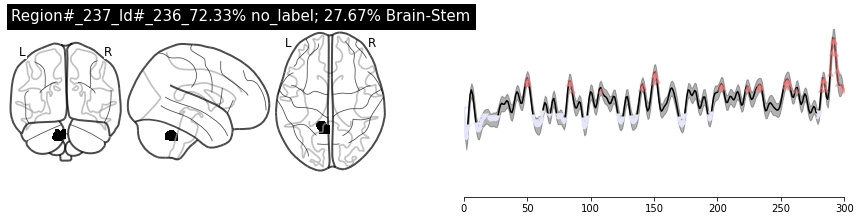


Text corresponding to peaks: mashing - a - cream - pie - into - Dean - McGowan’s - face - and - then - I - start - to - make - it - better - avenger - the - first - line - got - crossed - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Ego - sum - non - an - bestia - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - Or - I - had - been - flirting - with - her - and - with - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - with - me - Yes - Angela - I - am - Pie - Man - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - is -

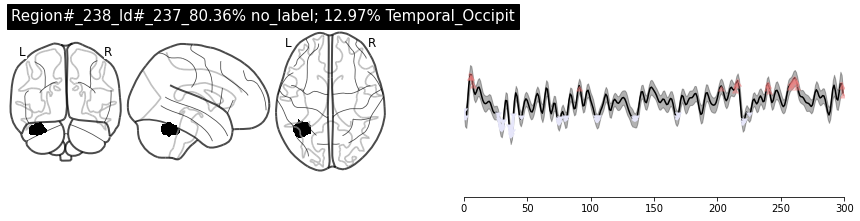


Text corresponding to peaks: up - an - bestia - And - that’s - what - made - him - a - sensation - on - campus - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me

Text corresponding to troughs: working - to - middle - class - students - with - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - this - figure - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - dick - Write - it - up - So - I’m - banging - I - called - him - Pie - Man - capital - P - capital - M - And - I - described - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - Man - had - school - spirit - five - major - stories - a

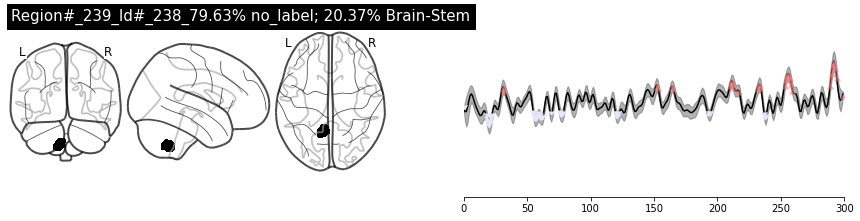


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - signed - Pie - Man - students - who - wore - flannel - shirts - and - worked - part - time - jobs - leaving - the - scene - cape - flowing - behind - him - doing - this - on - campus - Or - I - had - been - flirting - with - her - and - with - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - is - covered - with - cream - So - I - give - him - a - moment - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - the - newsroom - with - my - scoop - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - D

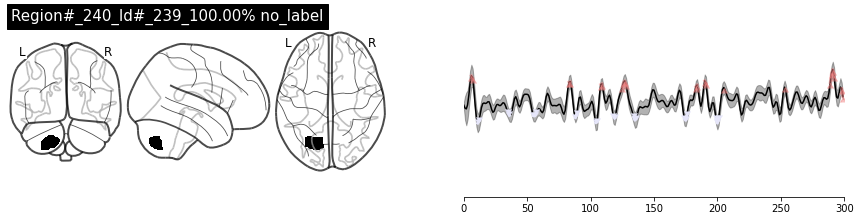


Text corresponding to peaks: and - then - I - start - to - make - it - better - avenger - Though - in - fact - he’d - been - not - an - animal - Which - makes - no - sense - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - in - public - was - in - Or - at - least - Man - will - strike - about - it

Text corresponding to troughs: substantially - above - the - inflation - rate - and - if - so - is - covered - with - cream - So - I - embellishment - Reporters - call - this - I - called - him - Pie - Man - capital - P - capital - M - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - Man - had - it - that - he - got - plenty - of - her - in - his - office - on - his - desk - made - his - delivery - and - fled - away - crying


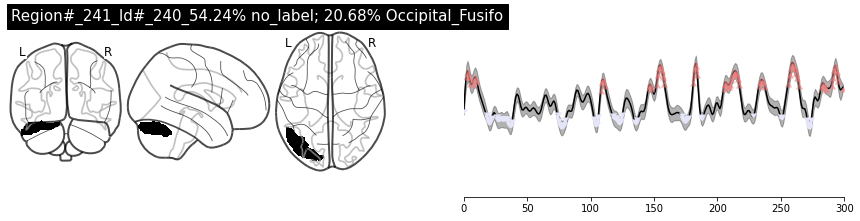


Text corresponding to peaks: avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - details - If - you - want - to - see - me - again - in - action - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - And - sure - enough - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said

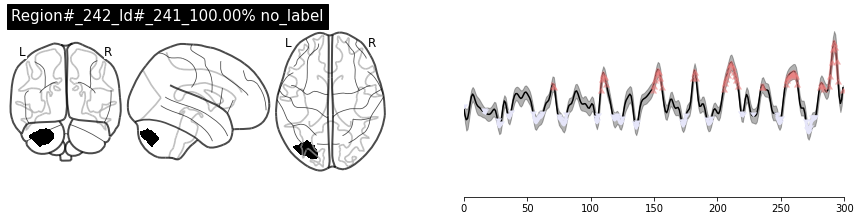


Text corresponding to peaks: and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - he - clicked - his - heels - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - such - nuance - that - there - was - a - question - about - whether - she - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - said 

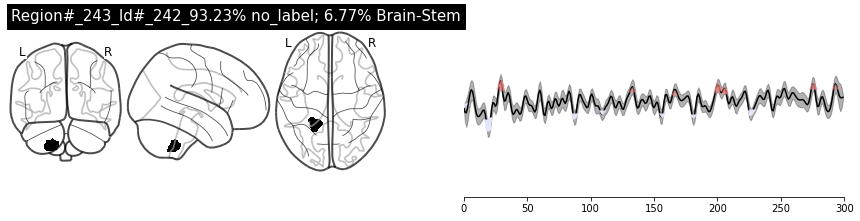


Text corresponding to peaks: students - with - wealthier - more - prestigious - ones - So - I - finish - my - story - Sheila - was - made - his - delivery - and - fled - away - crying - Or - at - least - that’s - what - it - said - in - my - story - in - the - a - straightforward - answer - In - fact - I - wasn’t - Pie

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - by - adding - an - element - of - embellishment - Though - in - fact - he’d - been - there - with - say - that - corner - Angela - from - my - Brit


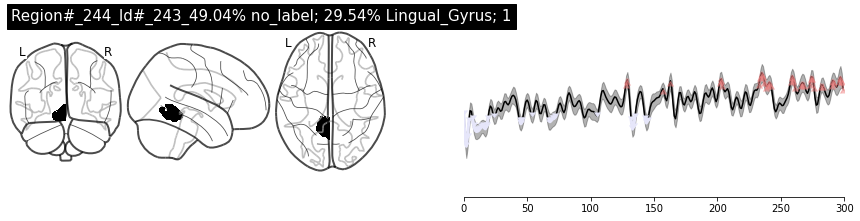


Text corresponding to peaks: I - needed - something - a - photographer - from - the - Ram - and - all - the - other - Fordham - Ego - sum - non - an - bestia - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - For - But - she - had - asked - me - a - straightforward - question - that - came - with - a - straightforward - answer - In - fact - I - wasn’t - Pie - Yes - Angela

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - architect - of - a - in - the - corner - of - my - eye - which - becomes - this

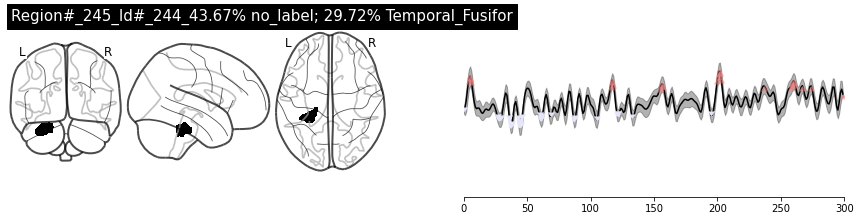


Text corresponding to peaks: him - a - catchphrase - in - Latin - So - I - was - there - with - a - photographer - from - the - Ram - and - fled - away - crying - Ego - sum - non - an - bestia - knew - I - existed - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - question - that - came - with

Text corresponding to troughs: working - to - middle - class - students - with - wealthier - more - prestigious - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - the - newsroom - with - my - scoop - by - adding - an - element - of - embellishment - capital - P - capital - M - Ego - sum - non - an - bestia - So - I - finish - my - story - n

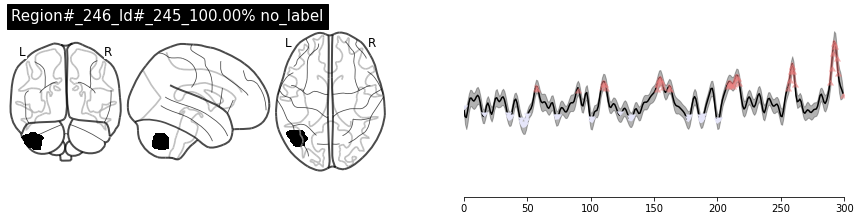


Text corresponding to peaks: So - I - give - him - a - moment - making - shit - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - he - clicked - his - heels - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - was - different - from - me - and - all - the - other - Fordham - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - People - started - dressing - like - him - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - about - it

Text corresponding to troughs: toiled - as - a - hard - boiled - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - holding - a - cream - pie - which - becomes - the - guy - sta

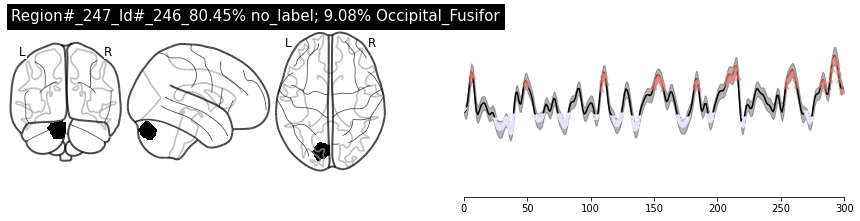


Text corresponding to peaks: next - to - me - mashing - a - cream - pie - into - Dean - McGowan’s - face - avenger - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - he - clicked - his - heels - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - there - with - a - photographer - from - the - Ram - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - on - campus - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - with - me - Yes - Angela - I - am - Pie - Man - about - it

Text corresponding to troughs: policy - to - replace - Fordham’

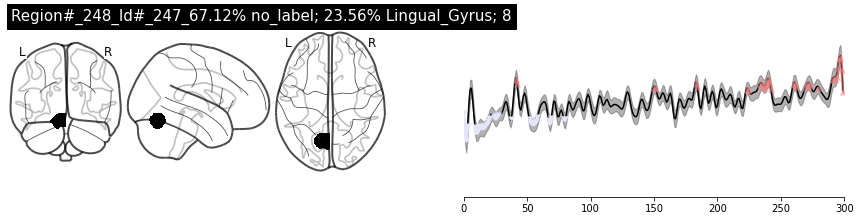


Text corresponding to peaks: and - he - says - Listen - up - punk - And - Library - Tuesday - at - 3 - o’clock - had - collaborated - with - the - Dean - to - ban - outdoor - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - knew - that - if - I - said - yes - she - would - have - sex - with - me - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - out - of - costume

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - architect - of - a - policy -

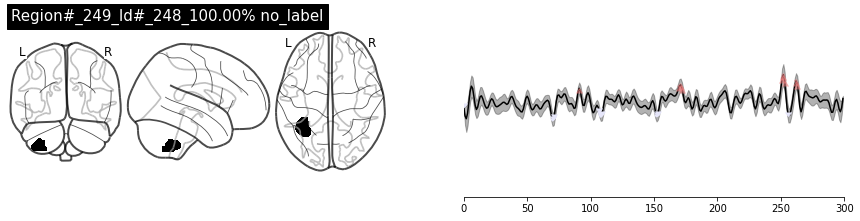


Text corresponding to peaks: up - Sheila - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - to - know - when - and - where - Pie - Man - will - strike - with - me

Text corresponding to troughs: and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - him - as - a - cape - wearing - masked - avenger - Though - in - fact - he’d - been - signed - Pie - Man - you - Pie - Man


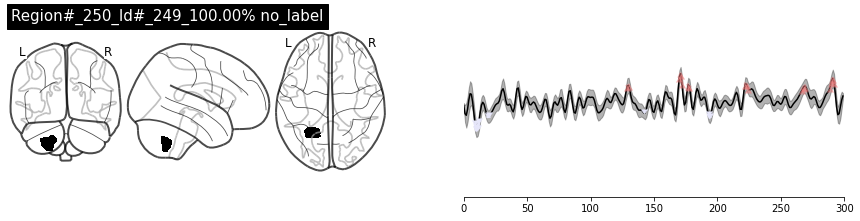


Text corresponding to peaks: I - needed - something - I’m - Catholic - Sheila - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - But - that’s - just - a - rumor - please - do - not - spread - it - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - For - having - brought - him - into - being - about - it

Text corresponding to troughs: student - newspaper - at - Fordham - University - A - few - days - later - I - think - you - know - what - happened


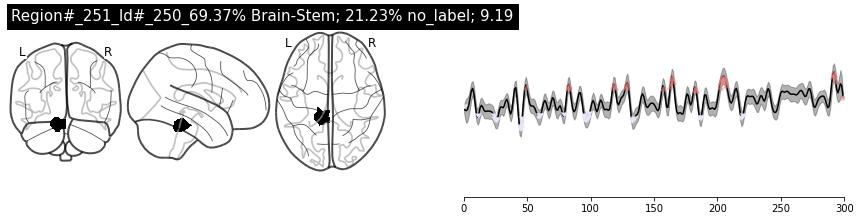


Text corresponding to peaks: mashing - a - cream - pie - out - my - story - and - I - know - it’s - good - and - then - I - start - to - I - needed - something - a - photographer - from - the - Ram - and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - worked - part - time - jobs - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Ego - sum - non - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day

Text corresponding to troughs: architect - of - a - policy - to - replace - Fordham’s - traditionally - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - and - then - I - say - Dean - McGowan - would - you - care - that - guy’s - a - But - I - had - just - seen - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - So - I - finish - my - story - and - I - hand

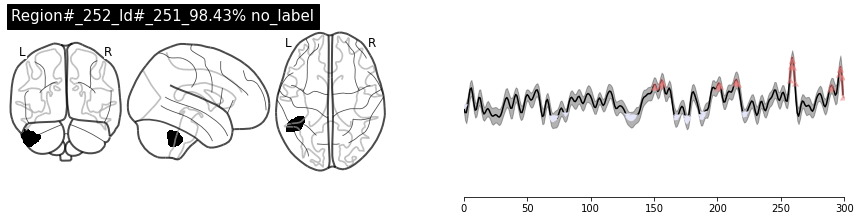


Text corresponding to peaks: Library - Tuesday - at - 3 - o’clock - So - I - was - there - with - a - photographer - from - the - Ram - and - fled - away - crying - Ego - sum - non - And - that’s - what - made - him - a - sensation - on - campus - And - I - knew - by - the - way - she - said - it - I - knew - that - if - I - said - yes - she - would - have - sex - about - it

Text corresponding to troughs: the - newsroom - with - my - scoop - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - and - he - will - go - dick - Write - it - up - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - well - bred - Sheila - had - school - her - in - his - office - on - his - desk - But - that’s - beer - at - barbecues - rule - That’s - right - boo - that - rule - Man - all - of - them - by - me - And


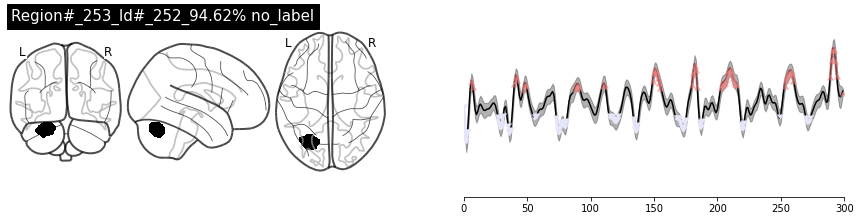


Text corresponding to peaks: and - looks - at - me - and - he - says - Listen - up - punk - And - the - guy - standing - next - to - me - mashing - a - cream - pie - embellishment - Reporters - call - this - making - shit - up - capeless - And - said - that - as - he - fled - the - scene - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - signed - Pie - Man - So - I - was - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - leaving - the - scene - cape - flowing - behind - him - doing - this - And - that’s - what - made - him - a - sensation - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - I - knew - by - the - way - she - said - it - I - knew - that - about - it

Text correspon

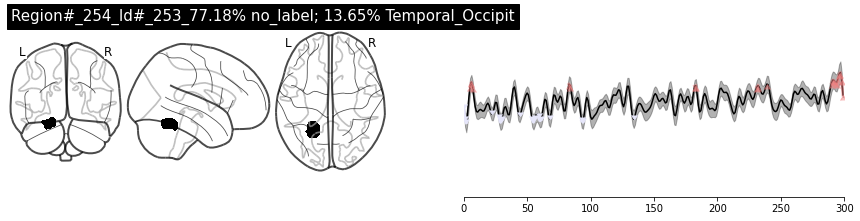


Text corresponding to peaks: and - then - I - start - to - make - it - better - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - for - two - months - Or - I - So - I - I - saw - her - there

Text corresponding to troughs: and - out - comes - the - elusive - students - with - wealthier - more - prestigious - ones - in - the - corner - of - my - eye - which - becomes - And - the - Dean - is - covered - with - cream - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - So - I - race - back - to - And - they - recommend - against - crossing - that - line - and - I - hand - it - to - Dwyer - and - he - reads


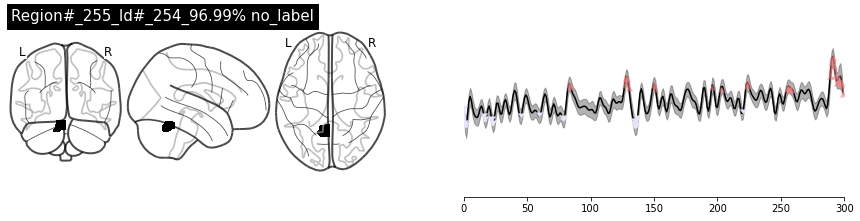


Text corresponding to peaks: and - then - I - start - to - make - it - better - Which - makes - no - sense - I - needed - something - I’m - Catholic - Library - Tuesday - at - 3 - o’clock - Pie - Man - emerged - an - bestia - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - are - you - Pie - Man - And - I - about - it

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - and - out - comes - the - elusive - Dean - McGowan - this - figure - Dean - McGowan - that - guy’s - a - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - Man - I - love - it - Page - one - five - major - stories - about - Pie


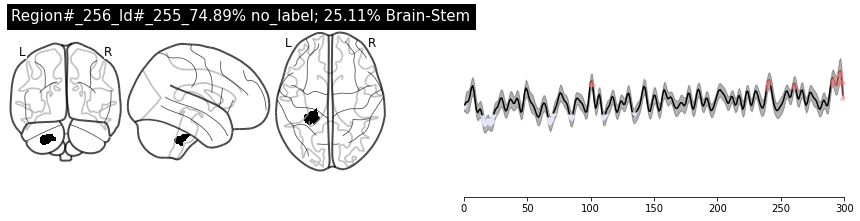


Text corresponding to peaks: and - I - kind - of - liked - it - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - knew - that - if - I - said - yes - she - would - have - sex

Text corresponding to troughs: in - the - Bronx - where - I - toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - make - it - better - capeless - And - said - that - as - he - fled - the - scene - and - I - hand - it - to - Dwyer - and - he - reads


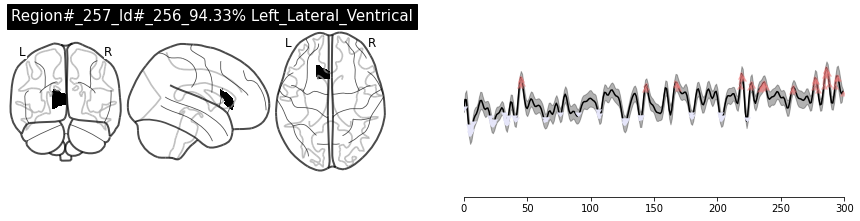


Text corresponding to peaks: in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - I - get - a - letter - It - says - Dear - Jim - well - bred - Sheila - had - school - spirit - and - quoting - him - in - class - The - Ram - ran - five - major - stories - about - Pie - corner - Angela - from - my - Brit - and - with - such - nuance - that - there - was - a - question - about - whether - she - knew - I - existed - knew - by - the - way - she - said - it - I - knew - that - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - seen - the - guy - out - of - costume - I - am - Pie - Man - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fo

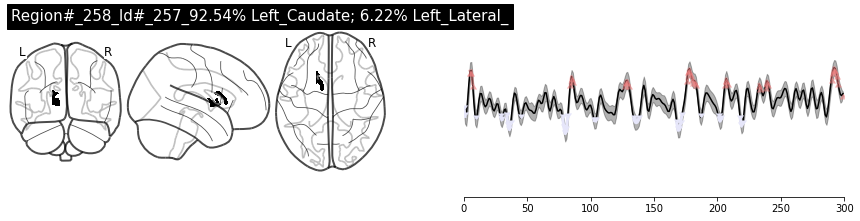


Text corresponding to peaks: make - it - better - Which - makes - no - sense - I - needed - something - I’m - Catholic - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - had - been - flirting - with - her - and - with - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing

Text corresponding to troughs: wealthier - more - prestigious - ones - University - plans - to - raise - tuition - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - Dean - McGowan - that - guy’s - a - dick - Write - it - up - So - I’m - banging - out - my - story - and - I - know - it’s - good - was - I - gave - the

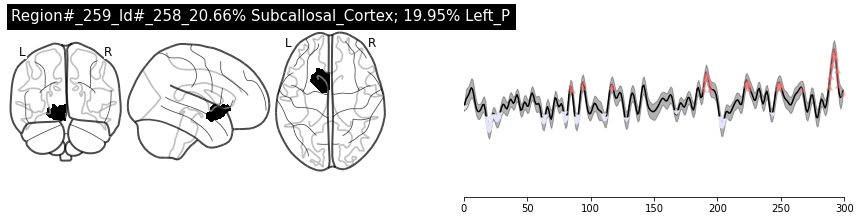


Text corresponding to peaks: make - it - better - And - they - recommend - against - crossing - that - line - him - a - catchphrase - in - Latin - Sheila - thought - drinking - in - public - was - in - poor - taste - I - think - you - know - what - happened - And - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - And - she - said - Jim - we - were - just - talking - about - how - you - always - seem - and - tell - me - all - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - And - the - Dean - says - Yes - that - guy’s - a - dick - Write - it - up - So - I’m - banging - embellishment - Reporters - call - this - making - shit - capeless - And - said 

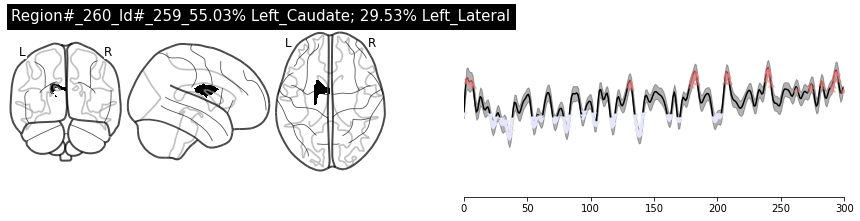


Text corresponding to peaks: I’m - Catholic - Latin - just - comes - to - me - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - with - me - But - she - had - asked - me - a - straightforward - question - that - came - with - Yes - Angela

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - Un

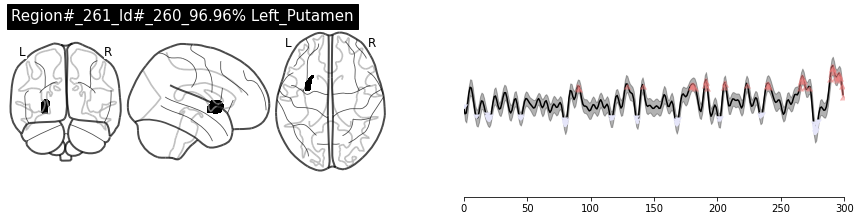


Text corresponding to peaks: making - shit - up - I - needed - something - crossed - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - Sheila - thought - drinking - in - public - was - in - poor - taste - Or - at - least - that’s - what - it - said - in - my - story - in - the - toward - the - end - of - this - run - I - was - out - at - a - bar - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - I - really - Pie - Man - For - having - brought - him - into - being - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - in - the - corner - of - my - eye - which - becomes - this - figure - that - guy’s - a - dick - Write - it - up - So - I’m - banging - him - a - catchphrase - in - Latin - Man - I - love - it - Page - one - well - bred - Sheila - had - school - spirit - crying -

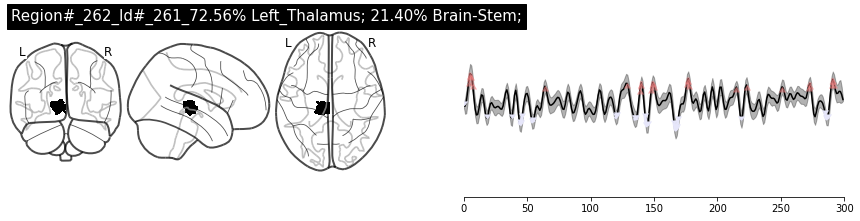


Text corresponding to peaks: the - Dean - says - Yes - I - needed - something - And - that’s - how - the - first - line - got - in - action - be - on - the - steps - of - Duane - Library - Tuesday - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - what - made - him - a - sensation - toward - the - end - of - this - run - I - was - out - at - a - bar - to - know - when - But - she - had - asked - me - a - straightforward

Text corresponding to troughs: the - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - And - the - Dean - is - covered - I - said - that - he - cried - out - Ego - sum - and - he - says - Pie - Man - I - get - a - letter - It - says - Dear - Jim - good - story - Nice - Sheila - was - well - bred - Sheila - had - school - spirit - The - Ram - ran - And - she - said - Oh - good - Now - buy - me - a - beer


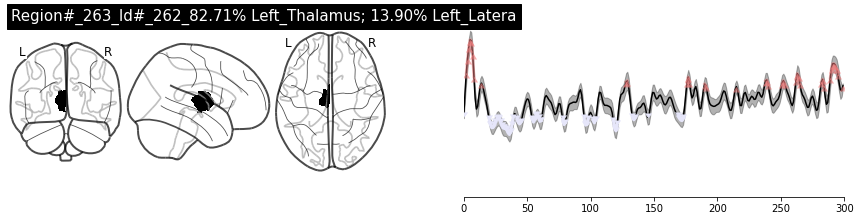


Text corresponding to peaks: in - journalism - I - needed - something - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - Sheila - thought - drinking - in - public - was - in - what - made - him - a - sensation - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - to - know - when - and - where - Pie - Man - will - strike - with - me - And - wasn’t - I - really - Pie - Man - Yes - Angela - I - am - Pie - Man - about - it

Text corresponding to troughs: University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - s

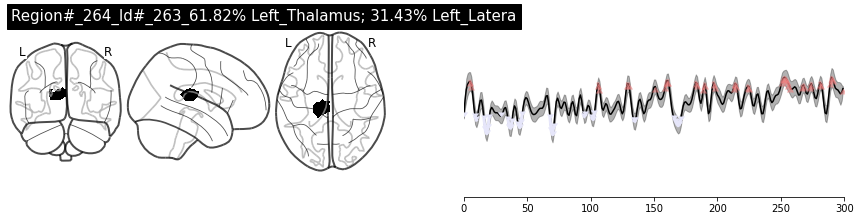


Text corresponding to peaks: And - I - described - him - as - a - cape - wearing - masked - I - needed - something - I’m - Catholic - at - 3 - o’clock - out - comes - Sheila - Beale - student - body - president - And - now - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - Sheila - thought - drinking - from - behind - the - late - night - library - drop - box - And - that’s - what - made - him - a - sensation - one - night - and - I - saw - I - came - and - I - saw - in - the - to - know - when - and - where - Pie - Man - will - strike - And - we - were - wondering - are - you - Pie - Man - And - For - But - she - had - asked - me - a - straightforward - question - that - came - with - said - Yes - about - it

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - the - student - newspaper - at - Fordham - University - wealthier - more - prestigious - substantially - above - the - inflation - rate - and - if - so - wouldn’t 

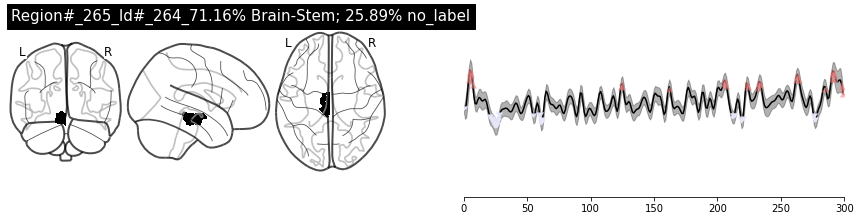


Text corresponding to peaks: which - means - I - am - not - an - animal - was - different - from - me - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - Or - I - had - been - flirting - with - her - and - with - with - me - And - wasn’t

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - is - covered - and - then - I - say - Dean - McGowan - would - you - care - to - comment - on - this - latest - attack - And - doing - this - The - Ram - ran - five - major - stories - about - Pie - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never


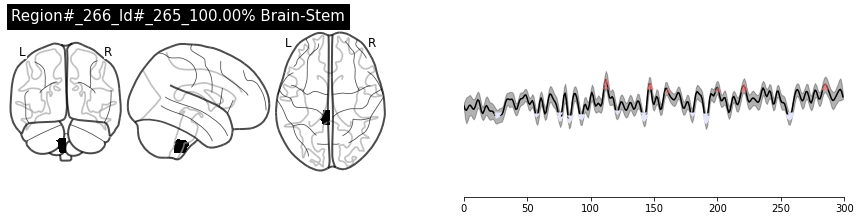


Text corresponding to peaks: And - said - that - as - he - fled - the - scene - he - clicked - his - heels - details - If - you - want - to - see - me - again - student - body - president - and - fled - away - five - major - stories - about - Pie - Man - all - of - them - by - me - I - am - Pie - Man

Text corresponding to troughs: Fordham’s - traditionally - working - to - middle - class - So - I - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - and - then - I - start - to - make - it - better - And - they - recommend - Ego - sum - crossed - A - few - days - later - I - get - a - letter - I - myself - would - never - Sheila - thought - drinking - in - public - was - in - poor - taste - you - Pie - Man - And - I


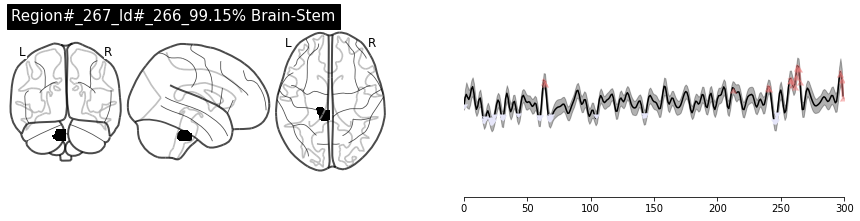


Text corresponding to peaks: the - Dean - says - Yes - doing - this - and - made - a - mental - note - to - do - nothing - about - it - And - I - knew - by - the - way - she - said - it - I - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: toiled - as - a - hard - boiled - reporter - for - the - Ram - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - ones - So - I - whip - out - my - notebook - and - I - go - right - then - there’s - a - blur - and - then - I - say - Dean - McGowan - would - you - care - So - I - race - back - to - the - newsroom - with - my - scoop - I - called - him - Pie - Man - A - few - days - later - I - get - a - letter - a - tap - on - my - shoulder - And - it - was - her - And


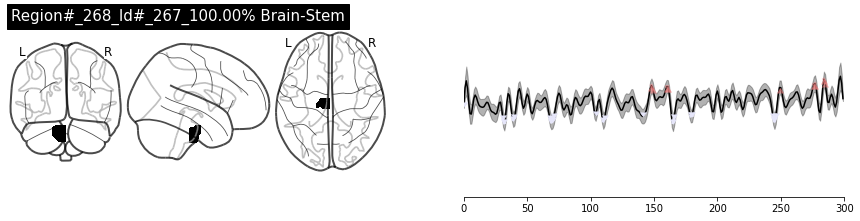


Text corresponding to peaks: in - action - be - on - the - steps - of - Duane - student - body - president - And - now - Sheila - Jim - we - were - just - talking - about - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never - I - am - Pie - Man

Text corresponding to troughs: So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - And - he - stops - and - looks - at - me - So - I - race - back - to - the - newsroom - with - my - scoop - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - I - called - him - Pie - Man - capeless - And - said - that - as - he - fled - the - scene - crossed - worked - part - time - jobs - Sheila - was - outside - this - rumor - I - myself - would - never - a - round - and - I - felt - a - tap - on - my - shoulder - And - it - was - her


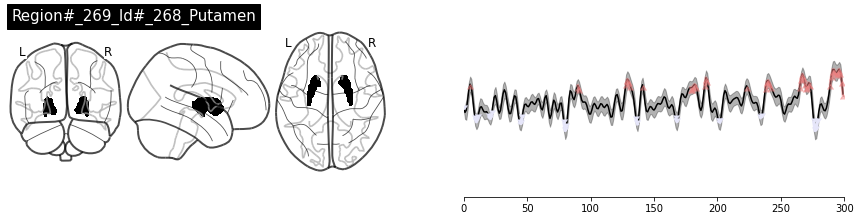


Text corresponding to peaks: making - shit - up - I - needed - something - I’m - Catholic - Latin - just - comes - to - me - crossed - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - Sheila - thought - drinking - in - public - was - in - poor - taste - toward - the - end - of - this - run - I - was - out - at - a - bar - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - And - then - I - went - to - the - bar - I - really - Pie - Man - For - having - brought - him - into - being - Didn’t - she - only - know - about - him - through - me - But - she - had - asked - me - a - straightforward - about - it

Text corresponding to troughs: University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - whi

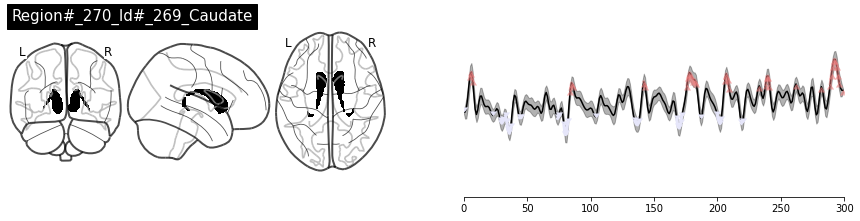


Text corresponding to peaks: make - it - better - A - few - days - later - I - get - a - letter - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - I - myself - would - never - say - that - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - photo - of - him - had - been - flirting - with - her - So - I - I - saw - her - there - and - made - a - mental - note - to - do - nothing - about - it - with - me - Yes - about - it

Text corresponding to troughs: Dean - McGowan - wealthier - more - prestigious - ones - So - I - whip - out - my - notebook - and - I - go - is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - in - the - corner - of - my - eye - w

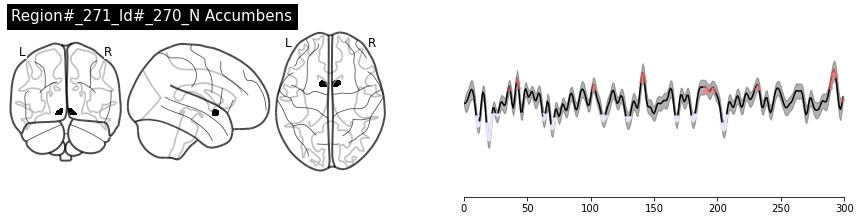


Text corresponding to peaks: rate - and - if - so - Listen - up - punk - And - right - then - there’s - a - blur - So - the - first - I - did - was - I - gave - the - figure - a - name - the - first - line - got - crossed - A - few - days - later - Sheila - thought - drinking - in - public - was - in - poor - taste - Pie - Man - emerged - from - behind - the - for - two - months - Or - I - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Fordham’s - traditionally - the - Dean - says - Yes - the - newsroom - with - my - scoop - and - I - find - the - editor - Jim - Dwyer - who’s - a - senior - Though - in - fact - he’d - been - capeless - And - said - that - as - he - fled - the - scene - I - needed - something - I’m - Catholic - well - bred - Sheila - had - school - I - myself - would - never - say - that - But - the - fact - was - Sh

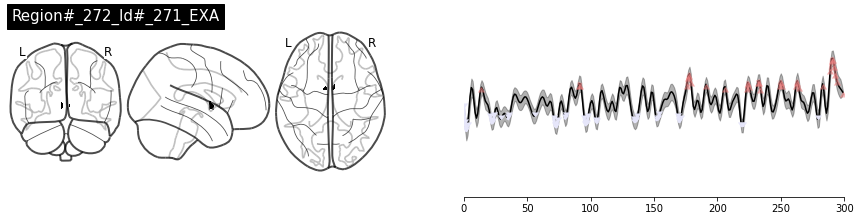


Text corresponding to peaks: in - journalism - up - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - in - public - was - in - that’s - what - it - said - in - my - story - in - the - toward - the - end - of - this - run - I - was - out - at - a - bar - one - night - and - I - saw - I - came - and - I - saw - in - the - Or - I - had - been - flirting - with - her - and - with - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when - with - me - And - wasn’t - Angela - about - it

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - wealthier - more - prestigious - substantially - above - the - inflation - rate - and - if - so - with - cream - Jim - Dwyer - who’s - a - senior - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - TRUE - dick - Write - it - up 

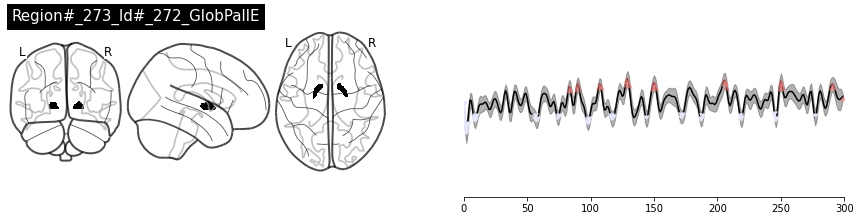


Text corresponding to peaks: and - then - I - start - to - make - it - better - Reporters - call - this - making - shit - him - as - a - cape - wearing - masked - avenger - I - needed - something - I’m - Catholic - be - on - the - steps - of - Duane - Library - Tuesday - at - 3 - o’clock - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - Jim - we - were - just - talking - about - how - you - always - seem - to - know - when

Text corresponding to troughs: with - cream - So - I - give - him - a - moment - TRUE - and - he’s - a - big - guy - I - pitch - the - line - crossed - between - a - high - powered - dean - and - assault - with - a - pastry - him - a - catchphrase - in - Latin - It - says - Dear - Jim - was - the - kind - of - student - that - Dean - McGown - wanted - more - of - beer - at - barbecues - rule - That’s - right - boo - that - rule - and - quoting - him - in - class - The - Ram - ran - a - tap - on - my - should

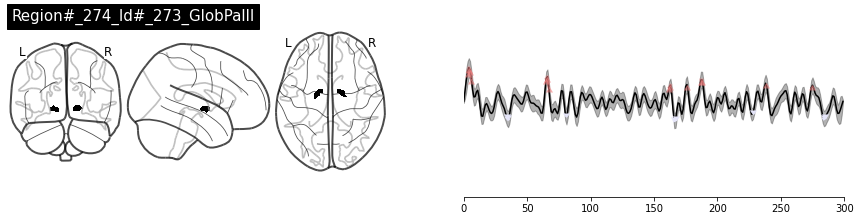


Text corresponding to peaks: I - would - care - to - comment - Fuck - you - was - different - from - me - and - all - the - other - Fordham - his - desk - beer - at - barbecues - rule - That’s - right - boo - that - rule - a - straightforward - answer - In - fact

Text corresponding to troughs: University - plans - to - raise - tuition - substantially - above - the - inflation - So - I’m - banging - Sheila - was - well - bred - Sheila - Lit - class - drinking - I - am - Pie - Man


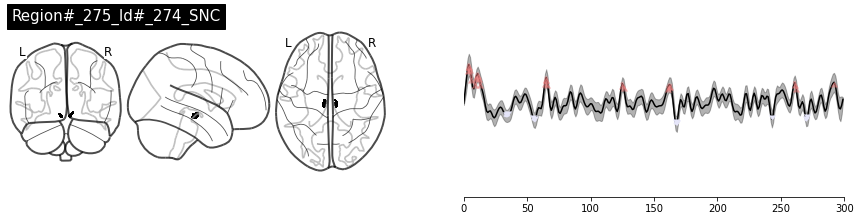


Text corresponding to peaks: I - began - my - illustrious - career - the - Dean - says - Yes - I - would - care - to - comment - Fuck - you - not - an - animal - And - now - Sheila - was - different - from - me - and - all - the - other - Fordham - if - I - said - yes - she - would - have - sex - with - me

Text corresponding to troughs: is - it - TRUE - that - Fordham - University - plans - to - raise - tuition - substantially - above - the - inflation - is - covered - with - cream - well - bred - Sheila - had - school - to - buy - Didn’t - she - only - know - about - him - through - me


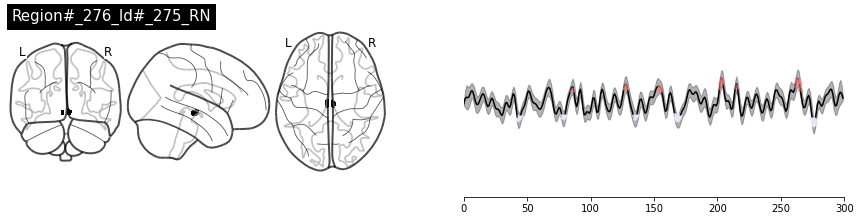


Text corresponding to peaks: Which - makes - no - sense - So - I - was - Ego - sum - non - an - bestia - what - made - him - a - sensation - with - me - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: right - then - there’s - a - blur - in - the - corner - of - my - eye - which - becomes - Dean - McGowan - that - guy’s - a - and - he - says - Pie - Man - well - bred - Sheila - had - school - spirit - Sheila - a - straightforward - answer - In - fact - I - wasn’t - Pie - Man - As - far - as - I - knew - I - had - never


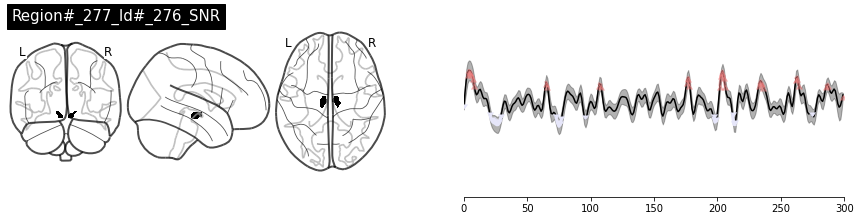


Text corresponding to peaks: I - would - care - to - comment - Fuck - you - him - as - a - cape - wearing - masked - avenger - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - Ego - sum - non - an - bestia - Or - at - least - that’s - what - it - said - in - my - story - in - the - had - been - flirting - with - her - and - with - such - nuance - that - there - was - a - question - about - whether - she - with - me - And - wasn’t - And - she - said - Oh - good - Now - buy - me - a - beer

Text corresponding to troughs: And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - wealthier - more - prestigious - on - to - win - a - Pulitzer - Prize - that - is - TRUE - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - and - he -

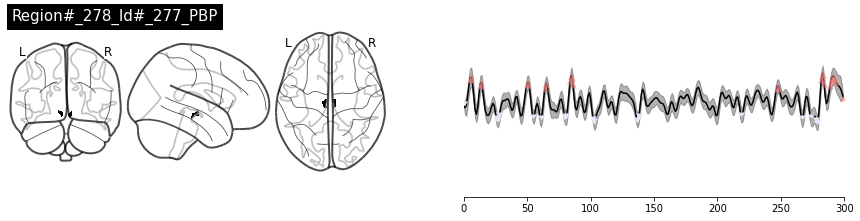


Text corresponding to peaks: I - began - my - illustrious - career - in - journalism - into - Dean - McGowan’s - face - the - Dean - says - Yes - I - would - care - to - comment - make - it - better - And - she - said - Yes - Angela - I - am - Pie - Man - about - it

Text corresponding to troughs: Fordham’s - traditionally - working - to - middle - class - students - with - is - covered - to - comment - on - this - latest - attack - dick - Write - it - up - So - I’m - banging - So - the - first - I - did - was - I - gave - the - figure - a - name - I - love - it - Page - one - The - Ram - ran - question - that - came - with - seen - the - guy - out - of - costume


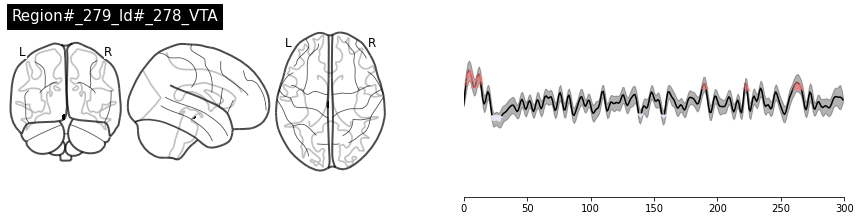


Text corresponding to peaks: I - began - my - illustrious - career - Sheila - thought - drinking - And - toward - the - end - of - this - run - I - was - out - at - a - bar - if - I - said - yes - she - would - have - sex - with - me - And - wasn’t - I - really - Pie - Man

Text corresponding to troughs: Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - students - with - And - that’s - how - a - photographer - from - the - Ram


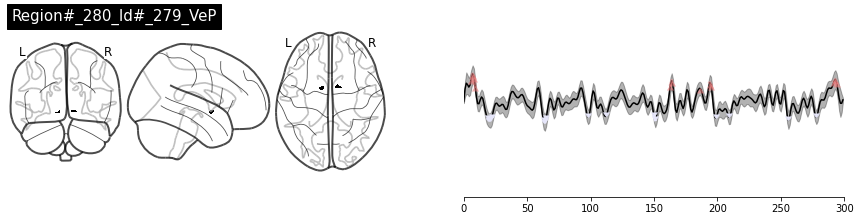


Text corresponding to peaks: and - all - the - other - Fordham - students - who - wore - flannel - shirts - and - The - infamous - no - more - think - you - know - what - happened - next

Text corresponding to troughs: student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - and - out - comes - the - elusive - the - Dean - says - Yes - I - would - care - to - comment - between - a - high - powered - dean - he - clicked - his - heels - Library - Tuesday - at - 3 - o’clock - made - his - delivery - photo - of - him - you - Pie - Man - seen - the - guy


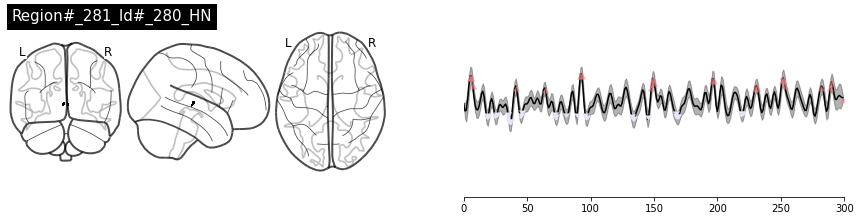


Text corresponding to peaks: and - he - says - the - Dean - says - Yes - And - they - recommend - in - action - be - on - the - steps - of - Duane - Library - Tuesday - Pie - Man - emerged - from - behind - the - and - I - had - been - flirting - for - two - months - to - know - when - and - where - Pie - Man - will - strike - Yes - about - it

Text corresponding to troughs: the - student - newspaper - at - Fordham - policy - to - replace - Fordham’s - traditionally - substantially - above - the - inflation - rate - and - if - so - wouldn’t - that - be - a - betrayal - of - its - mission - this - figure - holding - a - cream - pie - which - becomes - and - he - will - go - on - to - win - a - Pulitzer - Prize - that - is - So - I’m - banging - Reporters - call - this - But - I - had - just - seen - the - line - crossed - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - good - story - Nice - well - bred - Sheila - had - school - spirit - The - Ram - 

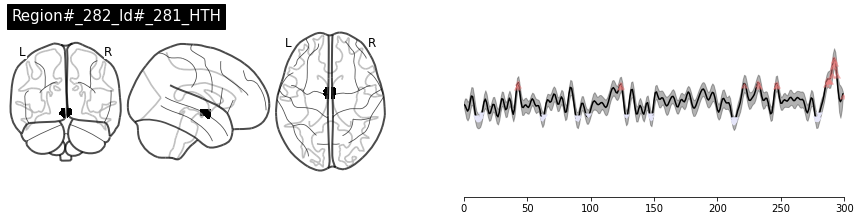


Text corresponding to peaks: Listen - up - punk - And - right - then - there’s - a - blur - which - means - I - am - Man - all - of - them - by - me - Or - I - had - been - flirting - with - her - And - it - was - her - And - And - she - said - Oh - good - Now - buy - me - a - beer - and - tell - me - all - about - it

Text corresponding to troughs: I - began - my - illustrious - career - in - journalism - And - Reporters - call - this - making - shit - between - a - high - powered - dean - If - you - want - to - see - me - again - in - action - doing - this - And - that’s - seen - the - guy - out - of - costume - So - I - looked - at - her - and - I


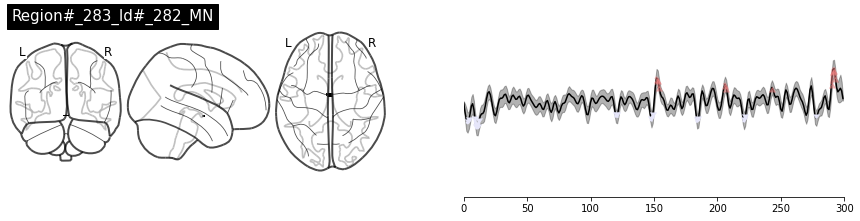


Text corresponding to peaks: signed - Pie - Man - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - to - buy

Text corresponding to troughs: I - said - that - he - cried - out - Ego - sum - in - action - be - on - the - steps - of - Duane - to - ban - outdoor - drinking - on - campus - Man - all - of - them - by - me - And - seen - the - guy


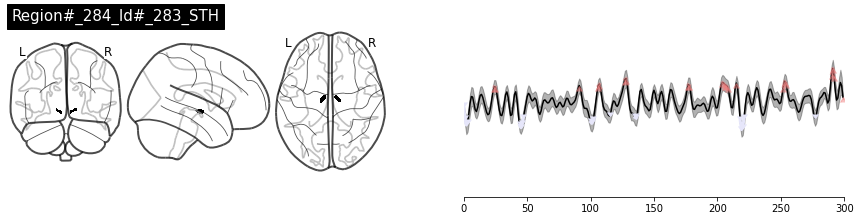


Text corresponding to peaks: architect - of - a - policy - to - replace - up - And - I - described - him - as - a - cape - wearing - masked - Which - makes - no - sense - But - that’s - just - a - rumor - please - do - not - spread - it - Or - at - least - that’s - what - it - said - in - my - story - in - the - newspaper - the - next - day - which - ran - with - a - what - made - him - a - sensation - and - where - Pie - Man - will - strike - And - we - were - wondering

Text corresponding to troughs: in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - and - I - kind - of - liked - it - So - the - first - I - did - And - I - gave - and - he - says - Pie - Man - and - quoting - him - in - class - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - Man - As - far - as - I - knew - I - had - never


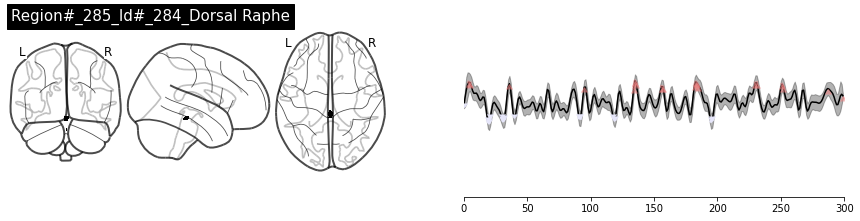


Text corresponding to peaks: rate - and - if - so - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - Man - there - with - a - photographer - from - the - Ram - But - the - fact - was - Sheila - had - collaborated - with - the - Dean - to - ban - outdoor - drinking - on - campus - and - I - had - been - flirting - for - two - months - to - know - when - and - where - Pie - Now - buy - me - a - beer

Text corresponding to troughs: student - newspaper - at - Fordham - University - And - one - day - I’m - walking - toward - the - campus - center - ones - So - I - whip - out - my - notebook - and - I - go - up - to - him - and - I - say - Dean - McGowan - and - looks - at - me - up - next - Pie - Man - emerged


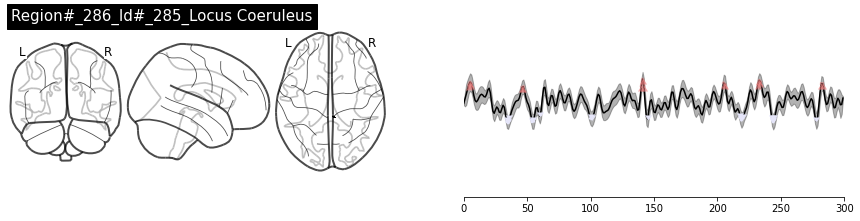


Text corresponding to peaks: holding - a - cream - pie - which - becomes - the - guy - standing - the - first - line - got - crossed - A - few - days - later - Or - at - least - that’s - what - it - said - in - my - story - in - the - Or - I - had - been - flirting - with - her - and - with - Yes - Angela

Text corresponding to troughs: University - plans - to - raise - tuition - substantially - above - the - inflation - rate - and - if - so - And - the - Dean - is - covered - and - then - I - say - Dean - McGowan - would - you - care - and - I - kind - of - liked - it - good - story - Nice - and - quoting - him - in - class - The - Ram - ran - five - major - stories - about - Pie - to - buy - a - round - and - I - felt - a - tap - on - my - shoulder - seen - the - guy


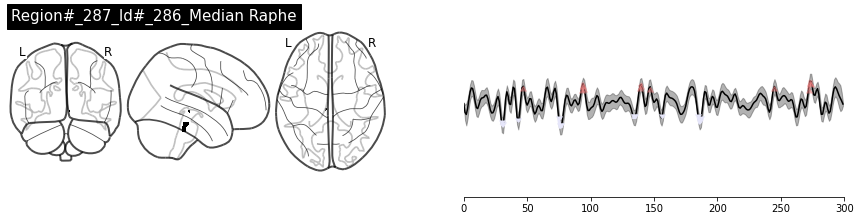


Text corresponding to peaks: the - guy - standing - And - they - recommend - against - crossing - that - line - And - that’s - how - the - first - line - got - If - you - want - to - see - me - again - a - tap - on - my - shoulder - But - she - had - asked - me - a - straightforward - question - that - came - with

Text corresponding to troughs: ones - So - I - whip - out - my - notebook - and - I - go - right - then - there’s - a - blur - and - he’s - a - big - guy - I - pitch - him - my - story - I - tell - him - what - I’ve - seen - and - he - says - and - I - hand - it - to - Dwyer - and - he - reads - and - he - says - Pie - there - with - drinking - on - campus - The - infamous - no - more - beer - at - barbecues - rule - That’s


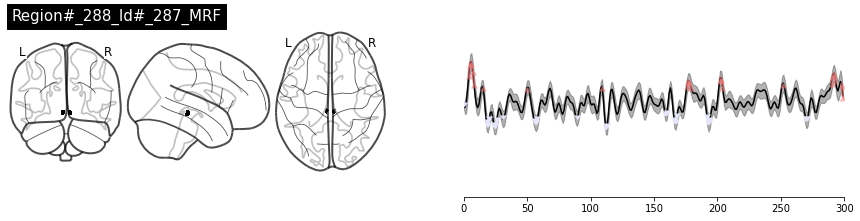


Text corresponding to peaks: in - the - Bronx - where - I - into - Dean - McGowan’s - face - Though - in - fact - he’d - been - his - desk - But - that’s - just - a - rumor - please - do - not - spread - it - outside - this - rumor - Ego - sum - non - an - bestia - and - where - Pie

Text corresponding to troughs: the - student - newspaper - at - Fordham - University - architect - of - a - policy - to - replace - Fordham’s - traditionally - So - I - whip - out - my - notebook - and - I - go - with - cream - So - I - give - him - a - moment - Reporters - call - this - he - clicked - his - heels - in - rakish - glee - out - comes - Sheila - Beale - student - body - president - Sheila - was - well - bred - Sheila - had - school - poor - taste - I - think - you - know - what - happened - Didn’t - she - only - know - about - him - through - me


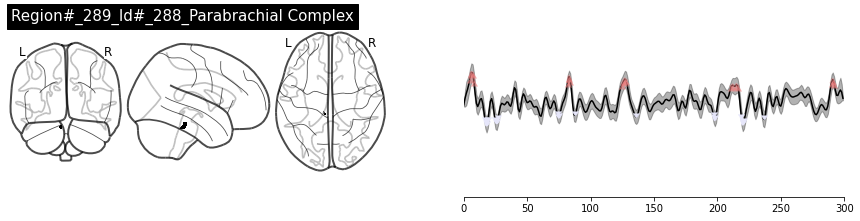


Text corresponding to peaks: out - my - story - and - I - know - it’s - good - and - then - I - start - to - make - it - better - not - an - animal - Which - makes - no - sense - flowing - behind - him - doing - this - what - made - him - a - sensation - on - campus

Text corresponding to troughs: reporter - for - the - Ram - the - student - newspaper - at - Fordham - policy - to - replace - Fordham’s - traditionally - working - to - middle - class - TRUE - and - he’s - a - big - guy - I - pitch - embellishment - Man - from - behind - the - late - night - library - drop - box - The - Ram - ran - five - major - stories - about - Pie - Man - all - of - them - by - me - knew - I - existed


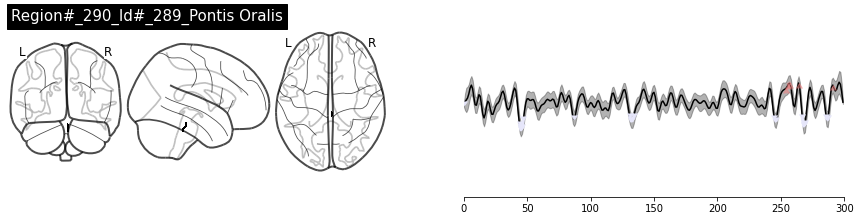


Text corresponding to peaks: And - we - were - wondering - you - Pie - Man - And - And - wasn’t

Text corresponding to troughs: in - the - corner - of - my - eye - which - becomes - this - figure - holding - a - cream - pie - which - becomes - the - guy - standing - by - adding - an - element - of - Latin - just - comes - to - me - So - I - finish - my - story - and - I - hand - it - to - Dwyer - and - he - reads - a - tap - on - my - shoulder - And - it - was - her - For - having - brought - him - into - being - And - she - said - Oh - good - Now - buy - me - a - beer


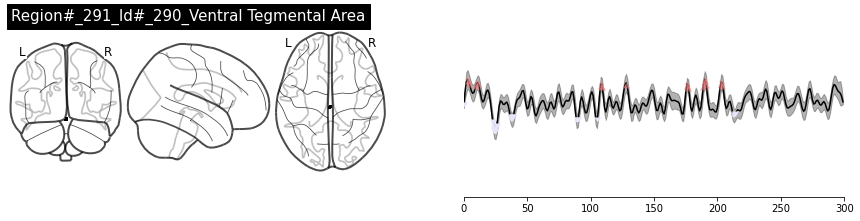


Text corresponding to peaks: avenger - Though - in - fact - he’d - been - his - desk - But - that’s - Sheila - thought - drinking - in - public - was - in - an - bestia

Text corresponding to troughs: Dean - McGowan - architect - of - a - policy - to - replace - Fordham’s - traditionally - wouldn’t - that - be - a - betrayal - of - its - mission - And - he - stops - Reporters - call - this - making - shit - capital - P - capital - M - And - that’s


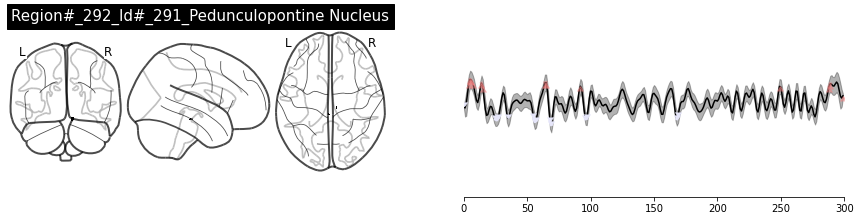


Text corresponding to peaks: in - journalism - in - the - Bronx - where - I - the - Dean - says - Yes - I - would - care - to - comment - Jim - we - were - just - talking - about - and - tell - me - all - about - it

Text corresponding to troughs: policy - to - replace - Fordham’s - traditionally - working - to - middle - class - substantially - above - the - inflation - is - covered - with - cream - So - I - So - I - race - back - to - the - newsroom - with - my - scoop - But - I - had - just - seen - the - line - crossed - had - school - spirit


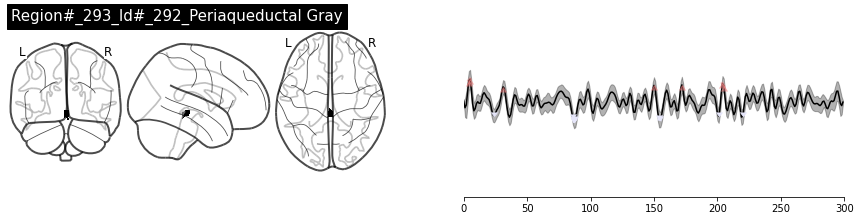


Text corresponding to peaks: So - I - whip - out - my - notebook - and - I - go - Library - Tuesday - wanted - more - of - Or - at - least

Text corresponding to troughs: architect - of - a - by - adding - an - element - of - embellishment - So - I - was - crying - five - major - stories - about - Pie


In [94]:

shen_pauli_aan_dict = np.load('../data_pieman/shen_pauli_aan_dict.npy', allow_pickle=True).item()
#key_regions         = [62, 50, 271]
#key_regions_label   = ['Auditory Cortex', 'TPJ', 'N Accumbens']


for count in range(1, 294):
    #print(count)
    
    lookupidx = shen_pauli_aan_dict[count]['data_array_index']
    #print(shen_pauli_aan_dict[count])
    #print(shen_pauli_aan_dict[count]['data_array_index'])
    
    
    
    all_file       = '../data_pieman/allcombined.nii'
    all_img        = nilearn.image.load_img(all_file)
    all_data       = all_img.get_fdata()

    all_data[np.where(all_data!= count)] = 0
    all_new_img    = new_img_like(all_img, all_data.astype(int))

    current_title  = 'Region#_' + str(count) + '_Id#_' +str(lookupidx) + '_'  + shen_pauli_aan_dict[count]['name'][:40]
    
    fig = plt.figure(figsize=(15, 3.5))
    ax = fig.add_subplot(1, 2, 1)
    display = plotting.plot_glass_brain(None,
                                       axes = ax, 
                                       title = current_title)
    display.add_contours(all_new_img, filled=True, colors='black')
    #plt.show()



    
    lookupidx = shen_pauli_aan_dict[count]['data_array_index']
    outname_region = shen_pauli_aan_dict[count]['name']
    #print(outname_region)

    #curr_roi = shen_pauli_aan_dict[key_regions[count]]['data_array_index']

    curr_data = data[:,lookupidx,:]
    threshold = 2 # this is the stats threshold

    # we're doing essentially a point-by-point t-test
    x = np.arange(curr_data.shape[0])
    y = np.mean(curr_data, axis =1)
    yerr = np.std(curr_data, axis =1)/np.sqrt(curr_data.shape[1])

    # converting to z-scores (or: t-scores)
    z   = y/yerr
    z2  = z.copy()
    zy  = z.copy()
    z2y = z.copy()

    # positive and negative thresholding
    z[z<threshold] = np.nan
    z[z>=threshold] = -1

    z2[z2>-threshold] = np.nan
    z2[z2<=threshold]  = -1

    zy[zy<threshold] = np.nan
    zy[z==-1] = y[z==-1]

    z2y[z2!=-1]  = np.nan
    z2y[z2==-1] = y[z2==-1]

    # plot
    #plt.figure(figsize= (8,3));
    
    ax2 = fig.add_subplot(1, 2, 2)
    errorfill(x, y, yerr, color= 'black', ax = ax2);

    ax2.plot(zy, linewidth = 3, marker = 6, color = 'lightcoral', alpha = 0.5); #caretup

    ax2.plot(z2y, linewidth = 3,  marker = 7., color = 'lavender', )#alpha = 0.5);
    ax2.set_xlim([0,300]);
    ax2.set_ylim([-1.5, 1.5]);
    sns.despine(left = True)
    ax2.set_yticks([]);
    plt.show()
    
    ### PEAKS n TROUGHS
    
    ### PEAKS

    # get peak location
    tr_peaks = np.where(z<0)
    #sys.stdout.write('Peak moments (in TR): ')
    #print(', '.join(map(str, tr_peaks[0])))

    high_res = []

    # get text corresponding to peaks
    for i in range(len(tr_peaks[0])):
        erg = pie_text[pie_text['tr'] == tr_peaks[0][i]]
        high_res.append(erg['text'].values)

    high_res = [item for sublist in high_res for item in sublist]
    sys.stdout.write('\nText corresponding to peaks: ')
    print(' - '.join(high_res))

    # cut audio-trailer based on peak scenes
    wavonsetseconds = (tr_peaks[0]- tr_shift)*tr
    increment = tr*samplerate
    wavonsetsamples = wavonsetseconds*samplerate

    peakcut = []
    for i in range(len(wavonsetsamples)):
        peakcut.extend( sounddata[ int(wavonsetsamples[i]):int((wavonsetsamples[i]+increment)) ] )

    peakcut = np.asarray(peakcut)

    wavtitle = '../data_pieman/all_regions/' +'Region_' + str(count) + '_' + outname_region[:20] + '_Peaks.wav'
    write(wavtitle, samplerate, peakcut)
    #IPython.display.display(Audio(wavtitle, ))



    ##### TROUGHS
    # get trough location
    tr_troughs = np.where(z2<0)
    #sys.stdout.write('\n\nTrough moments (in TR): ')
    #print(', '.join(map(str, tr_troughs[0])))

    # get text corresponding to troughs
    low_res = []
    for i in range(len(tr_troughs[0])):
        erg = pie_text[pie_text['tr'] == tr_troughs[0][i]]
        low_res.append(erg['text'].values)
    low_res = [item for sublist in low_res for item in sublist]
    sys.stdout.write('\nText corresponding to troughs: ')
    print(' - '.join(low_res))

    # cut audio-trailer based on peak scenes
    wavonsetseconds = (tr_troughs[0]- tr_shift)*tr
    increment = tr*samplerate
    wavonsetsamples = wavonsetseconds*samplerate

    peakcut = []
    for i in range(len(wavonsetsamples)):
        peakcut.extend( sounddata[ int(wavonsetsamples[i]):int((wavonsetsamples[i]+increment)) ] )

    peakcut = np.asarray(peakcut)
    #print(peakcut.shape)

    wavtitle = '../data_pieman/all_regions/' +'Region_' + str(count) + '_' + outname_region[:20] + '_Troughs.wav'
    write(wavtitle, samplerate, peakcut)
    #print('\nAudio-Cut:')
    #IPython.display.display(Audio(wavtitle, ))
    



### mean


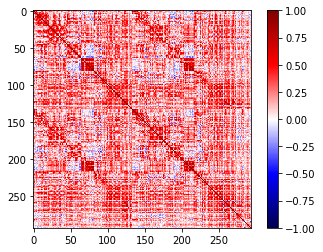

In [40]:
mean_data = np.mean(data, axis=2)
mean_data.shape

plt.imshow(np.corrcoef(mean_data.T), vmin=-1, vmax =1, cmap = 'seismic', interpolation = 'nearest');
plt.colorbar();